In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas
import os
import pingouin
import datapungibea as dpb
from matplotlib.patches import ArrowStyle
import copy
from matplotlib.backends.backend_pdf import PdfPages
import networkx as nx
from pgmpy.estimators import PC
import statsmodels.api as sm
import plotly.express as px
from sklearn.linear_model import LinearRegression
import seaborn as sns
import random
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.metrics import mean_squared_error, accuracy_score
from statsmodels.discrete.discrete_model import Logit
from networkx.drawing.nx_agraph import graphviz_layout
from collections import defaultdict
import math

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.3, the latest is 0.5.4.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


In [2]:
# Create a function far plotting geographic map of US
def import_geo_data(filename, index_col = "Date", FIPS_name = "FIPS"):
    # import county level shapefile
    map_data = geopandas.read_file(filename = filename,                                   
                                   index_col = index_col)
    # rename fips code to match variable name in COVID-19 data
    map_data.rename(columns={"State":"state"},
                    inplace = True)
    # Combine statefips and county fips to create a single fips value
    # that identifies each particular county without referencing the 
    # state separately
    map_data[FIPS_name] = map_data["STATEFP"].astype(str) + \
        map_data["COUNTYFP"].astype(str)
    map_data[FIPS_name] = map_data[FIPS_name].astype(np.int64)
    # set FIPS as index
    map_data.set_index(FIPS_name, inplace=True)
    
    return map_data
fips_name = "fips_code"
map_data = import_geo_data(
    filename = "countiesWithStatesAndPopulation.shp",
    index_col = "Date", FIPS_name= fips_name)
#map_data

In [3]:
rates_data = pd.read_csv('rates_data.csv')

In [4]:
rates_data1 = rates_data.drop(['M4', 'M4 I'], axis=1) 

In [5]:
rates_data = rates_data.set_index(['FIPS_y', 'TimePeriod'])

In [6]:
rates_data1 = rates_data1.set_index(['FIPS_y', 'TimePeriod'])

In [7]:
dfg_cl = rates_data.copy()

In [8]:
dfg_cl2 = rates_data1.copy()

In [9]:
data1 = pd.read_csv('kml3d_no_m4_diff.csv')

data2 = pd.read_csv('kml3d_cluster_diff_data.csv')

In [10]:
rates_data2 = rates_data.drop(['M4', 'M4 I', 'Neig'], axis=1) 

In [11]:
rates_data3 = rates_data.drop(['Neig'], axis=1) 

In [12]:
dfg_cl3 = rates_data2.copy()

In [13]:
dfg_cl4 = rates_data3.copy()

In [14]:
data_nom4 = pd.read_csv('kml3d_no_m4_rates.csv')

data_noneig = pd.read_csv('kml3d_no_neigh_rates.csv')

data_no_m4_neigh = pd.read_csv('kml3d_no_neigh_m4_rates.csv')

In [15]:
level3 = data_nom4

In [16]:
level4 = data_noneig

In [17]:
level5 = data_no_m4_neigh

In [18]:
level = data1

In [19]:
level2 = data2

In [20]:
merged_df_nom4 = pd.merge(dfg_cl2, level3[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [21]:
merged_df_nom4nei = pd.merge(dfg_cl3, level5[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [22]:
merged_df_nonei = pd.merge(dfg_cl4, level4[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [23]:
kml3d_cl_level3 = merged_df_nom4.dropna()

In [24]:
kml3d_cl_level4 = merged_df_nom4nei.dropna()

In [25]:
kml3d_cl_level5 = merged_df_nonei.dropna()

In [26]:
kml3d_cl_level3 = kml3d_cl_level3.set_index(['FIPS_y'])

In [27]:
kml3d_cl_level4 = kml3d_cl_level4.set_index(['FIPS_y'])

In [28]:
kml3d_cl_level5 = kml3d_cl_level5.set_index(['FIPS_y'])

In [29]:
cluster_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4}

In [30]:
kml3d_cl_level3['clusters'].replace(cluster_mapping, inplace=True)

In [31]:
kml3d_cl_level4['clusters'].replace(cluster_mapping, inplace=True)

In [32]:
kml3d_cl_level5['clusters'].replace(cluster_mapping, inplace=True)

In [33]:
merged_df = pd.merge(dfg_cl, level[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [34]:
merged_df2 = pd.merge(dfg_cl2, level2[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [35]:
kml3d_cl_level = merged_df.dropna()

kml3d_cl_level2 = merged_df2.dropna()

In [36]:
kml3d_cl_level = kml3d_cl_level.set_index(['FIPS_y'])

In [37]:
kml3d_cl_level2 = kml3d_cl_level2.set_index(['FIPS_y'])

In [38]:
cluster_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4}

In [39]:
kml3d_cl_level['clusters'] = kml3d_cl_level['clusters'].map(cluster_mapping)

In [40]:
kml3d_cl_level2['clusters'] = kml3d_cl_level2['clusters'].map(cluster_mapping)

In [41]:
# kml3d_cl_level3['clusters'] = kml3d_cl_level3['clusters'].map(cluster_mapping)

In [42]:
kml3d_cl_level

,Agri,All,Mini,Util,Neig,M4,M4 I,clusters
FIPS_y,,,,,,,,
1001.0,10.019269,13.764007,8.443331,10.048497,16.547168,6.736434,-4.397289,2
1001.0,9.801621,13.799421,8.023880,10.884067,16.562177,6.792146,-4.904205,2
1001.0,10.595159,13.823510,8.215006,10.952139,16.590304,6.840895,-4.716596,2
1001.0,10.817836,13.972752,8.685585,11.457180,16.646015,6.895184,-3.868532,2
1001.0,10.986969,13.993924,8.924390,11.217587,16.688909,6.951425,-3.430044,2
...,...,...,...,...,...,...,...,...
56045.0,9.537556,12.629528,10.467238,6.635947,16.472590,7.294414,-5.774800,1
56045.0,9.898525,12.614563,10.457717,6.609349,16.441328,7.337503,-4.985560,1
56045.0,10.076894,12.661381,10.664387,6.674561,16.444573,7.390222,-4.775628,1


In [43]:
kml3d_cl_level2

,Agri,All,Mini,Util,Neig,clusters
FIPS_y,,,,,,
1001.0,10.019269,13.764007,8.443331,10.048497,16.547168,1
1001.0,9.801621,13.799421,8.023880,10.884067,16.562177,1
1001.0,10.595159,13.823510,8.215006,10.952139,16.590304,1
1001.0,10.817836,13.972752,8.685585,11.457180,16.646015,1
1001.0,10.986969,13.993924,8.924390,11.217587,16.688909,1
...,...,...,...,...,...,...
56045.0,9.537556,12.629528,10.467238,6.635947,16.472590,1
56045.0,9.898525,12.614563,10.457717,6.609349,16.441328,1
56045.0,10.076894,12.661381,10.664387,6.674561,16.444573,1


In [44]:
df1 = kml3d_cl_level.reset_index()

In [45]:
df2 = kml3d_cl_level2.reset_index()

In [46]:
# Define the clusters you want to analyze
clusters_to_analyze = [1, 2, 3, 4]

# Loop through each cluster
for cluster in clusters_to_analyze:
    # Filter df1 for the current cluster
    current_cluster_df1 = df1[df1['clusters'] == cluster]

    # Print the number of unique counties in the current cluster for df1
    print(f"Number of unique counties in Cluster {cluster} in df1: {current_cluster_df1['FIPS_y'].nunique()}")


# Loop through each cluster
for cluster in clusters_to_analyze:
    # Filter df2 for the current cluster
    current_cluster_df2 = df2[df2['clusters'] == cluster]

    # Print the number of unique counties in the current cluster for df2
    print(f"Number of unique counties in Cluster {cluster} in df2: {current_cluster_df2['FIPS_y'].nunique()}")


Number of unique counties in Cluster 1 in df1: 1368
Number of unique counties in Cluster 2 in df1: 672
Number of unique counties in Cluster 3 in df1: 392
Number of unique counties in Cluster 4 in df1: 54
Number of unique counties in Cluster 1 in df2: 1543
Number of unique counties in Cluster 2 in df2: 472
Number of unique counties in Cluster 3 in df2: 374
Number of unique counties in Cluster 4 in df2: 97


In [47]:
# Define the clusters you want to analyze
clusters_to_analyze_df1 = [1, 2, 3, 4]

# Loop through each cluster in df1
for cluster_df1 in clusters_to_analyze_df1:
    # Filter df1 for the current cluster
    current_cluster_df1 = df1[df1['clusters'] == cluster_df1]

    # Print the number of unique counties in the current cluster for df1
    print(f"Number of unique counties in Cluster {cluster_df1} in df1: {current_cluster_df1['FIPS_y'].nunique()}")

    # Initialize variables to track the most similar cluster in df2
    most_similar_cluster_df2 = None
    min_county_difference = float('inf')

    # Loop through each cluster in df2
    for cluster_df2 in df2['clusters']:
        # Filter df2 for the current cluster
        current_cluster_df2 = df2[df2['clusters'] == cluster_df2]
        
        # Calculate the absolute difference in the number of unique counties
        county_difference = abs(current_cluster_df1['FIPS_y'].nunique() - current_cluster_df2['FIPS_y'].nunique())

        # Update the most similar cluster if the current one is closer
        if county_difference < min_county_difference:
            min_county_difference = county_difference
            most_similar_cluster_df2 = cluster_df2

    # Print the result for the current cluster in df1
    print(f"Cluster {cluster_df1} in df1 is most similar to Cluster {most_similar_cluster_df2} in df2")
  


Number of unique counties in Cluster 1 in df1: 1368
Cluster 1 in df1 is most similar to Cluster 1 in df2
Number of unique counties in Cluster 2 in df1: 672
Cluster 2 in df1 is most similar to Cluster 2 in df2
Number of unique counties in Cluster 3 in df1: 392
Cluster 3 in df1 is most similar to Cluster 3 in df2
Number of unique counties in Cluster 4 in df1: 54
Cluster 4 in df1 is most similar to Cluster 4 in df2


In [48]:
# # Define the clusters you want to analyze
# clusters_to_analyze = [1, 2, 3, 4]

# # Loop through each cluster for df1
# for cluster_df1 in clusters_to_analyze:
#     # Filter df1 for the current cluster
#     current_cluster_df1 = df1[df1['clusters'] == cluster_df1]

#     # Print the number of unique counties in the current cluster for df1
#     print(f"Number of unique counties in Cluster {cluster_df1} in df1: {current_cluster_df1['FIPS_y'].nunique()}")


# # Loop through each cluster for df2
# for cluster_df2 in clusters_to_analyze:
#     # Filter df2 for the current cluster
#     current_cluster_df2 = df2[df2['clusters'] == cluster_df2]

#     # Print the number of unique counties in the current cluster for df2
#     print(f"Number of unique counties in Cluster {cluster_df2} in df2: {current_cluster_df2['FIPS_y'].nunique()}")


In [49]:
dfg_dag = df1

In [50]:
grouped = dfg_dag.groupby('clusters')

# Initialize an empty dictionary to store the DataFrames for each cluster
cluster_dataframes = {}

# Iterate over the groups and create DataFrames
for cluster, group in grouped:
    cluster_dataframes[cluster] = group

In [51]:
#Cluster dataframes
c1_df = cluster_dataframes[1]
c2_df = cluster_dataframes[2]
c3_df = cluster_dataframes[3]
c4_df = cluster_dataframes[4]

In [52]:
c1_df = c1_df.set_index(['FIPS_y'])
c2_df = c2_df.set_index(['FIPS_y'])
c3_df = c3_df.set_index(['FIPS_y'])
c4_df = c4_df.set_index(['FIPS_y'])

  0%|          | 0/6 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


keep control: All 
('Mini', 'Agri') ['All ']
keep control: M4 I
keep control: Agri
('Mini', 'clusters') ['M4 I', 'Agri']
keep control: clusters
('Mini', 'Neig') ['clusters']
keep control: Neig
('Mini', 'All ') ['Neig']
keep control: M4 I
keep control: Mini
('Agri', 'clusters') ['M4 I', 'Mini']
keep control: All 
('M4', 'Util') ['All ']
keep control: Mini
('clusters', 'Neig') ['Mini']
('clusters', 'M4') []
keep control: Mini
('Neig', 'All ') ['Mini']
keep control: M4
('All ', 'Util') ['M4']
keep control: Mini
('All ', 'Agri') ['Mini']
keep control: Mini
keep control: Agri
('M4 I', 'clusters') ['Mini', 'Agri']


/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-package

  0%|          | 0/6 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


('clusters', 'Neig') []
('Neig', 'All ') []
keep control: Agri
('All ', 'Mini') ['Agri']
keep control: M4 I
('M4', 'clusters') ['M4 I']
keep control: M4
('M4 I', 'clusters') ['M4']
('M4 I', 'M4') []
keep control: All 
('Agri', 'Mini') ['All ']


/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix


  0%|          | 0/6 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


keep control: M4 I
('clusters', 'M4') ['M4 I']
keep control: Neig
('M4 I', 'clusters') ['Neig']
keep control: clusters
('M4 I', 'M4') ['clusters']
keep control: M4 I
('Neig', 'clusters') ['M4 I']
('All ', 'Neig') []
('Util', 'All ') []


/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-package

  0%|          | 0/6 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


keep control: Mini
('Neig', 'All ') ['Mini']
keep control: Agri
('Neig', 'clusters') ['Agri']
('All ', 'M4') []
('All ', 'Util') []
keep control: Neig
('Agri', 'clusters') ['Neig']
keep control: Neig
('Mini', 'All ') ['Neig']
('Mini', 'M4 I') []


/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix


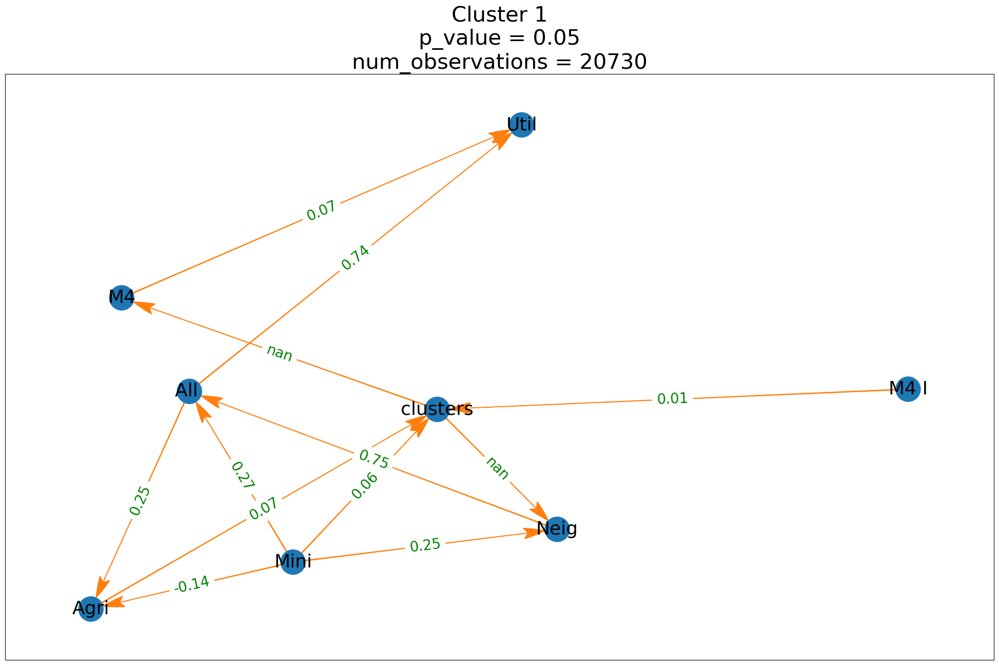

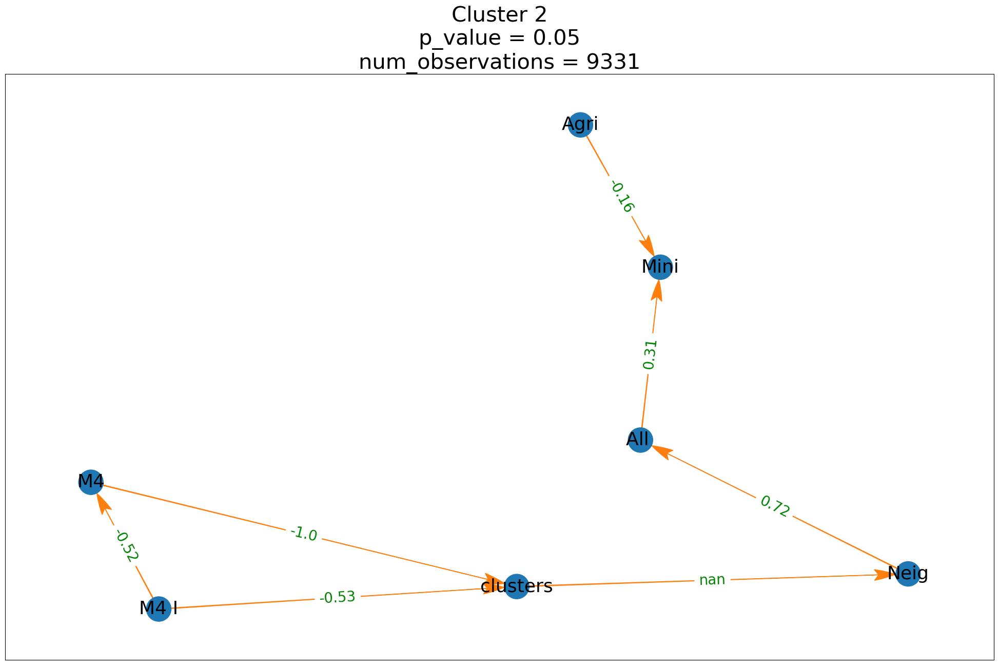

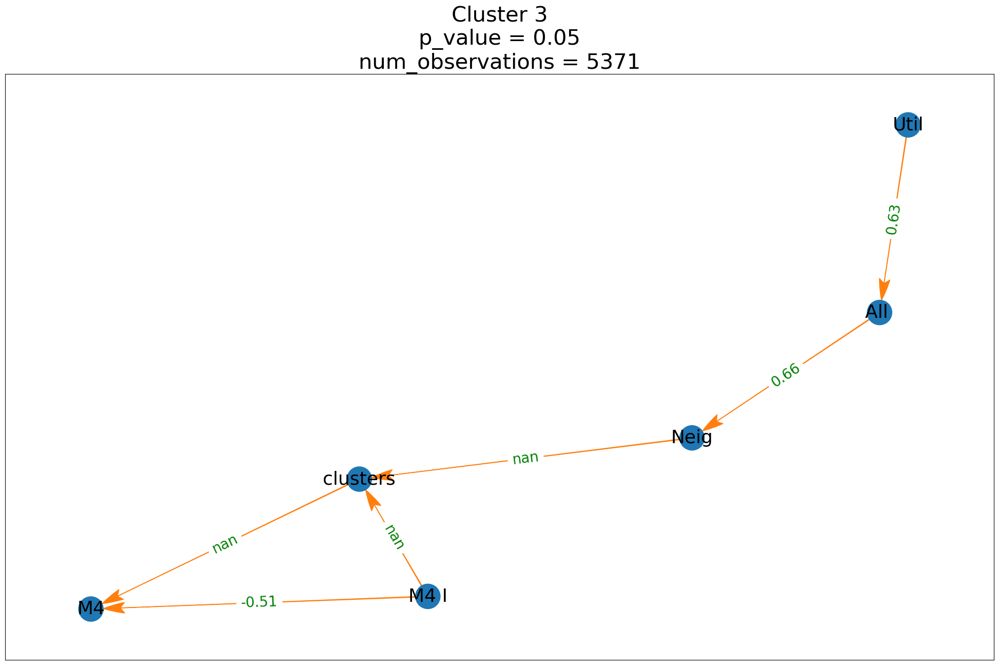

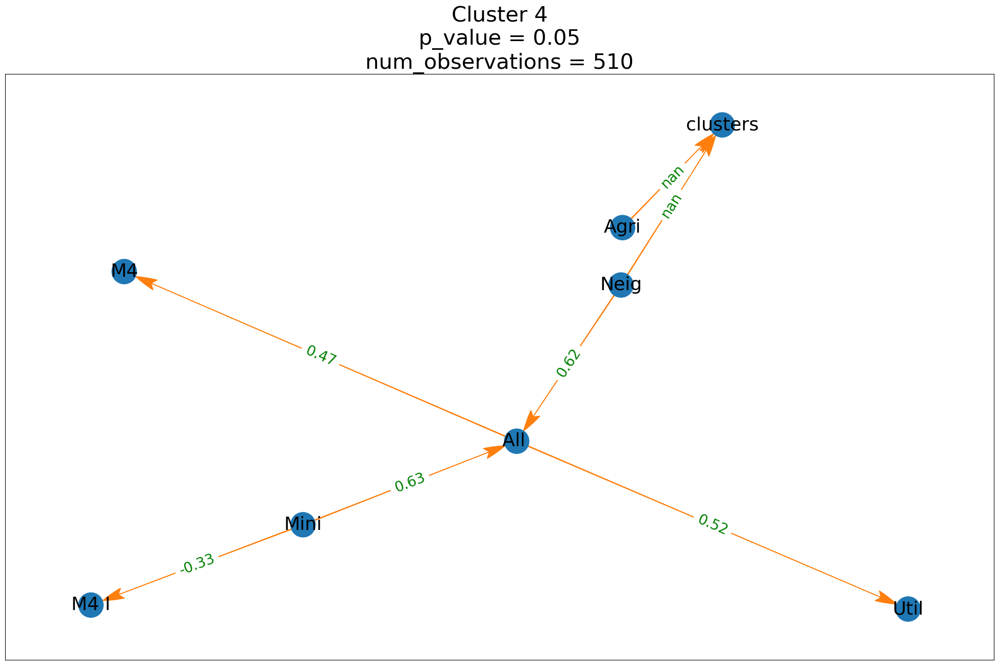

In [53]:
# List of DataFrames
cluster_dataframes = [c1_df, c2_df, c3_df, c4_df]

p_value = 0.05
max_cond_vars = len(c1_df.columns) - 2  # Assuming all DataFrames have the same columns

pp = PdfPages("DAGOutputs_withm4m4I.pdf")


def graph_DAG(edges, df, title="Directed Acyclic Graph"):
    graph = nx.DiGraph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.columns if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]] + keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]], 2))
    graph.add_edges_from(edges)
    color_map = ['C0' for g in graph]

    fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = nx.spring_layout(graph)
    
    plt.title(title, fontsize=30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                     arrows=True, font_color='k', font_size=26, alpha=1, width=1,
                     edge_color='C1',
                     arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax=ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)
    pp.savefig(fig, bbox_inches="tight")

for idx, c_df in enumerate(cluster_dataframes):
    c = PC(c_df)
    n = c_df.shape[0]
    model = c.estimate(return_type='pdag', variant='parallel', significance_level= p_value, max_cond_vars=max_cond_vars, ci_test='pearsonr')
    edges = model.edges

    # Call the graph_DAG function for each cluster DataFrame
    #graph_DAG(edges, c_df, title=f'Cluster {idx + 1} Directed Acyclic Graph')
    graph_DAG(edges, c_df, title=f'Cluster {idx + 1}\np_value = {p_value}\nnum_observations = {n}' )

pp.close()


In [54]:
dfg_dag2 = df2

In [55]:
grouped = dfg_dag2.groupby('clusters')

# Initialize an empty dictionary to store the DataFrames for each cluster
cluster_dataframes = {}

# Iterate over the groups and create DataFrames
for cluster, group in grouped:
    cluster_dataframes[cluster] = group

In [56]:
#Cluster dataframes
c1_df2 = cluster_dataframes[1]
c2_df2 = cluster_dataframes[2]
c3_df2 = cluster_dataframes[3]
c4_df2 = cluster_dataframes[4]

In [57]:
c1_df2 = c1_df2.set_index(['FIPS_y'])
c2_df2 = c2_df2.set_index(['FIPS_y'])
c3_df2 = c3_df2.set_index(['FIPS_y'])
c4_df2 = c4_df2.set_index(['FIPS_y'])

  0%|          | 0/4 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


keep control: All 
keep control: Mini
keep control: Neig
keep control: Agri
('Util', 'clusters') ['All ', 'Mini', 'Neig', 'Agri']
keep control: Mini
keep control: clusters
keep control: Neig
keep control: Agri
('Util', 'All ') ['Mini', 'clusters', 'Neig', 'Agri']
keep control: All 
('clusters', 'Neig') ['All ']
keep control: All 
('clusters', 'Util') ['All ']
keep control: Util
keep control: Mini
keep control: Neig
keep control: Agri
('clusters', 'All ') ['Util', 'Mini', 'Neig', 'Agri']
keep control: All 
('clusters', 'Agri') ['All ']
keep control: All 
('clusters', 'Mini') ['All ']
keep control: Util
keep control: Mini
keep control: Neig
keep control: Agri
('All ', 'clusters') ['Util', 'Mini', 'Neig', 'Agri']
keep control: clusters
('All ', 'Mini') ['clusters']
keep control: clusters
('All ', 'Neig') ['clusters']
keep control: clusters
('All ', 'Util') ['clusters']
keep control: clusters
('All ', 'Agri') ['clusters']
keep control: Util
keep control: Mini
keep control: clusters
keep co

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-package

  0%|          | 0/4 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


keep control: Neig
('Util', 'clusters') ['Neig']
('Util', 'All ') []
keep control: All 
('Agri', 'Neig') ['All ']
('Neig', 'Mini') []
keep control: Util
('Neig', 'clusters') ['Util']
keep control: Agri
('All ', 'Neig') ['Agri']
('All ', 'Util') []


/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix


  0%|          | 0/4 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


('Neig', 'All ') []
keep control: Mini
('Neig', 'clusters') ['Mini']
keep control: Agri
('All ', 'Mini') ['Agri']
('All ', 'Util') []
keep control: clusters
('All ', 'Agri') ['clusters']
keep control: Neig
('Mini', 'clusters') ['Neig']
keep control: Util
('Mini', 'Neig') ['Util']
keep control: All 
('clusters', 'Agri') ['All ']
keep control: Mini
('Util', 'Neig') ['Mini']
keep control: All 
('Agri', 'Mini') ['All ']


/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:955: RuntimeWarning: invalid value encountered in matmul
  pcor = -1 * (D @ Vi @ D)  # Partial correlation matrix
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pingouin/correlation.py:954: RuntimeWarning: divide by zero encountered in divide
  D = np.diag(np.sqrt(1 / np.diag(Vi)))
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-package

  0%|          | 0/4 [00:00<?, ?it/s]

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


keep control: Agri
('Neig', 'clusters') ['Agri']
keep control: All 
('Agri', 'Neig') ['All ']
keep control: Neig
('Agri', 'clusters') ['Neig']
keep control: Agri
('All ', 'Neig') ['Agri']


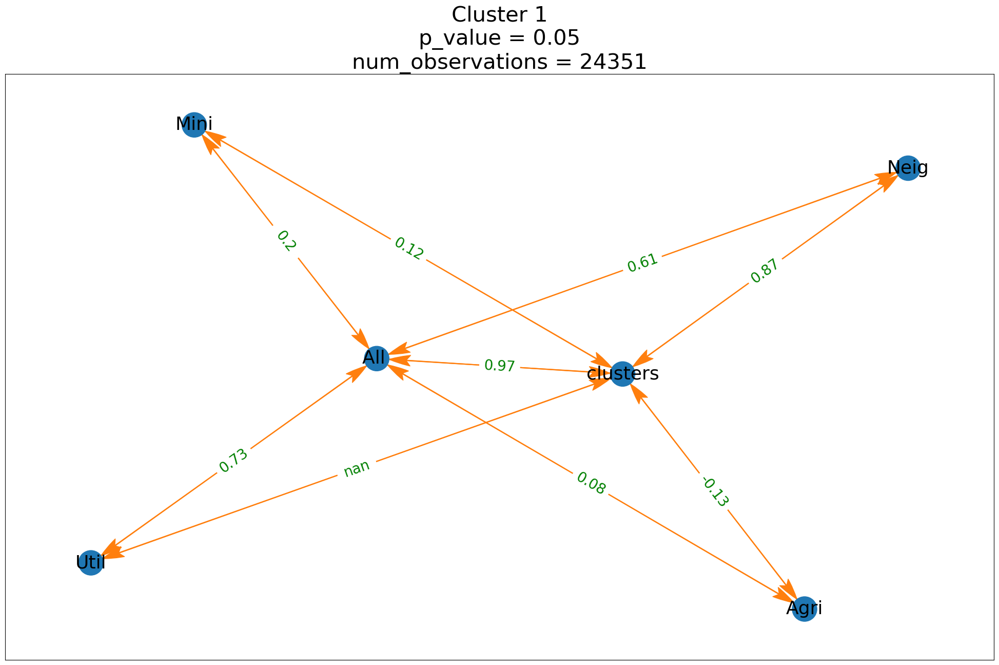

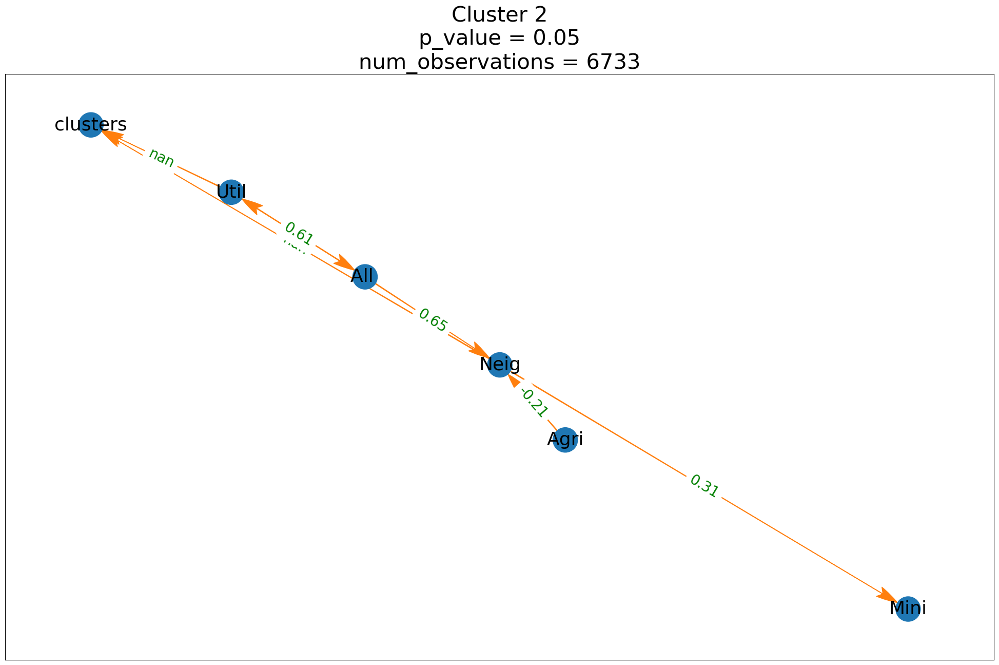

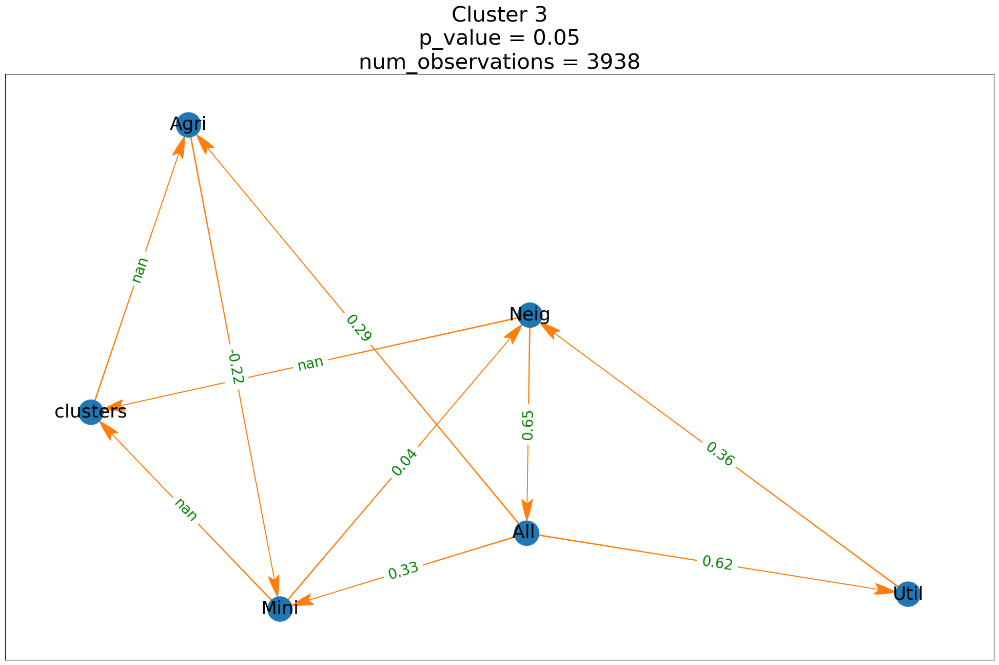

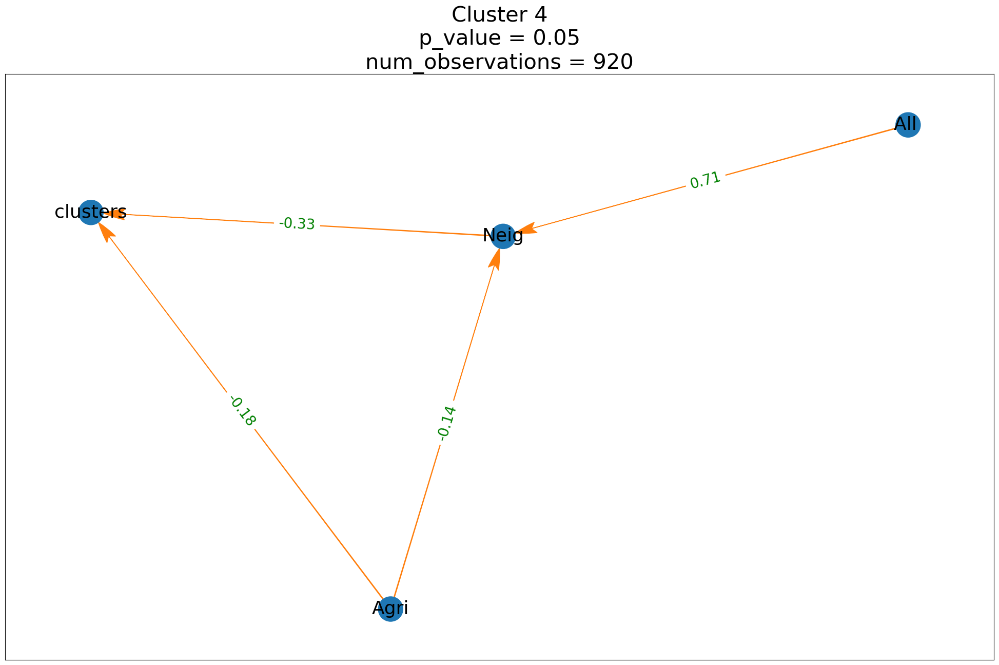

In [58]:
# List of DataFrames
cluster_dataframes = [c1_df2, c2_df2, c3_df2, c4_df2]

p_value = 0.05
max_cond_vars = len(c1_df2.columns) - 2  # Assuming all DataFrames have the same columns

pp = PdfPages("DAGOutputs_withoutm4m4I.pdf")


def graph_DAG(edges, df, title="Directed Acyclic Graph"):
    graph = nx.DiGraph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.columns if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]] + keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]], 2))
    graph.add_edges_from(edges)
    color_map = ['C0' for g in graph]

    fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = nx.spring_layout(graph)
    
    plt.title(title, fontsize=30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                     arrows=True, font_color='k', font_size=26, alpha=1, width=1,
                     edge_color='C1',
                     arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax=ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)
    pp.savefig(fig, bbox_inches="tight")

for idx, c_df in enumerate(cluster_dataframes):
    c = PC(c_df)
    n = c_df.shape[0]
    model = c.estimate(return_type='pdag', variant='parallel', significance_level= p_value, max_cond_vars=max_cond_vars, ci_test='pearsonr')
    edges = model.edges

    # Call the graph_DAG function for each cluster DataFrame
    #graph_DAG(edges, c_df, title=f'Cluster {idx + 1} Directed Acyclic Graph')
    graph_DAG(edges, c_df, title=f'Cluster {idx + 1}\np_value = {p_value}\nnum_observations = {n}' )

pp.close()


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/3114789117.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(20, 12))


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

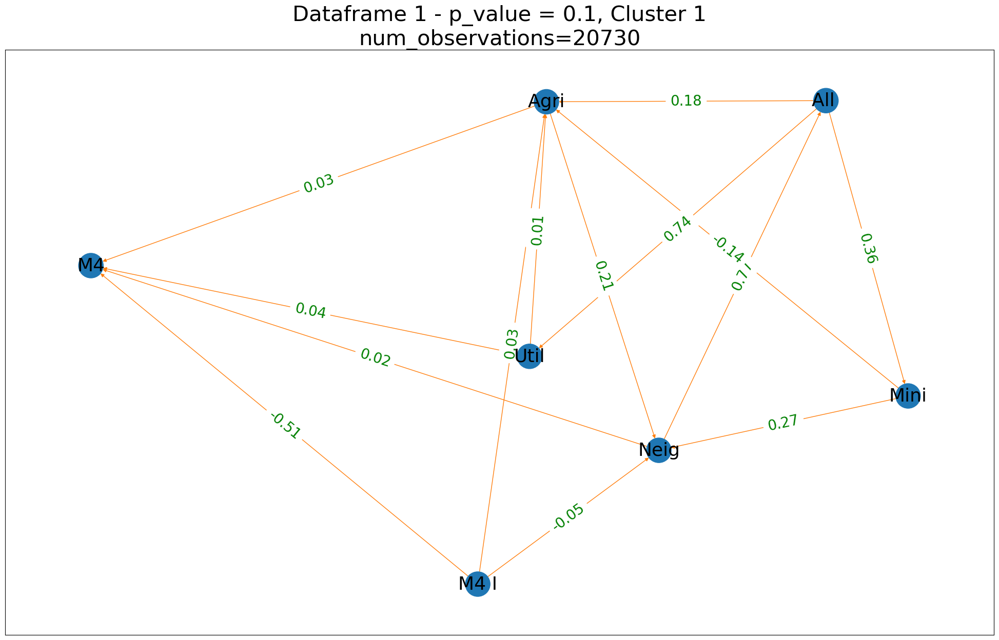

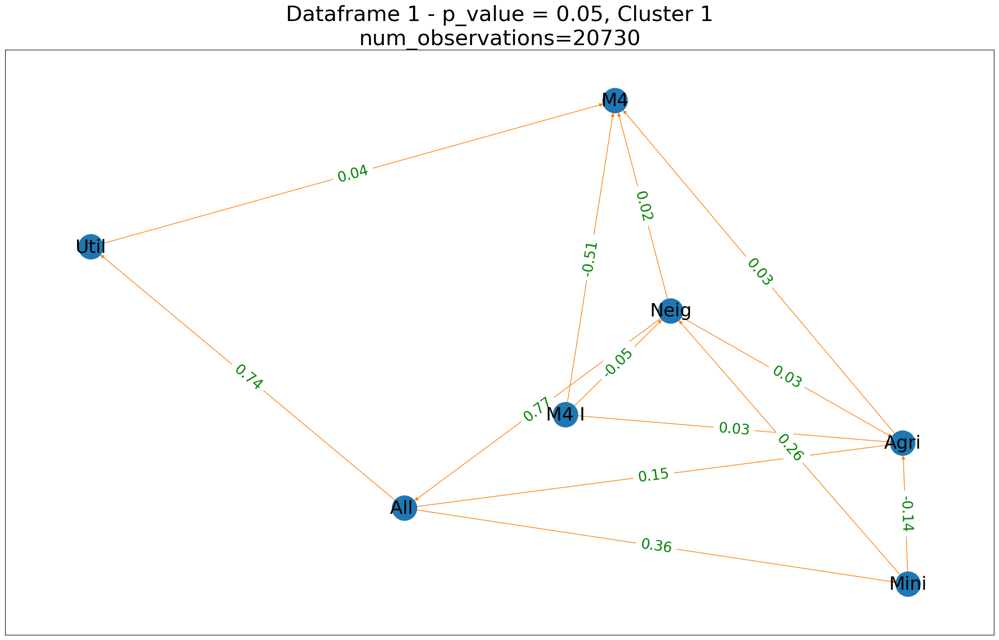

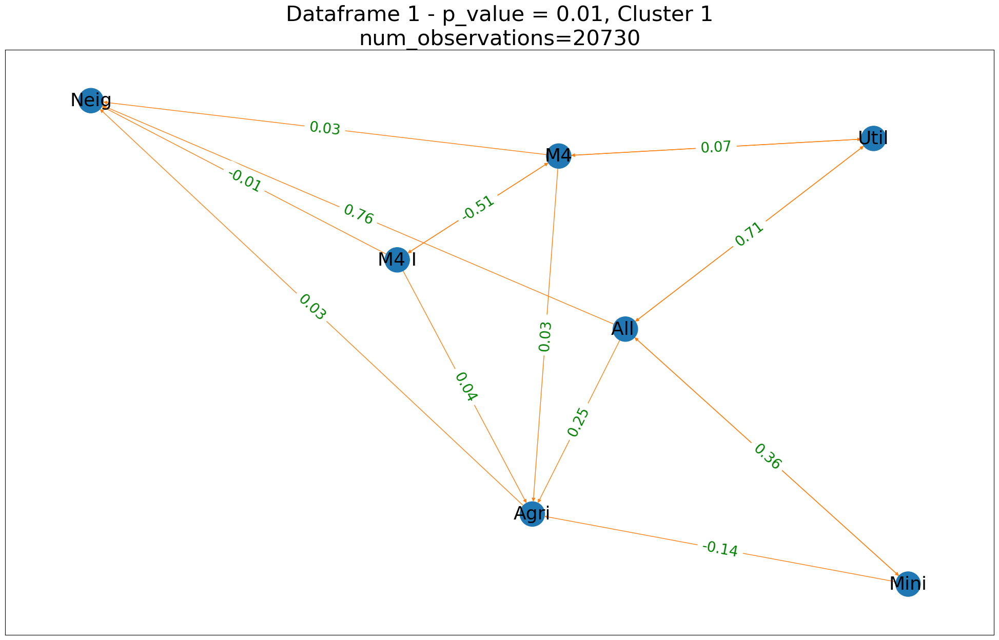

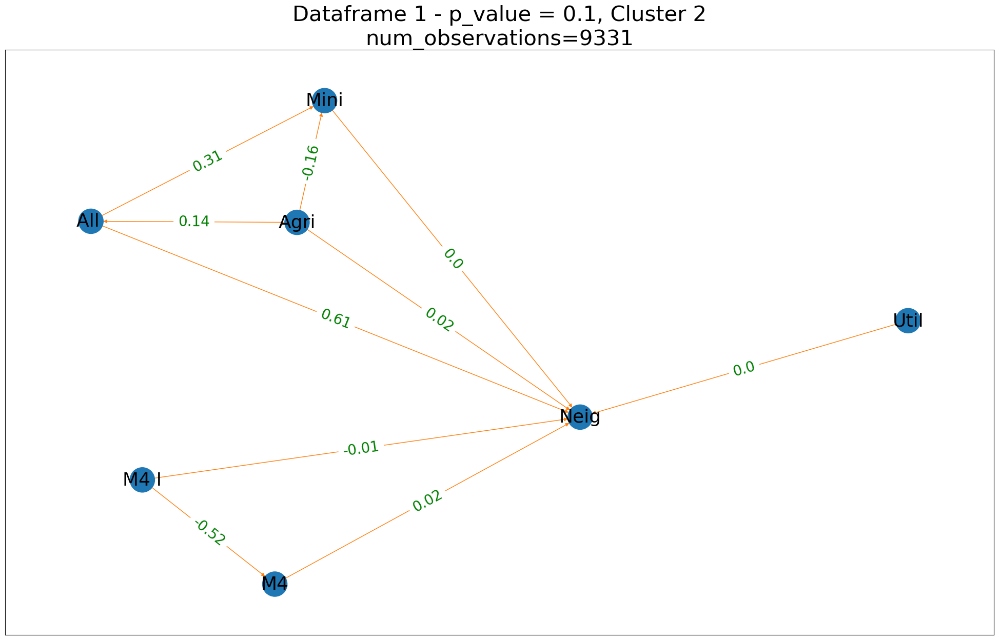

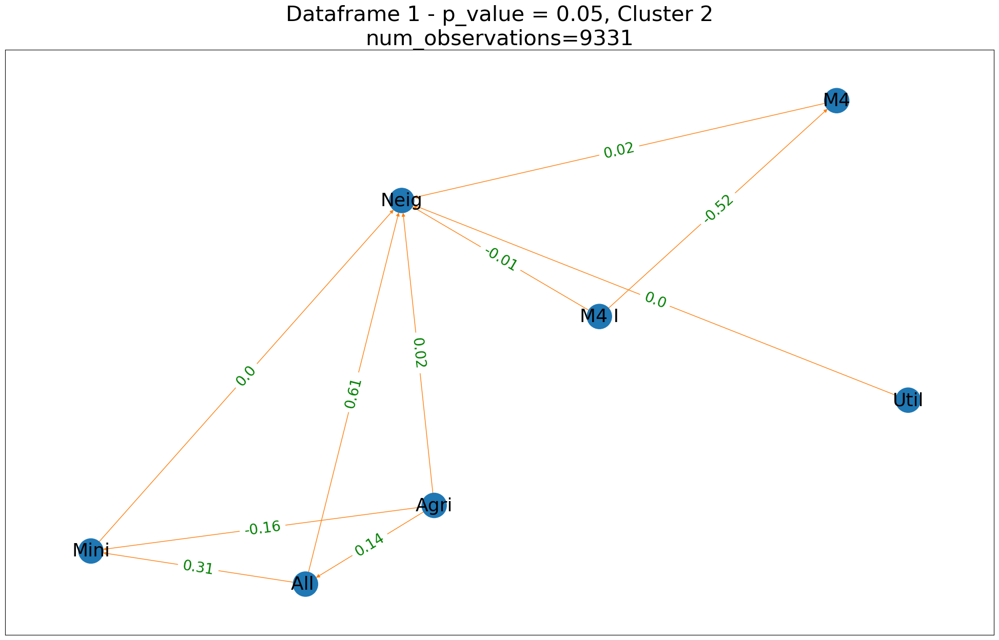

...

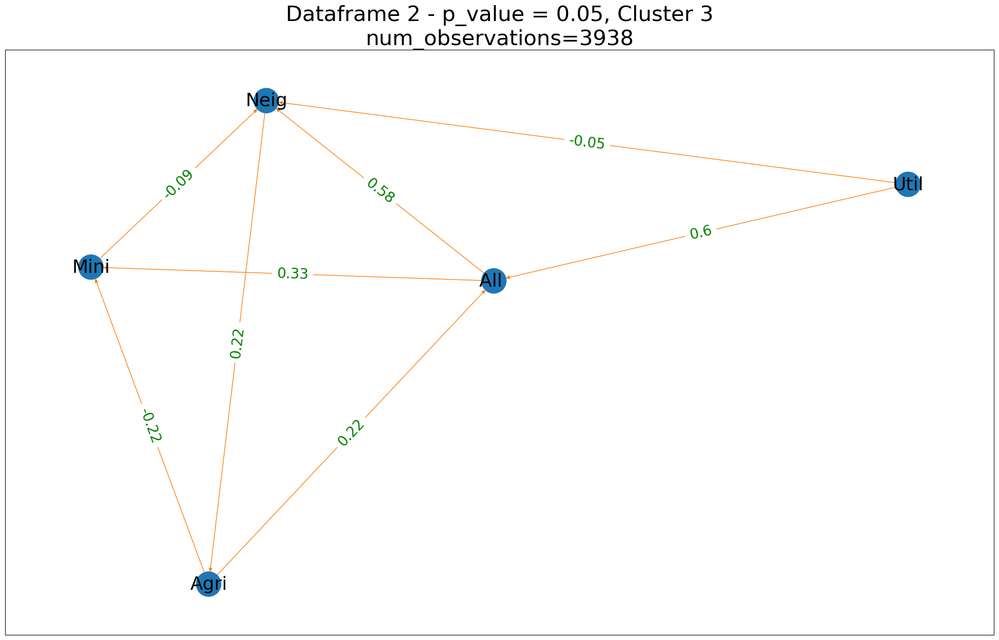

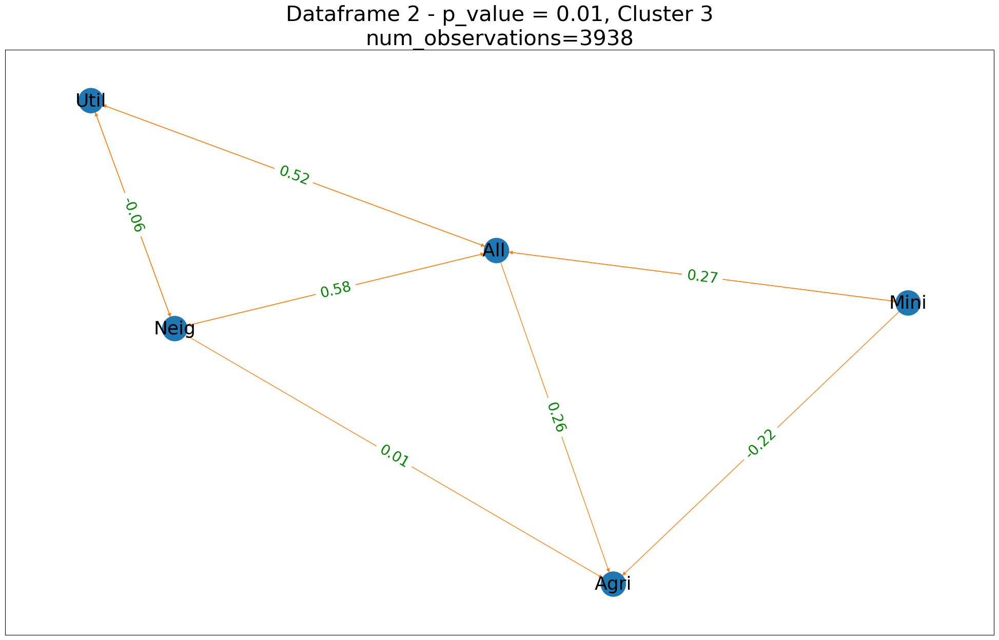

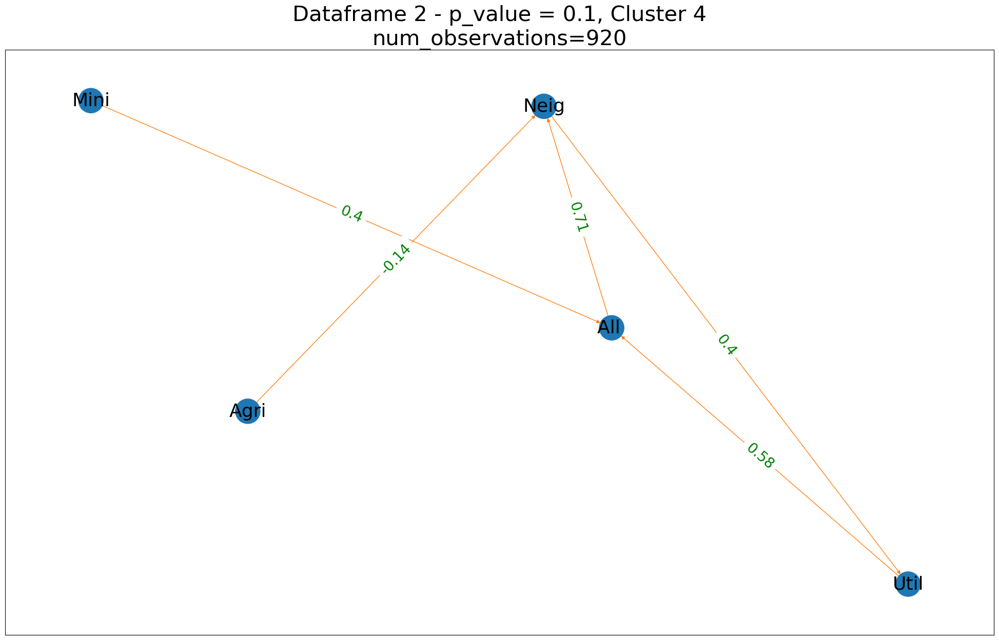

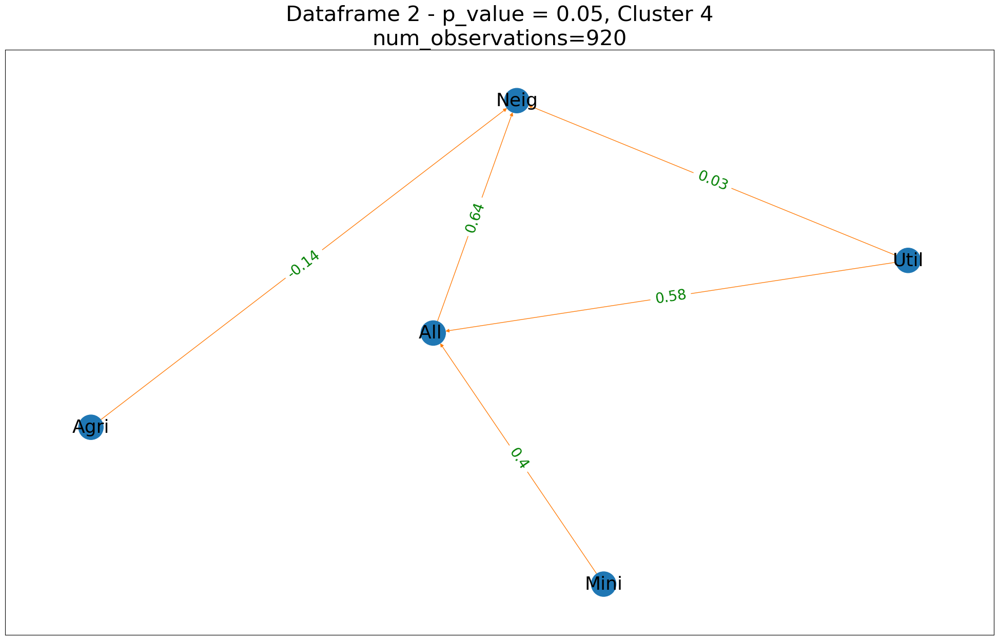

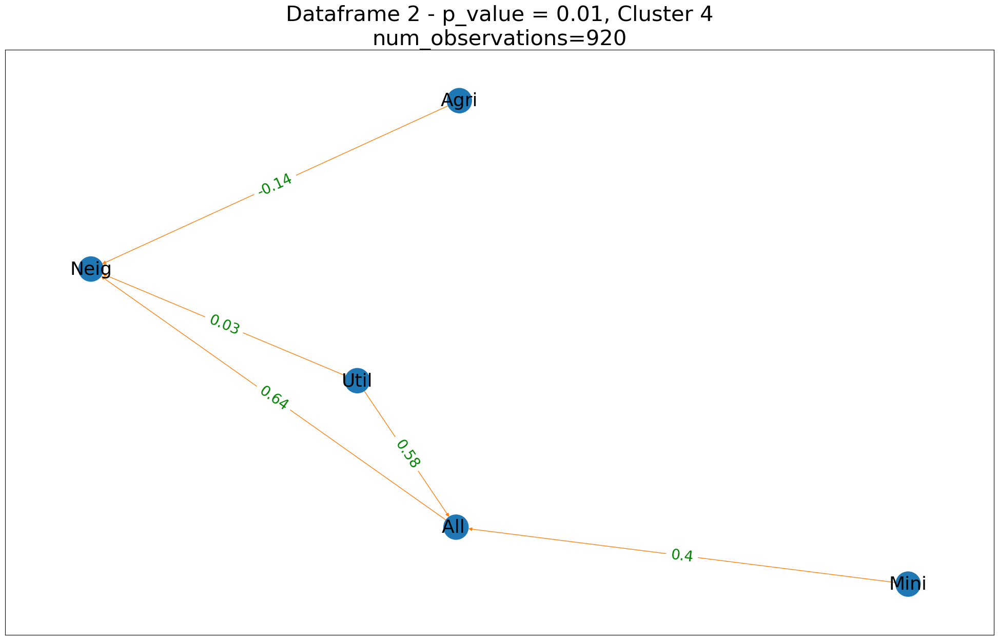

In [59]:
# List of your three different datasets (replace these with your actual datasets)
dataframes = [kml3d_cl_level, kml3d_cl_level2] 

# List of p-values for each dataframe
p_values_list = [[0.1, 0.05, 0.01], [0.1, 0.05, 0.01]]

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def graph_DAG(edges, df, title="Directed Acyclic Graph", pp=None):
    graph = nx.DiGraph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.columns if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                keep_controls.append(control)
        pcorr = df[[edge[0], edge[1]] + keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]], 2))
    graph.add_edges_from(edges)
    color_map = ['C0' for g in graph]

    fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = nx.spring_layout(graph)
    
    plt.title(title, fontsize=30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                     arrows=True, font_color='k', font_size=26, alpha=1, width=1,
                     edge_color='C1', ax=ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)
    pp.savefig(fig, bbox_inches="tight")

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    
    # List of p-values for the current dataframe
    p_values = p_values_list[idx]

    # Create a PDF file to save multiple DAGs for the current dataframe
    pdf_file = f"DAGOutputs_{output_names[idx]}.pdf"
    pp = PdfPages(pdf_file)

    # Iterate over clustered dataframes and p-values to create DAGs
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        for p_value in p_values:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant='parallel', significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster and p-value using the provided graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - p_value = {p_value}, Cluster {cluster_idx + 1}\nnum_observations={n}'
            , pp=pp)

    pp.close()


### Using stable and fancy graphs

In [60]:
def graph_DAG(edges,
              data_reg,
              title = "",
              fig = False,
              ax = False,
              edge_labels = False,
              sig_vals = [0.05, 0.01, 0.001]):
    graph = nx.DiGraph()
    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0] ]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)                
#             print(edge, keep_controls)
            pcorr = df.partial_corr(x = edge[0], y = edge[1], covar=keep_controls,
                                  method = "pearson")
            label = str(round(pcorr["r"][0],2))
            pvalue = pcorr["p-val"][0]
#             pcorr = df[[edge[0], edge[1]]+keep_controls].pcorr()
#             label = pcorr[edge[0]].loc[edge[1]]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"  
           
            edge_labels[edge] = label
        return edge_labels
   
    if edge_labels == False:
        edge_labels = build_edge_labels(edges,
                                        data_reg,
                                        sig_vals=sig_vals)
#     for i in range(len(edges)):
#         edges[i]
       
    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    if fig == False and ax == False: fig, ax = plt.subplots(figsize = (20,12))
    graph.nodes()
    plt.tight_layout()
    args = "-Gmode='KK'"#-Gsep=2"    
    pos = graphviz_layout(graph, "neato", None)#,  args)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:  
            if (v,u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u,v]}\n\n\n{edge_labels[(v,u)]}'))  
        if (v,u) not in edge_labels.keys():
            edge_labels2.append(((u,v,), f'{edge_labels[(u,v)]}'))
    edge_labels = dict(edge_labels2)
    curved_edges = [edge for edge in graph.edges() if reversed(edge) in graph.edges()]
    straight_edges = list(set(graph.edges()) - set(curved_edges))
    nx.draw_networkx_edges(graph, pos, ax=ax, edgelist=straight_edges,  
                           width = 1, edge_color = "C1",
                           
                           arrowstyle=ArrowStyle("Fancy, head_length=2, head_width=1, tail_width=.1"),
                          )
    arc_rad = 0.31
    nx.draw_networkx(graph, pos, node_color=color_map, node_size = 750,
                       with_labels=True,  arrows=True,
                       font_color = "black",
                       font_size = 20, alpha = 1,
                       width = 1, edge_color = "C1",
                       ax=ax, edgelist=curved_edges, connectionstyle=f'arc3, rad = {arc_rad}',
                       arrowstyle=ArrowStyle("Fancy, head_length=1, head_width=1, tail_width=.1"),
                      )
#     nx.draw_networkx(graph, pos, node_color=color_map, node_size = 500,
#                      with_labels=True,  arrows=True,
#                      font_color = "black",
#                      font_size = 16, alpha = 1,
#                      width = 1, edge_color = "C1",
#                      arrowstyle=ArrowStyle("Fancy, head_length=3, head_width=1.5, tail_width=.1"),
#                      connectionstyle='arc3, rad = 0.5',
#                      ax = ax)
    nx.draw_networkx_edge_labels(graph,
                                 pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=15,
                                 alpha = 1,
                                 ax = ax)

### All DAGs without specifying p-value criteria

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/2903419693.py:57: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(20, 12))


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

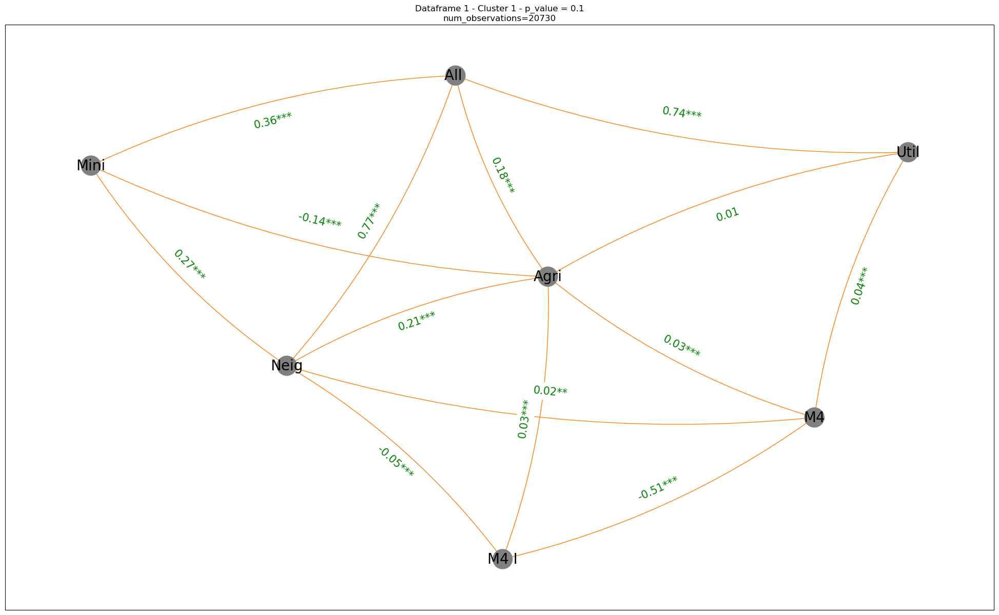

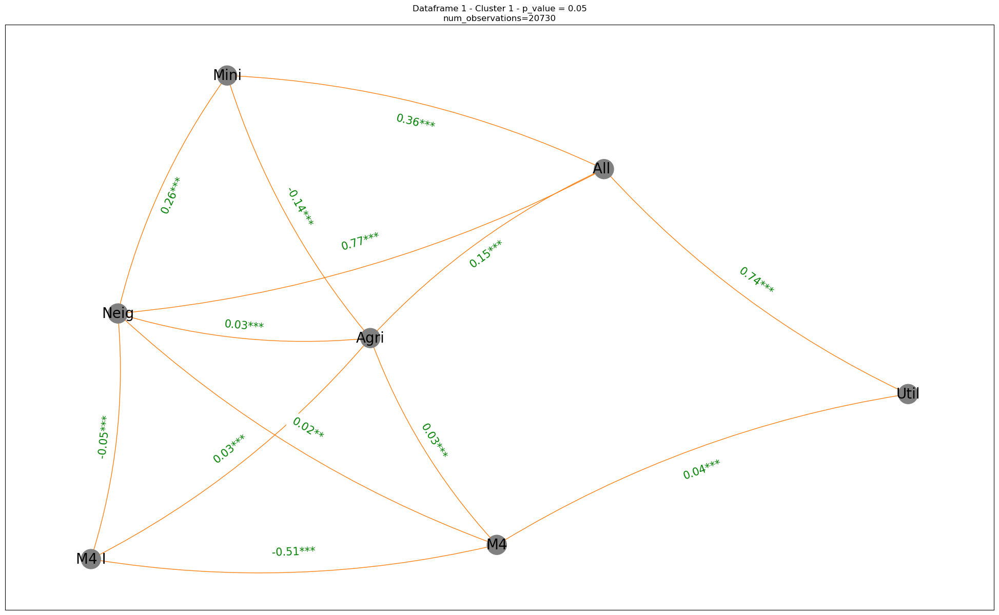

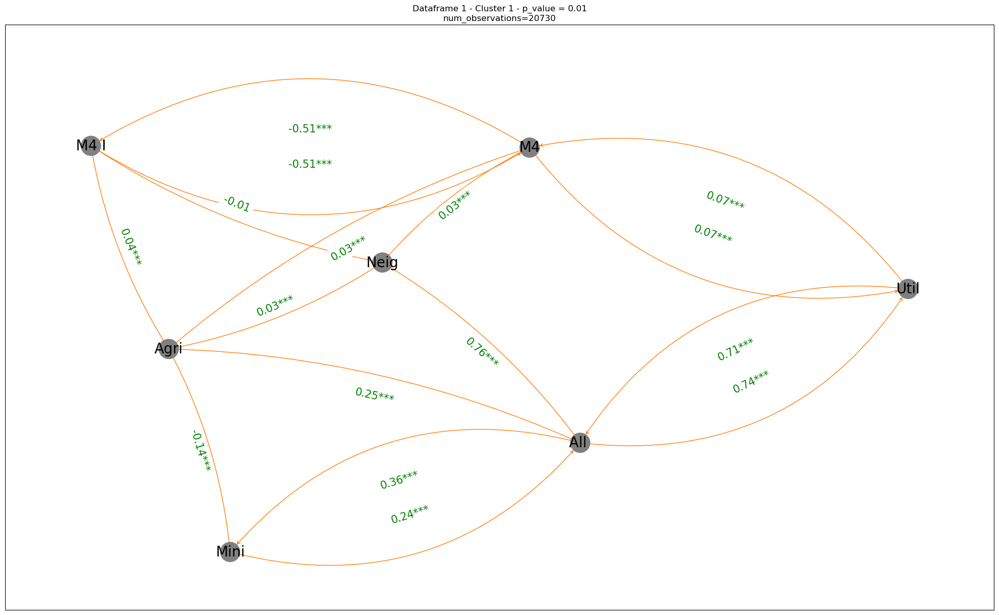

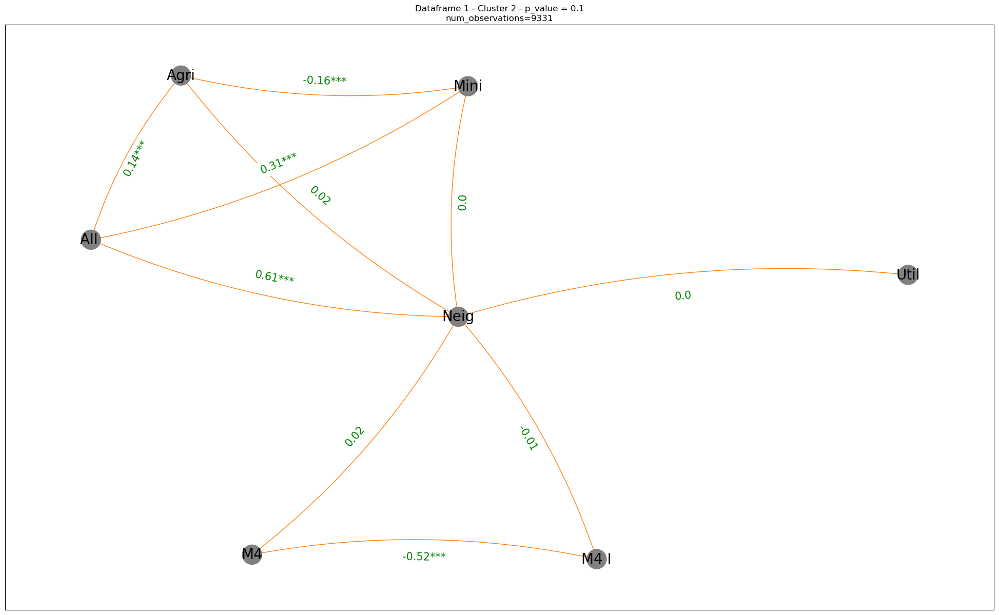

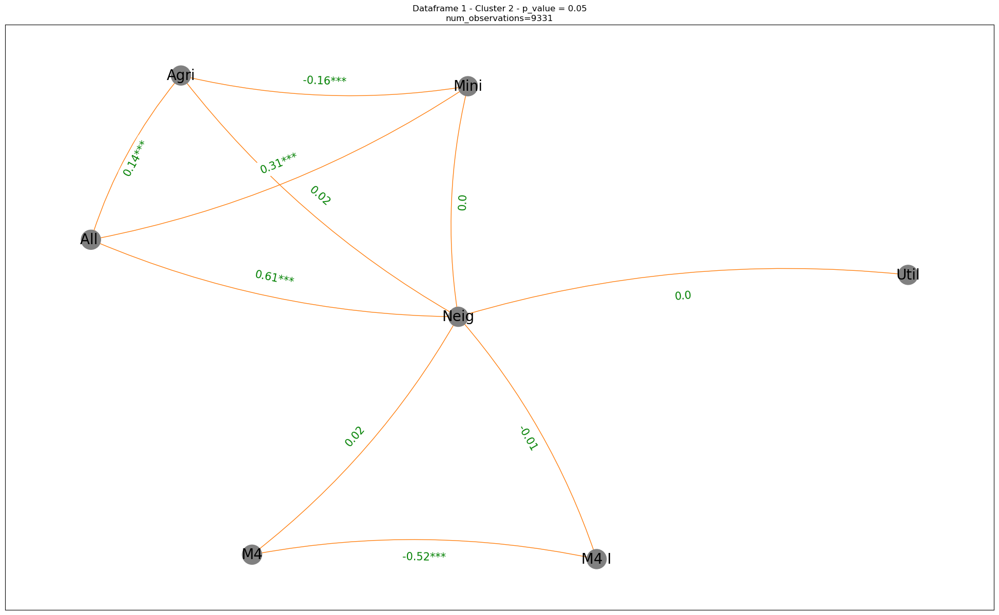

...

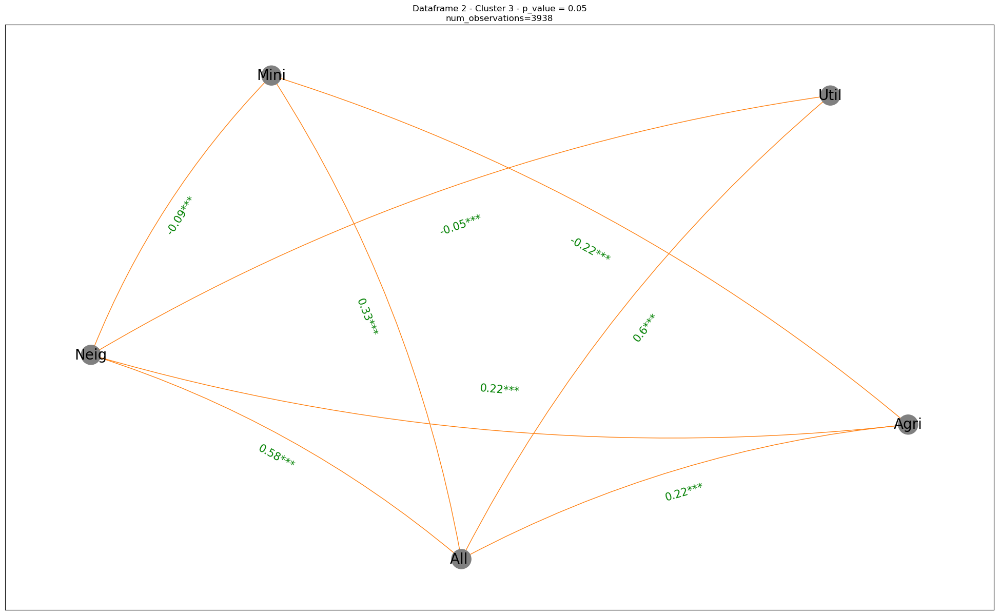

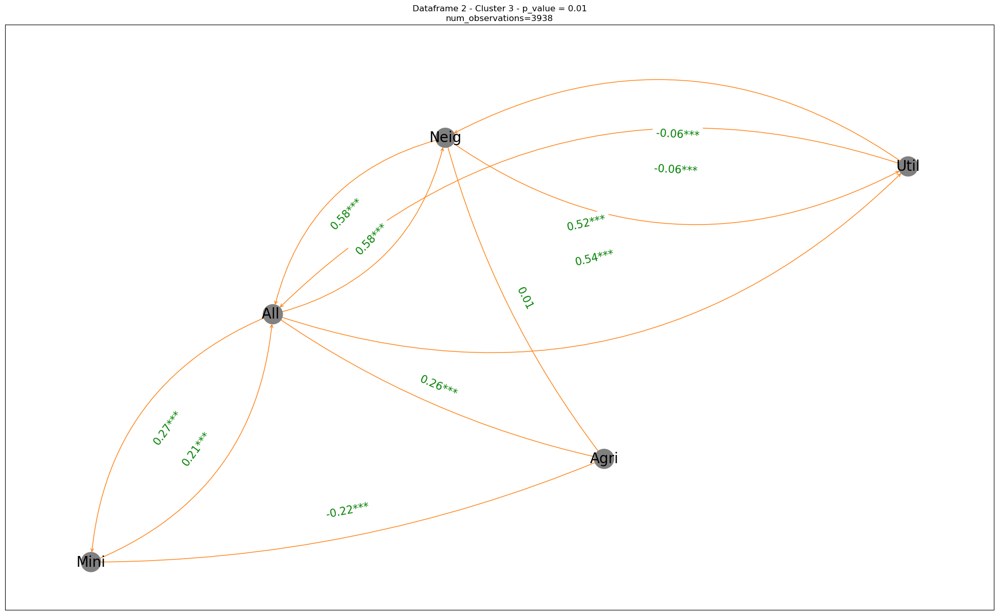

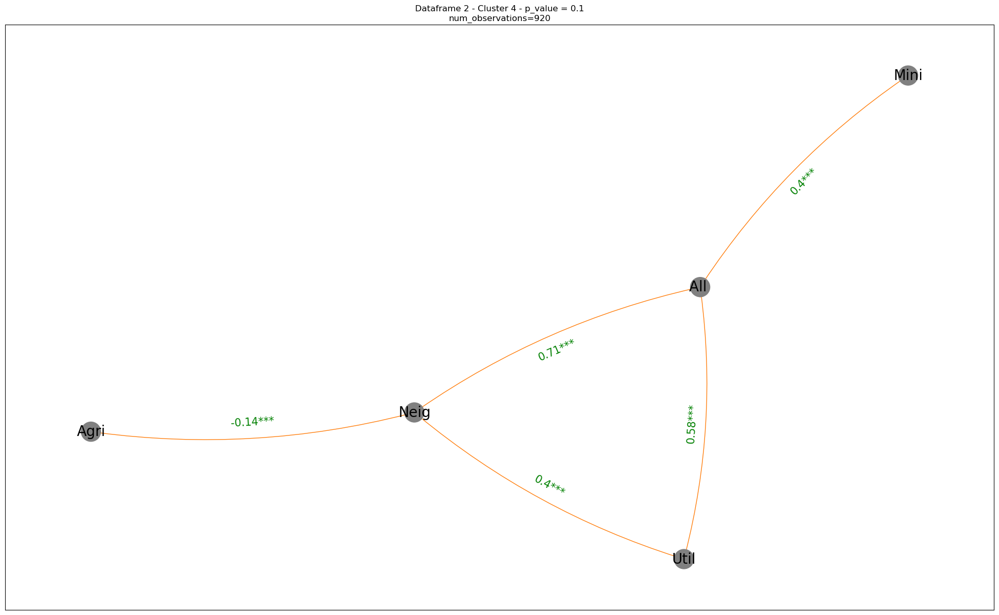

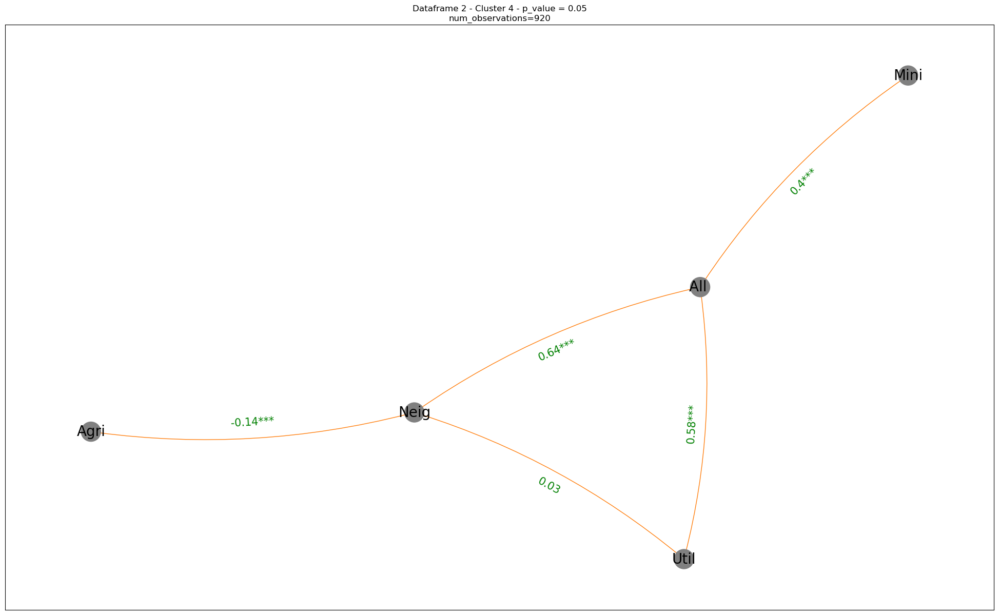

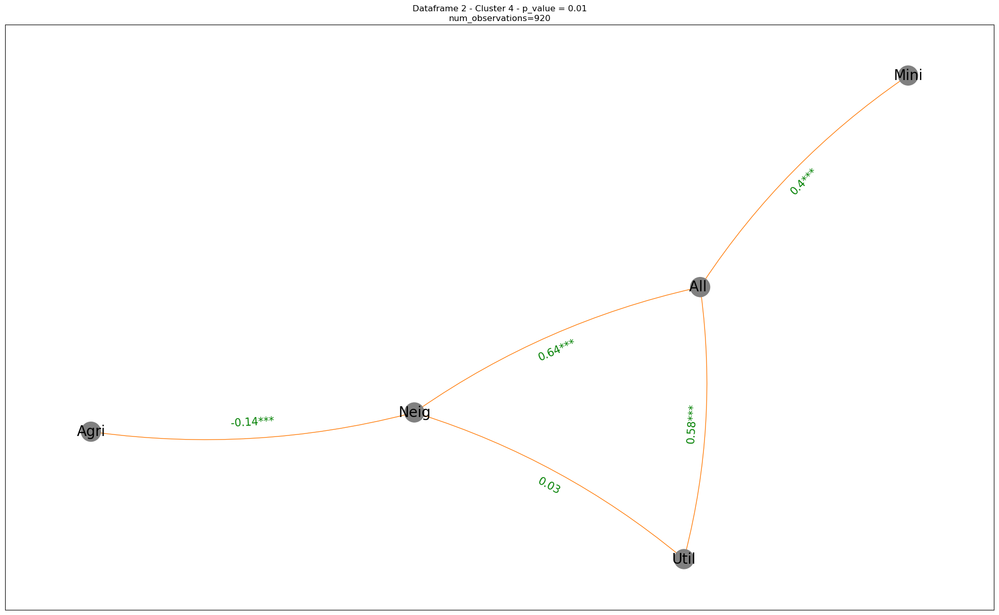

In [61]:
# List of dataframes
dataframes = [kml3d_cl_level, kml3d_cl_level2]

# List of p-values for each dataframe
p_values_list = [[0.1, 0.05, 0.01], [0.1, 0.05, 0.01]]

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def graph_DAG(edges, df, title="", fig=False, ax=False, edge_labels=False, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if edge_labels == False:
        edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    if fig == False and ax == False:
        fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    args = "-Gmode='KK'"
    pos = graphviz_layout(graph, "neato", None)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u,v]}\n\n\n{edge_labels[(v,u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u,v)]}'))
    edge_labels = dict(edge_labels2)
    curved_edges = [edge for edge in graph.edges() if reversed(edge) in graph.edges()]
    straight_edges = list(set(graph.edges()) - set(curved_edges))
    nx.draw_networkx_edges(graph, pos=pos, ax=ax, edgelist=straight_edges,
                           width=1, edge_color="C1", arrowstyle="->", connectionstyle="arc3,rad=0.1")
    arc_rad = 0.31
    nx.draw_networkx(graph, pos=pos, node_color=color_map, node_size=750,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=20, alpha=1,
                     width=1, edge_color="C1",
                     ax=ax, edgelist=curved_edges, connectionstyle=f'arc3, rad = {arc_rad}',
                     arrowstyle="->")
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=15,
                                 alpha=1,
                                 ax=ax)
    
    # Add title to the DAG
    ax.set_title(title)

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    
    # List of p-values for the current dataframe
    p_values = p_values_list[idx]

    # Specify the absolute path for the output PDF file
    pdf_file = os.path.abspath(f"DAGOutputs_{output_names[idx]}.pdf")
    pp = PdfPages(pdf_file)

    # Iterate over clustered dataframes and p-values to create DAGs
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        for p_value in p_values:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant='parallel', significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster and p-value using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
            , pp=pp)

    pp.close()


### if number of observations is 800 and above use p-value of 0.05 if less then use 0.1

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

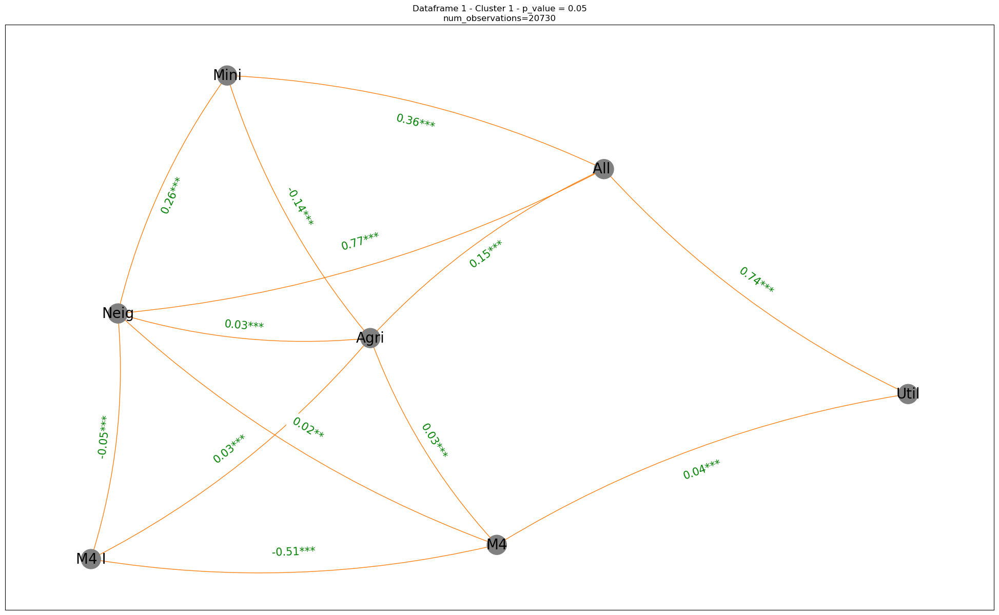

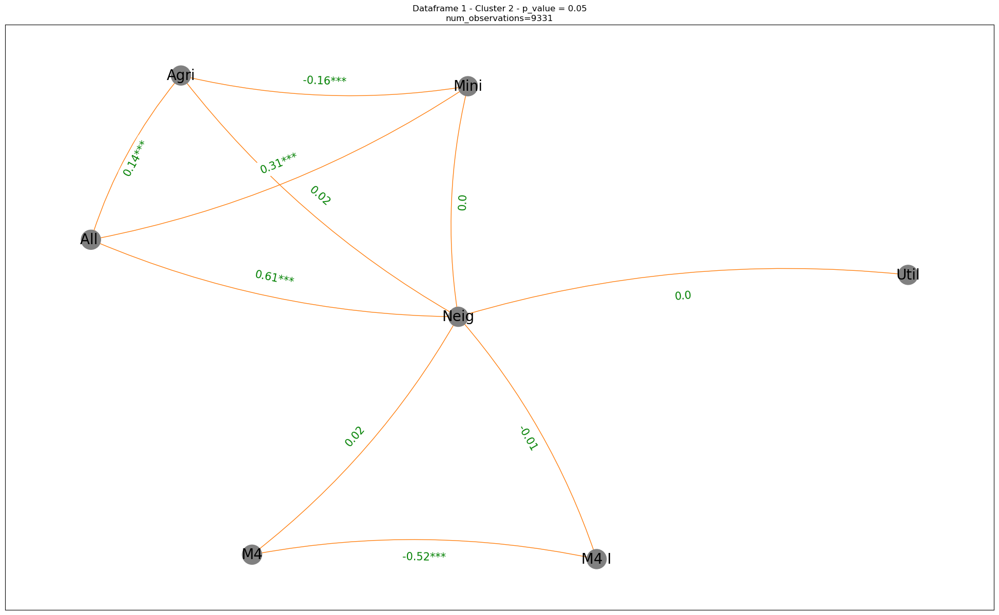

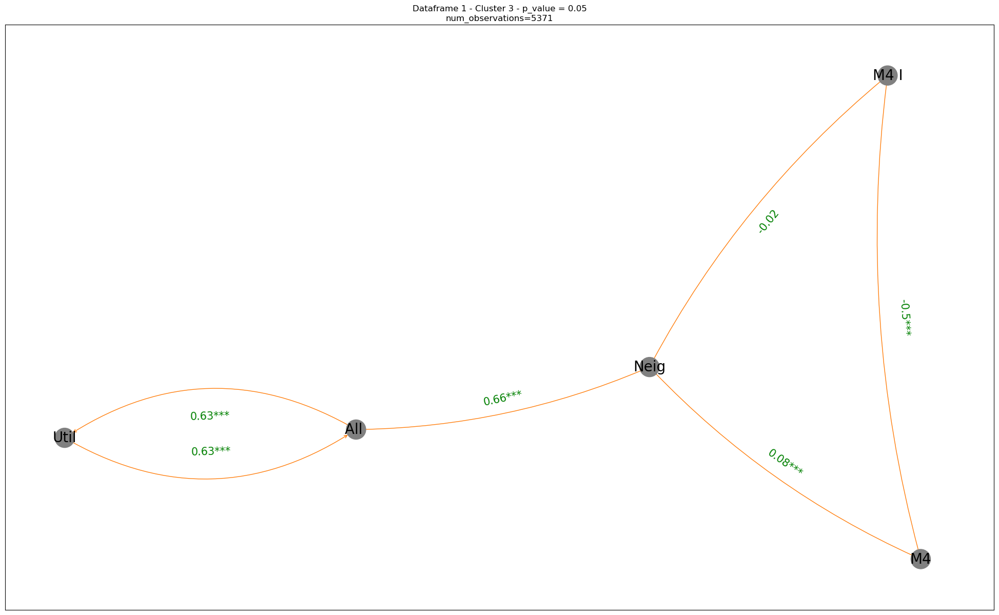

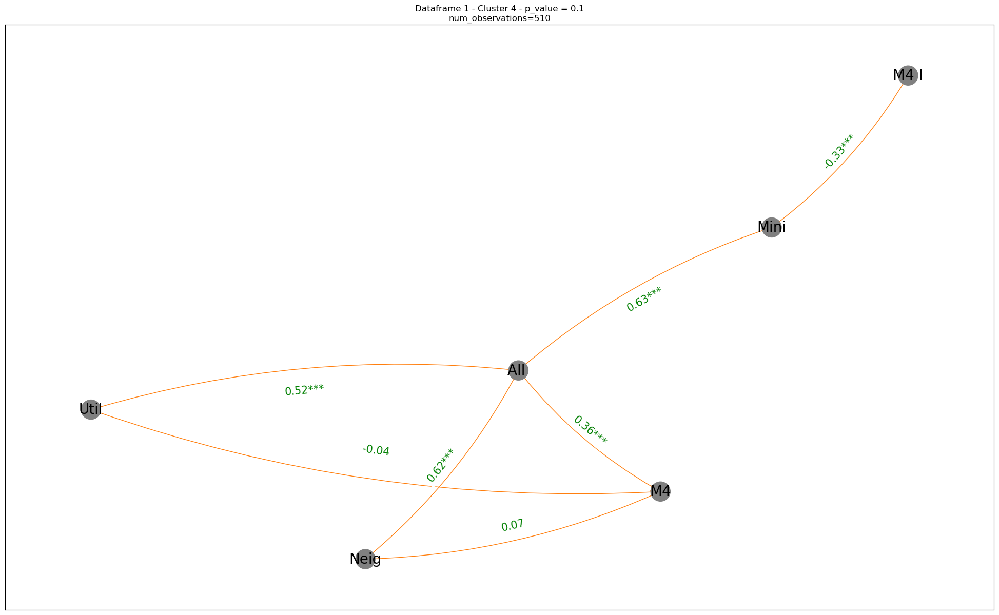

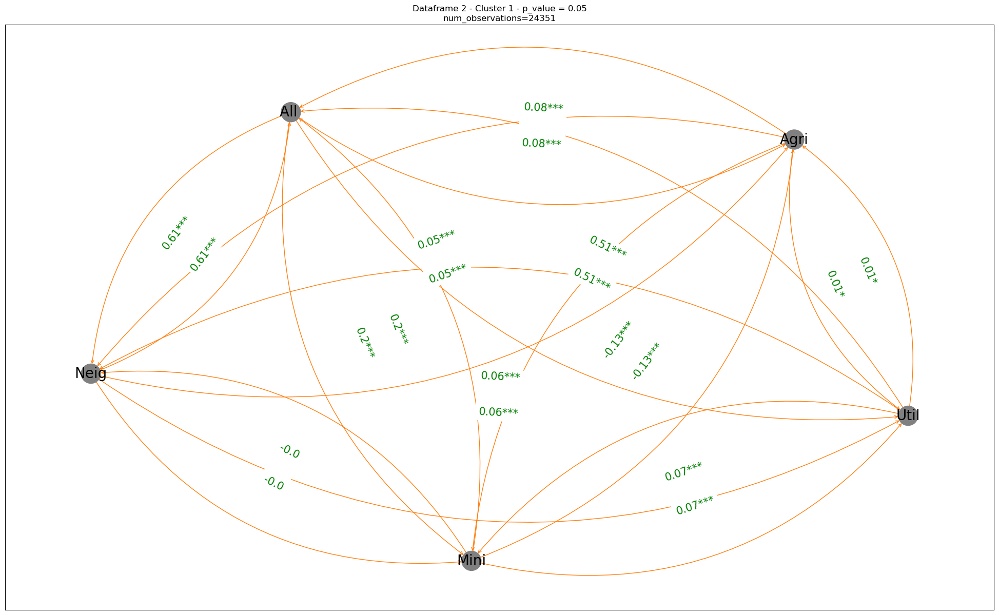

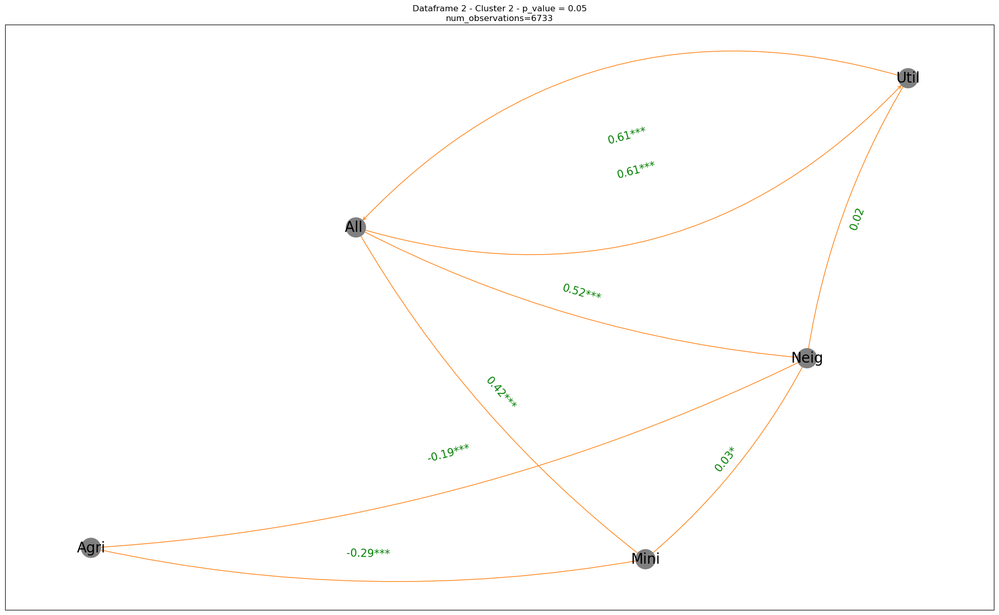

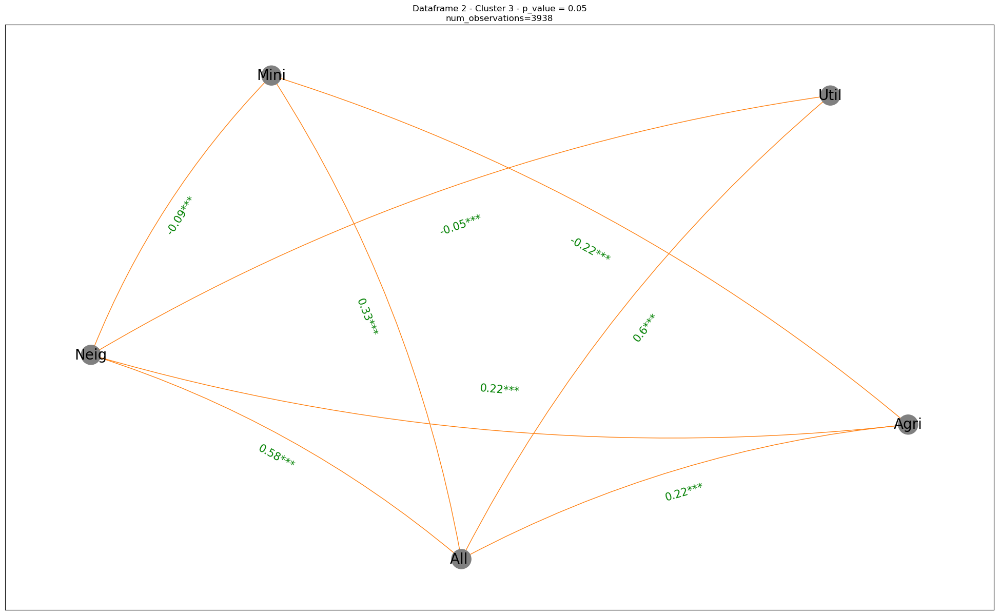

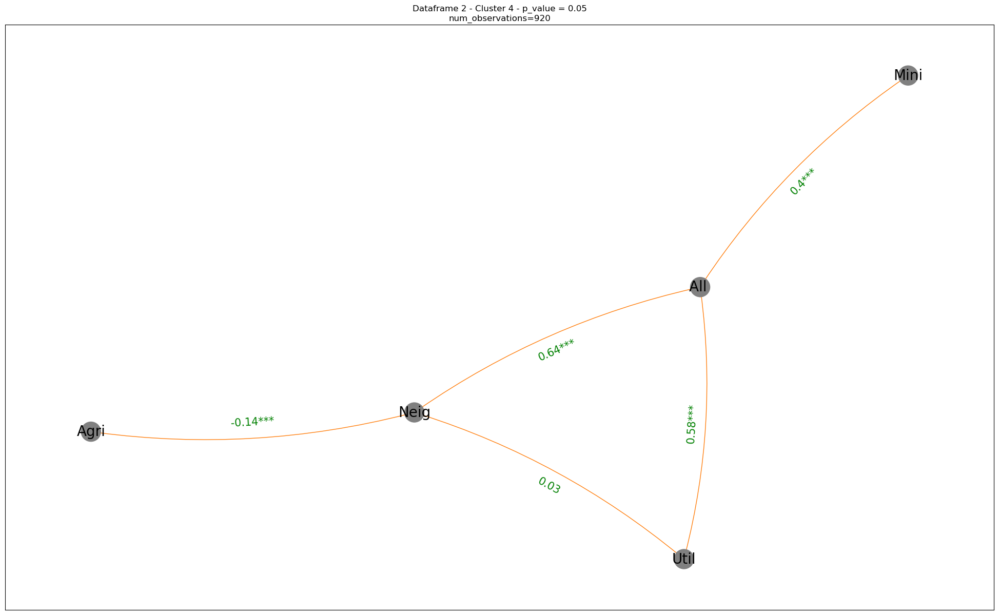

In [62]:
dataframes = [kml3d_cl_level, kml3d_cl_level2]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", fig=False, ax=False, edge_labels=False, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if edge_labels == False:
        edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    if fig == False and ax == False:
        fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    args = "-Gmode='KK'"
    pos = graphviz_layout(graph, "neato", None)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u,v]}\n\n\n{edge_labels[(v,u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u,v)]}'))
    edge_labels = dict(edge_labels2)
    curved_edges = [edge for edge in graph.edges() if reversed(edge) in graph.edges()]
    straight_edges = list(set(graph.edges()) - set(curved_edges))
    nx.draw_networkx_edges(graph, pos=pos, ax=ax, edgelist=straight_edges,
                           width=1, edge_color="C1", arrowstyle="->", connectionstyle="arc3,rad=0.1")
    arc_rad = 0.31
    nx.draw_networkx(graph, pos=pos, node_color=color_map, node_size=750,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=20, alpha=1,
                     width=1, edge_color="C1",
                     ax=ax, edgelist=curved_edges, connectionstyle=f'arc3, rad = {arc_rad}',
                     arrowstyle="->")
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=15,
                                 alpha=1,
                                 ax=ax)
    
    # Add title to the DAG
    ax.set_title(title)

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    
    # Specify the absolute path for the output PDF file
    pdf_file = os.path.abspath(f"DAGOutputs_{output_names[idx]}.pdf")
    pp = PdfPages(pdf_file)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        c = PC(cluster_df)
        model = c.estimate(return_type='pdag', variant='parallel', significance_level=p_value, ci_test='pearsonr')
        edges = model.edges

        # Create DAG for the current cluster and p-value using the modified graph_DAG function
        graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
        , pp=pp)

    pp.close()


### Add arrows for causal directions

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

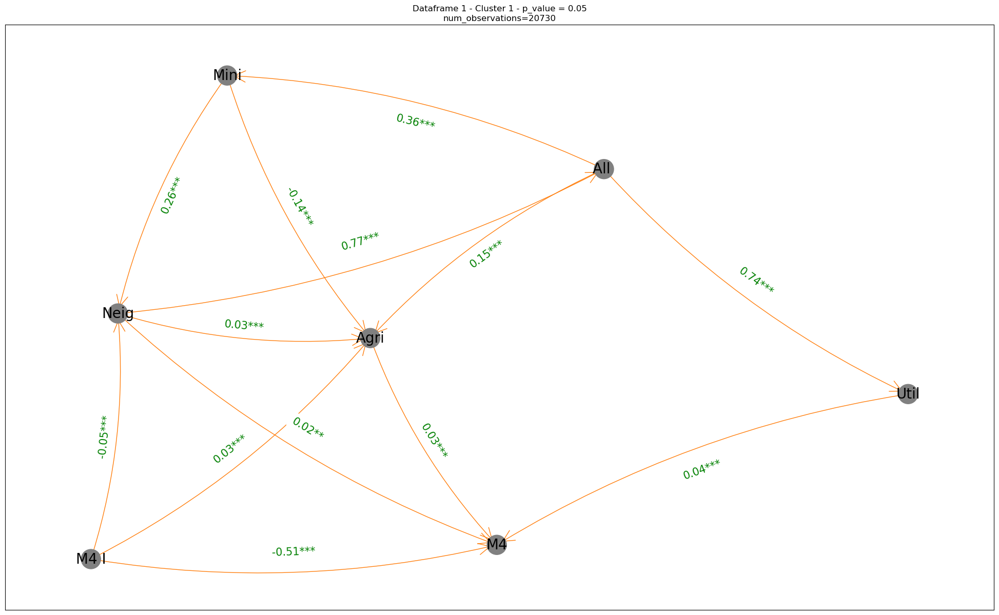

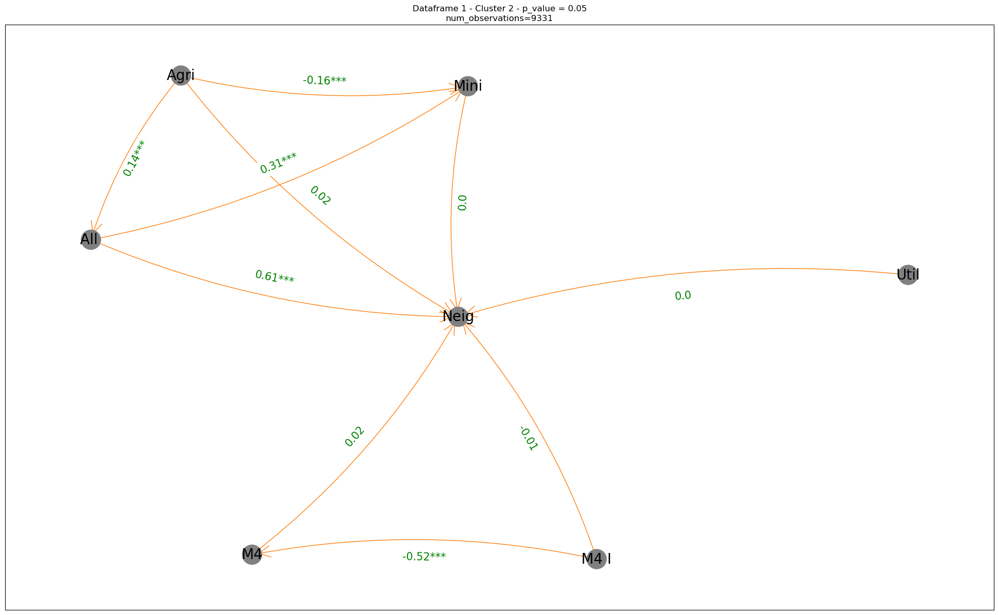

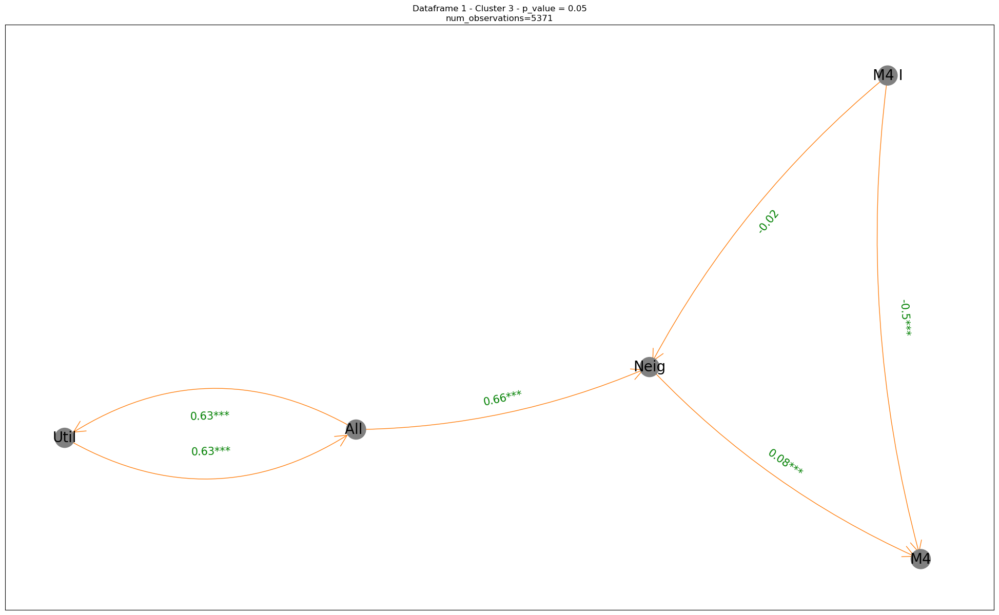

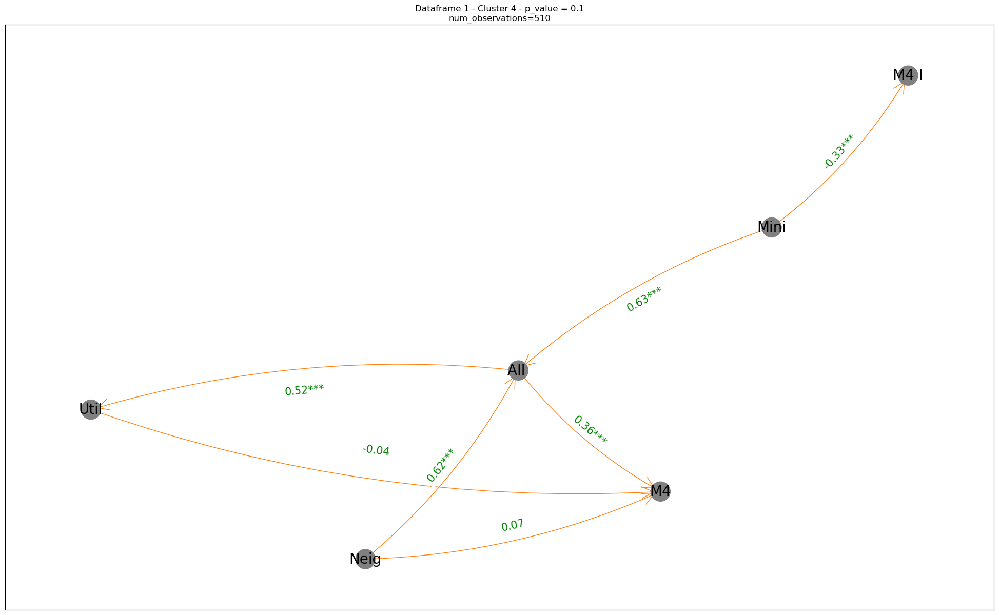

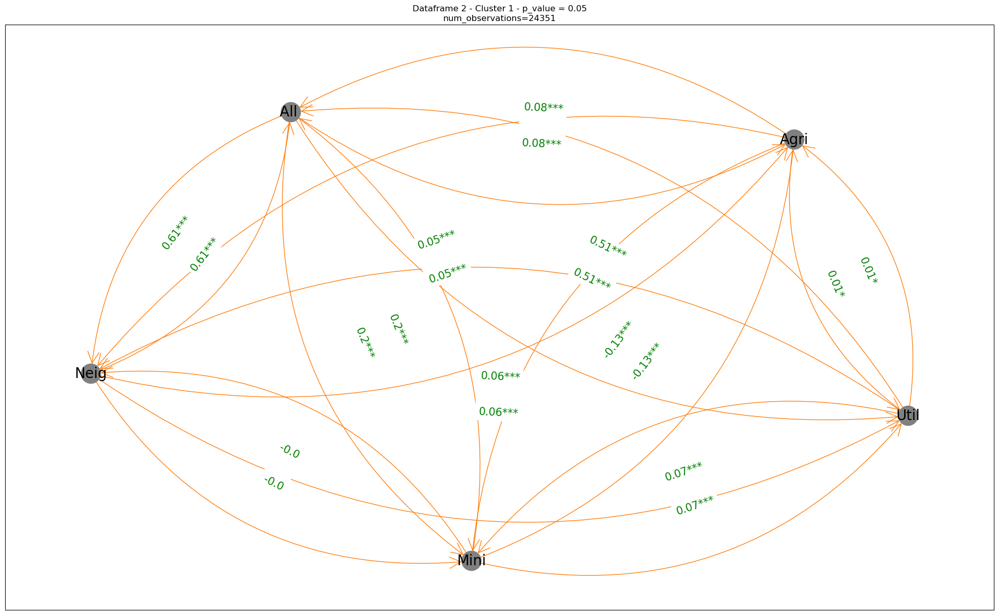

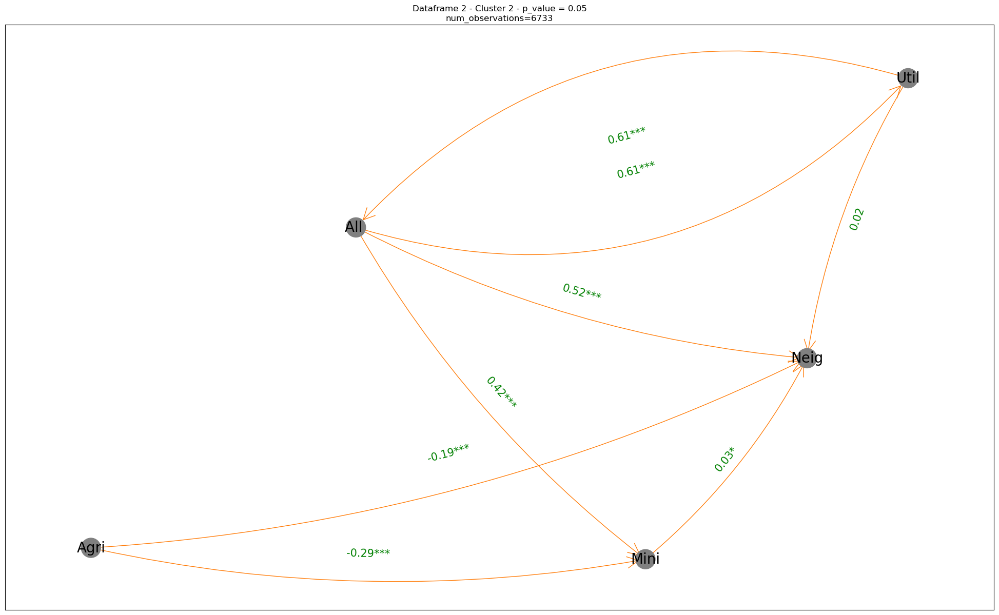

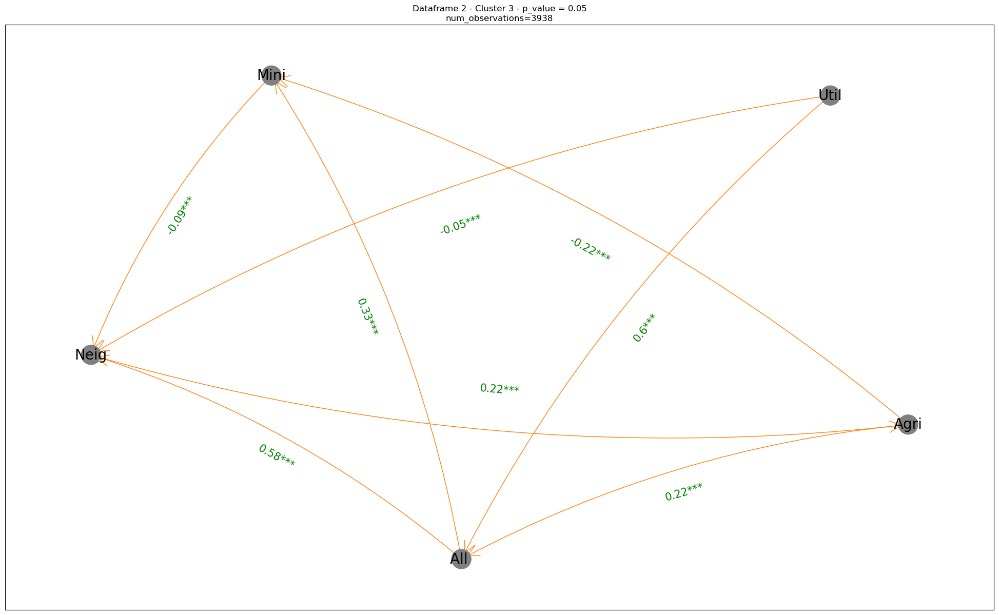

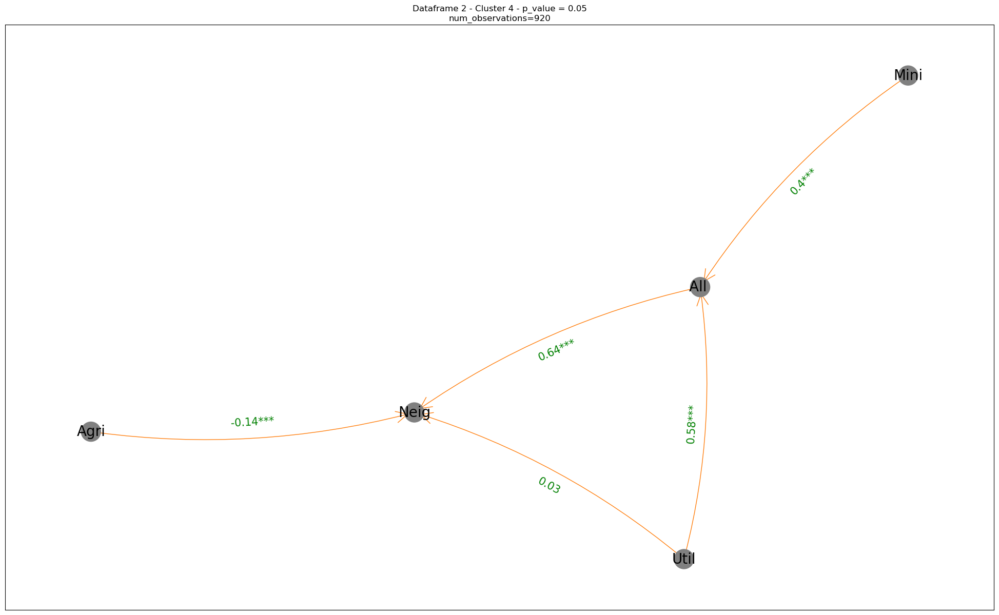

In [63]:
dataframes = [kml3d_cl_level, kml3d_cl_level2]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", fig=False, ax=False, edge_labels=False, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if edge_labels == False:
        edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    if fig == False and ax == False:
        fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    args = "-Gmode='KK'"
    pos = graphviz_layout(graph, "neato", None)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u,v]}\n\n\n{edge_labels[(v,u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u,v)]}'))
    edge_labels = dict(edge_labels2)
    curved_edges = [edge for edge in graph.edges() if reversed(edge) in graph.edges()]
    straight_edges = list(set(graph.edges()) - set(curved_edges))
    
    # Use nx.draw_networkx_edges with arrowsize to control arrowhead size
    nx.draw_networkx_edges(graph, pos=pos, ax=ax, edgelist=straight_edges,
                           width=1, edge_color="C1", arrowstyle="->", connectionstyle="arc3,rad=0.1", arrowsize=40)
    arc_rad = 0.31
    nx.draw_networkx(graph, pos=pos, node_color=color_map, node_size=750,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=20, alpha=1,
                     width=1, edge_color="C1",
                     ax=ax, edgelist=curved_edges, connectionstyle=f'arc3, rad = {arc_rad}',
                     arrowstyle="->", arrowsize=40)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=15,
                                 alpha=1,
                                 ax=ax)
    
    # Add title to the DAG
    ax.set_title(title)

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    
    # Specify the absolute path for the output PDF file
    pdf_file = os.path.abspath(f"DAGOutputs_{output_names[idx]}.pdf")
    pp = PdfPages(pdf_file)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        c = PC(cluster_df)
        model = c.estimate(return_type='pdag', variant='parallel', significance_level=p_value, ci_test='pearsonr')
        edges = model.edges

        # Create DAG for the current cluster and p-value using the modified graph_DAG function
        graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
        , pp=pp)

    pp.close()


### Using different algorithms

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/1451341953.py:63: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(20, 12))


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

TimeoutError: [Errno 60] Operation timed out

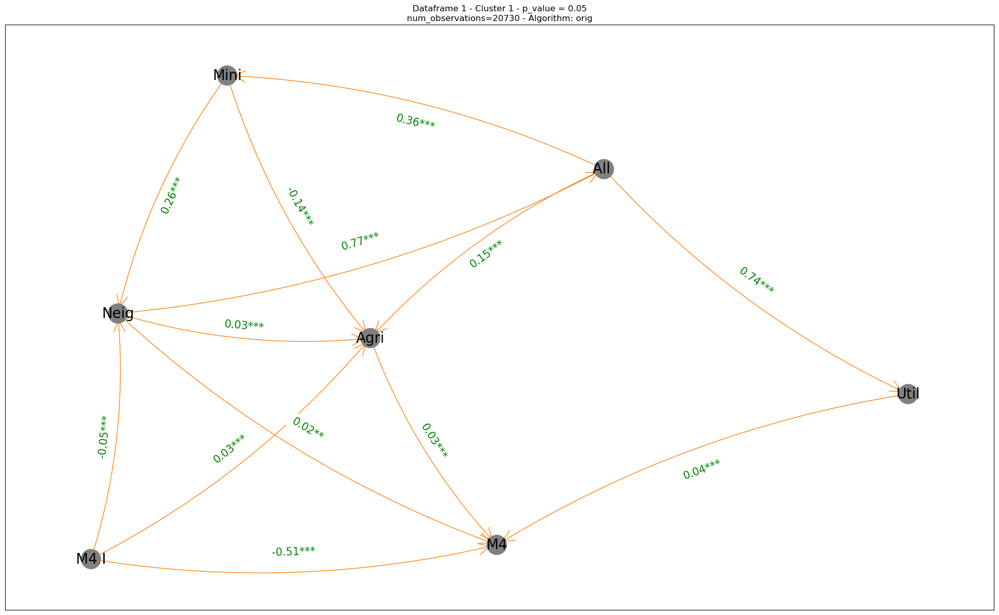

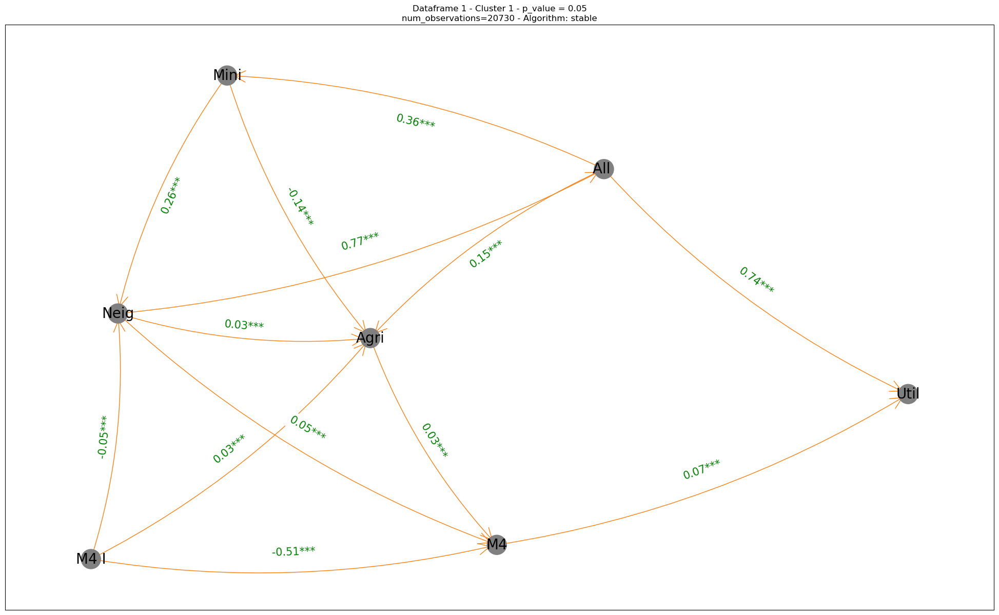

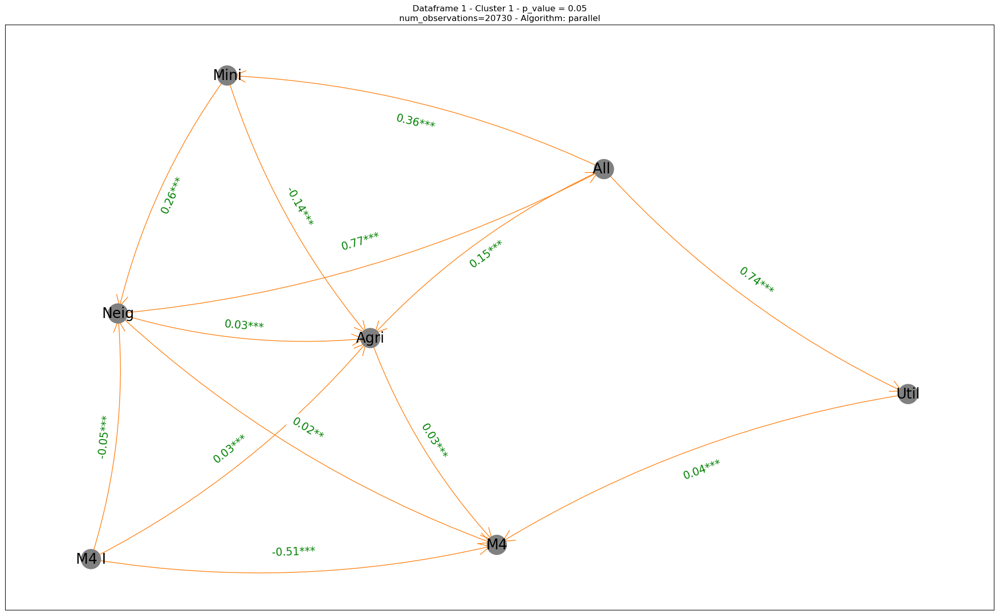

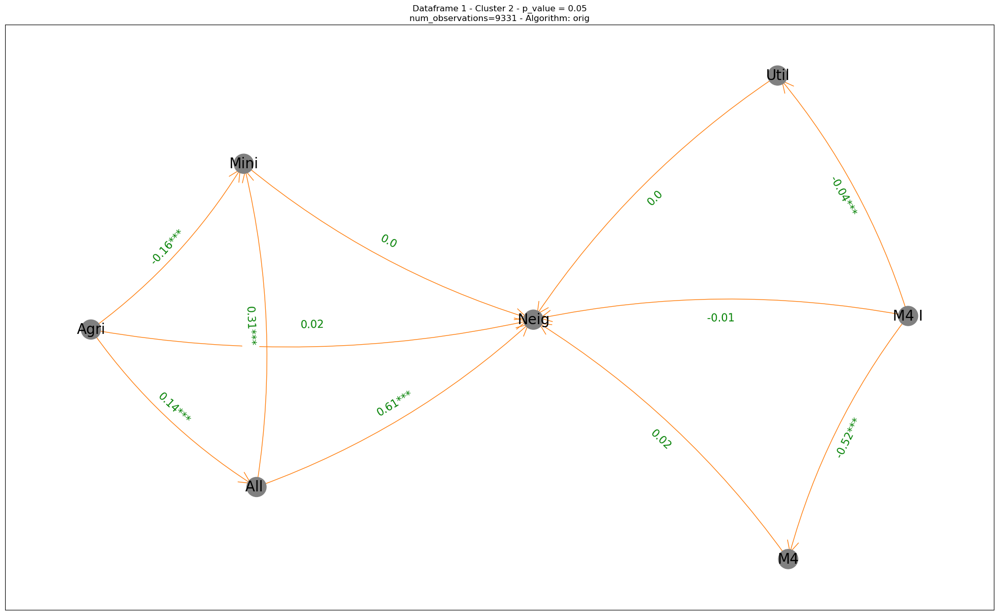

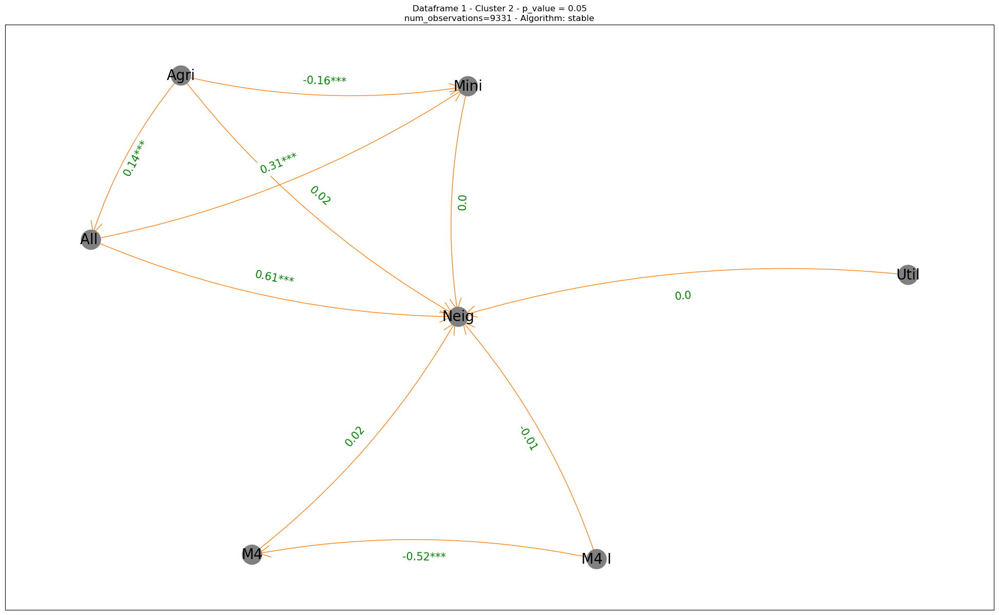

...

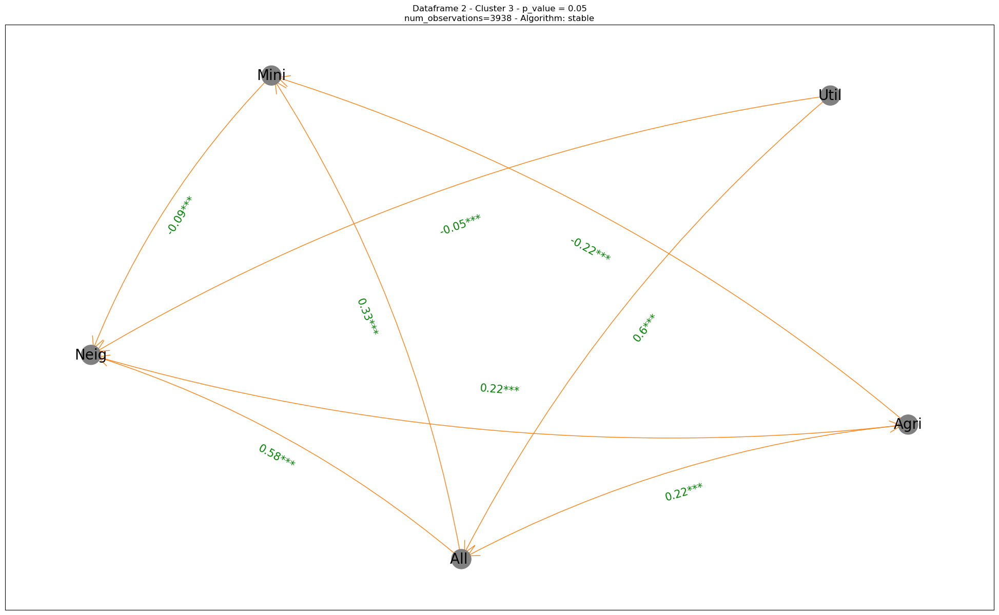

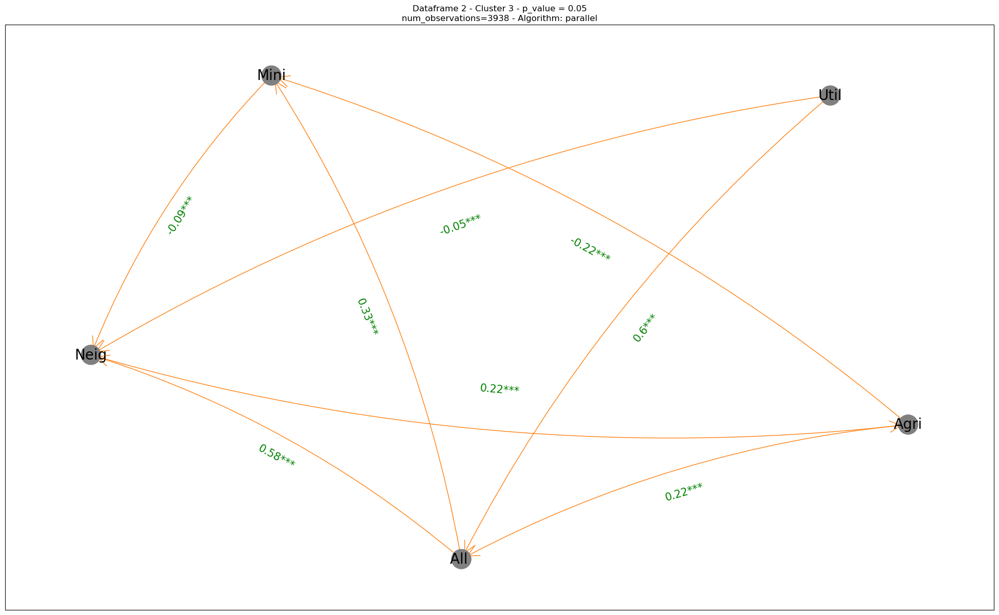

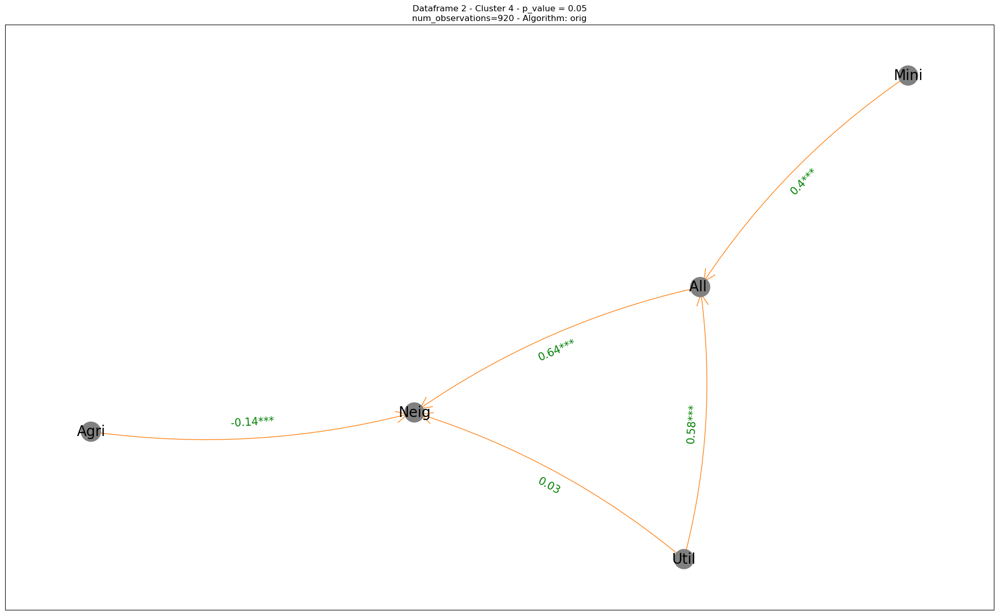

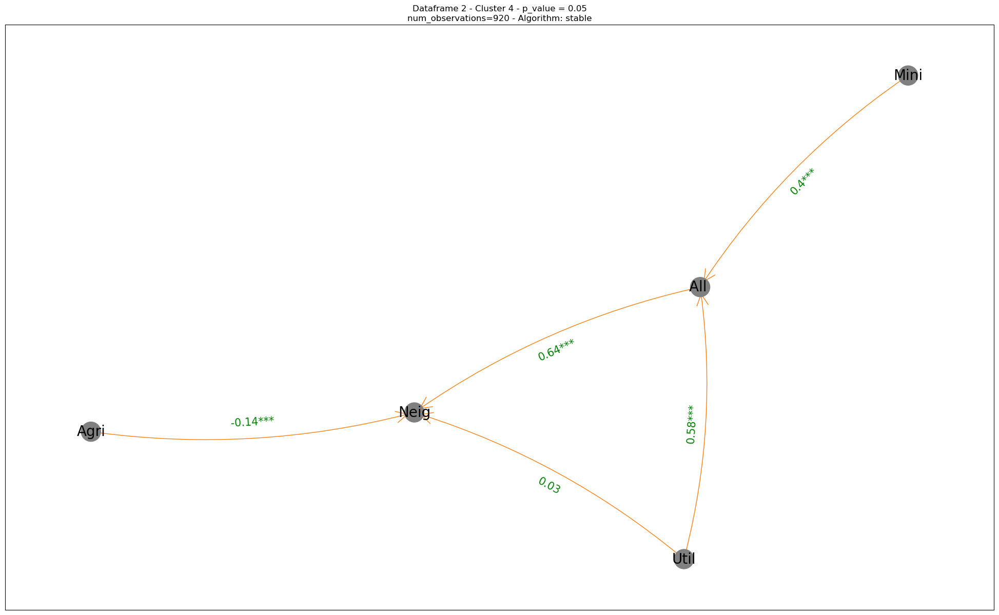

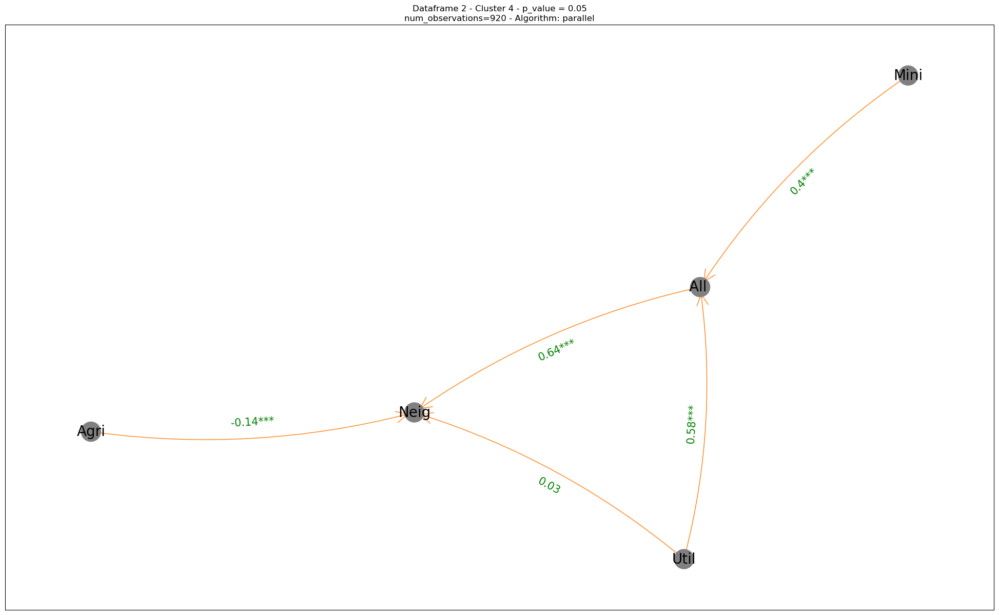

In [64]:
dataframes = [kml3d_cl_level, kml3d_cl_level2]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# List of algorithms
algorithms = ["orig", "stable", "parallel"]

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", fig=False, ax=False, edge_labels=False, sig_vals=[0.05, 0.01, 0.001], algorithm="parallel", pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if edge_labels == False:
        edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    if fig == False and ax == False:
        fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u,v]}\n\n\n{edge_labels[(v,u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u,v)]}'))
    edge_labels = dict(edge_labels2)
    curved_edges = [edge for edge in graph.edges() if reversed(edge) in graph.edges()]
    straight_edges = list(set(graph.edges()) - set(curved_edges))
    
    # Use nx.draw_networkx_edges with arrowsize to control arrowhead size
    nx.draw_networkx_edges(graph, pos=pos, ax=ax, edgelist=straight_edges,
                           width=1, edge_color="C1", arrowstyle="->", connectionstyle="arc3,rad=0.1", arrowsize=40)
    arc_rad = 0.31
    nx.draw_networkx(graph, pos=pos, node_color=color_map, node_size=750,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=20, alpha=1,
                     width=1, edge_color="C1",
                     ax=ax, edgelist=curved_edges, connectionstyle=f'arc3, rad = {arc_rad}',
                     arrowstyle="->", arrowsize=40)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=15,
                                 alpha=1,
                                 ax=ax)
    
    # Add title to the DAG
    ax.set_title(title + f" - Algorithm: {algorithm}")

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    
    # Specify the absolute path for the output PDF file
    pdf_file = os.path.abspath(f"DAGOutputs_{output_names[idx]}.pdf")
    pp = PdfPages(pdf_file)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
            , algorithm=algorithm, pp=pp)

    pp.close()


### Using different algorithms

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

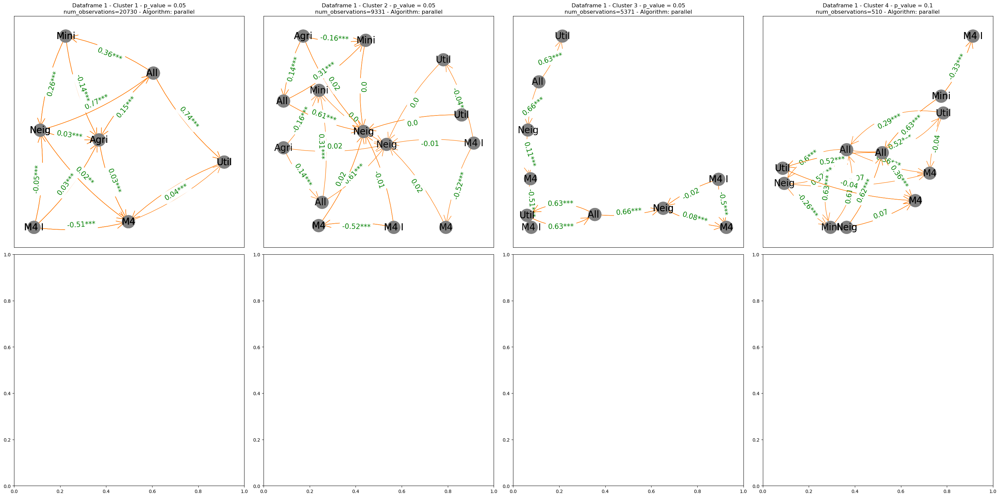

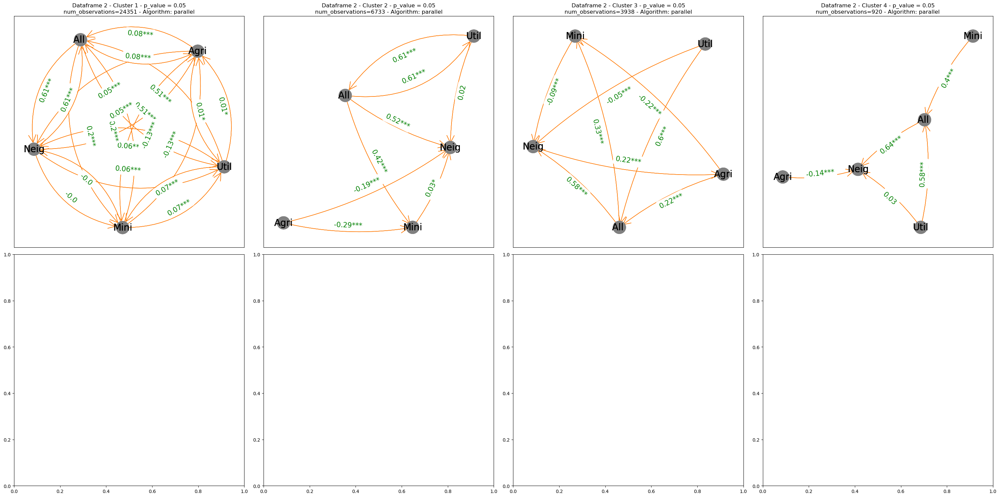

In [65]:
dataframes = [kml3d_cl_level, kml3d_cl_level2]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# List of algorithms
algorithms = ["orig", "stable", "parallel"]

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", fig=False, ax=False, edge_labels=False, sig_vals=[0.05, 0.01, 0.001], algorithm="parallel", pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if edge_labels == False:
        edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    if fig == False and ax == False:
        fig, ax = plt.subplots(figsize=(20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u,v]}\n\n\n{edge_labels[(v,u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u,v)]}'))
    edge_labels = dict(edge_labels2)
    curved_edges = [edge for edge in graph.edges() if reversed(edge) in graph.edges()]
    straight_edges = list(set(graph.edges()) - set(curved_edges))
    
    # Use nx.draw_networkx_edges with arrowsize to control arrowhead size
    nx.draw_networkx_edges(graph, pos=pos, ax=ax, edgelist=straight_edges,
                           width=1, edge_color="C1", arrowstyle="->", connectionstyle="arc3,rad=0.1", arrowsize=40)
    arc_rad = 0.31
    nx.draw_networkx(graph, pos=pos, node_color=color_map, node_size=750,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=20, alpha=1,
                     width=1, edge_color="C1",
                     ax=ax, edgelist=curved_edges, connectionstyle=f'arc3, rad = {arc_rad}',
                     arrowstyle="->", arrowsize=40)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=15,
                                 alpha=1,
                                 ax=ax)
    
    # Add title to the DAG
    ax.set_title(title + f" - Algorithm: {algorithm}")

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    
    # Specify the absolute path for the output PDF file
    pdf_file = f"DAGOutputs_{output_names[idx]}.pdf"
    pp = PdfPages(pdf_file)
    

    # Create a 2x4 grid for the plots
    fig, axes = plt.subplots(2, 4, figsize=(30, 15))
    axes = axes.flatten()

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, (cluster_df, ax) in enumerate(zip(clustered_dfs, axes)):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
            , algorithm=algorithm, pp=pp, ax=ax)
            
    pp.savefig(fig, bbox_inches='tight')        


    # Close the PDF after all plots are added
    pp.close()


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

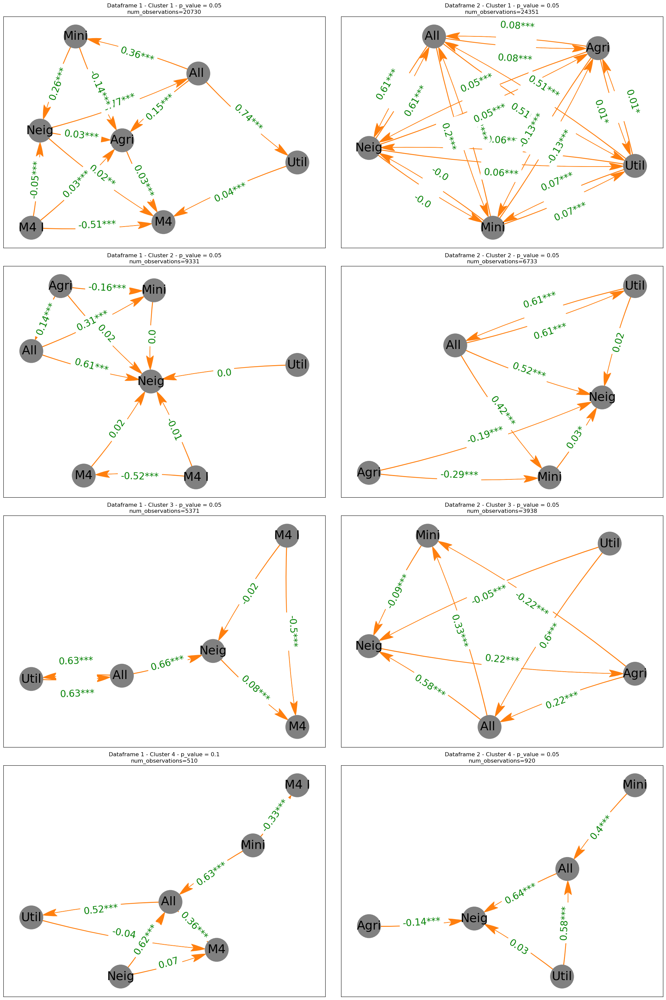

In [66]:
dataframes = [kml3d_cl_level, kml3d_cl_level2]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", algorithm="parallel", ax=None, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 12))

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph)

    edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u, v]}\n\n\n{edge_labels[(v, u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u, v)]}'))
    edge_labels = dict(edge_labels2)

    nx.draw_networkx(graph, pos, node_color=color_map, node_size=2500,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
                     arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=20,
                                 ax=ax)

    # Add title to the DAG
    ax.set_title(title)

    # Save to PDF if a PdfPages object is provided
#     if pp:
#         pp.savefig(ax.figure, bbox_inches='tight')

# Specify the absolute path for the output PDF file
pdf_file_path = os.path.abspath("DAGOutputs.pdf")
pp = PdfPages(pdf_file_path)

# Create a 4x2 grid for the subplots
fig, axes = plt.subplots(4, 2, figsize=(20, 30))

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        c = PC(cluster_df)
        model = c.estimate(return_type='pdag', variant='parallel', significance_level=p_value, ci_test='pearsonr')
        edges = model.edges

        # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
        graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
                  , algorithm="parallel", ax=axes[cluster_idx, idx], pp=pp)

# Save the figure to the PDF
pp.close()
plt.show()


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

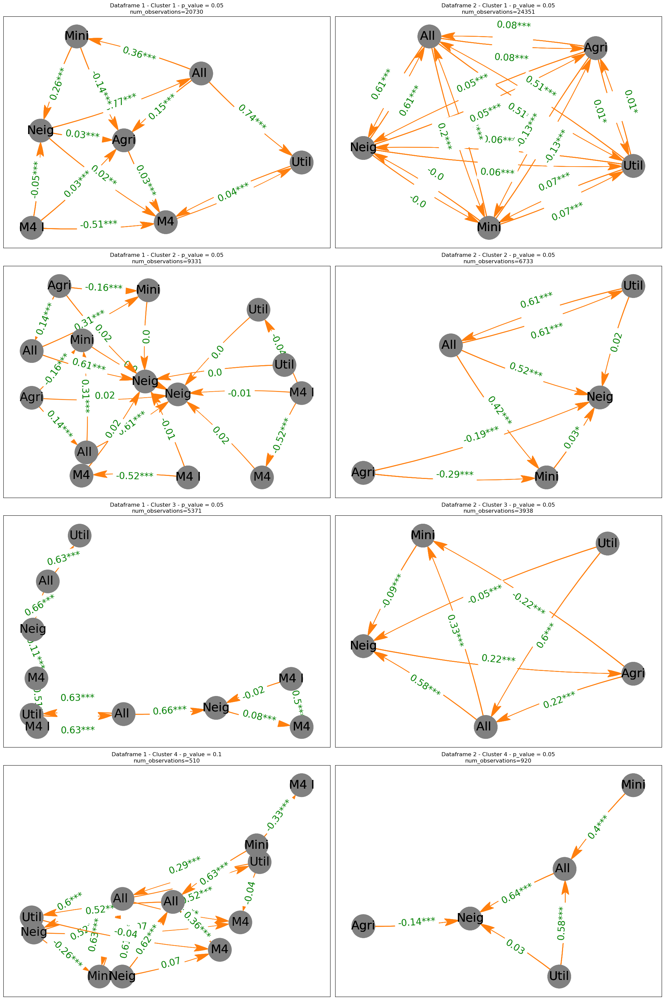

In [67]:
dataframes = [kml3d_cl_level, kml3d_cl_level2]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", algorithm="parallel", ax=None, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 12))

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph)

    edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u, v]}\n\n\n{edge_labels[(v, u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u, v)]}'))
    edge_labels = dict(edge_labels2)

    nx.draw_networkx(graph, pos, node_color=color_map, node_size=2500,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
                     arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=20,
                                 ax=ax)

    # Add title to the DAG
    ax.set_title(title)

#     # Save to PDF if a PdfPages object is provided
#     if pp:
#         pp.savefig(ax.figure, bbox_inches='tight')

# Specify the absolute path for the output PDF file
pdf_file = f"DAGOutputs_{output_names[idx]}.pdf"
pp = PdfPages(pdf_file_path)

# Create a 4x2 grid for the subplots
fig, axes = plt.subplots(4, 2, figsize=(20, 30))

# Different PC algorithms to test
algorithms = ["orig", "stable", "parallel"]

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different PC algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
                      , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)

# Save the figure to the PDF
pp.savefig(fig, bbox_inches='tight')

pp.close()
plt.show()


### Excluding neighbors

In [68]:
x = kml3d_cl_level.drop('Neig', axis=1)

In [69]:
y = kml3d_cl_level2.drop('Neig', axis=1)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

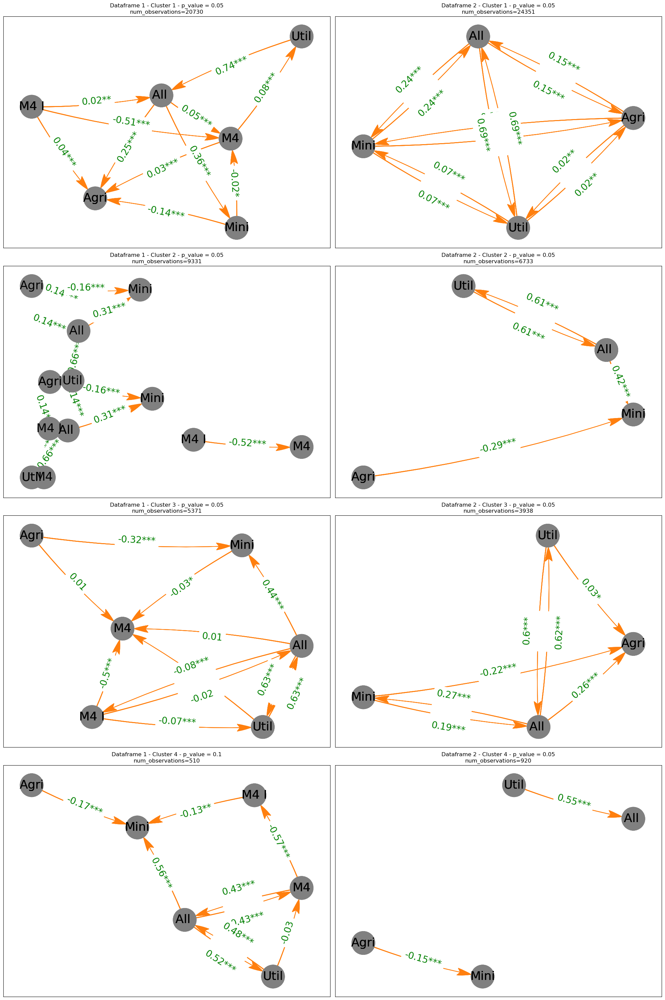

In [70]:
dataframes = [x, y]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", algorithm="parallel", ax=None, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 12))

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph)

    edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u, v]}\n\n\n{edge_labels[(v, u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u, v)]}'))
    edge_labels = dict(edge_labels2)

    nx.draw_networkx(graph, pos, node_color=color_map, node_size=2500,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
                     arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=20,
                                 ax=ax)

    # Add title to the DAG
    ax.set_title(title)

#     # Save to PDF if a PdfPages object is provided
#     if pp:
#         pp.savefig(ax.figure, bbox_inches='tight')

# Specify the absolute path for the output PDF file
pdf_file = f"DAGOutputs_{output_names[idx]}.pdf"
pp = PdfPages(pdf_file_path)

# Create a 4x2 grid for the subplots
fig, axes = plt.subplots(4, 2, figsize=(20, 30))

# Different PC algorithms to test
algorithms = ["orig", "stable", "parallel"]

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different PC algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
                      , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)

# Save the figure to the PDF
pp.savefig(fig, bbox_inches='tight')

pp.close()
plt.show()


Dataframe 1 = data including neighbors and M4 variables

Dataframe 2 = data including neighbors but without M4 variables

Dataframe 3 = data including M4 variables but without neighbors

Dataframe 4 = data without M4 variables and neighbors

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

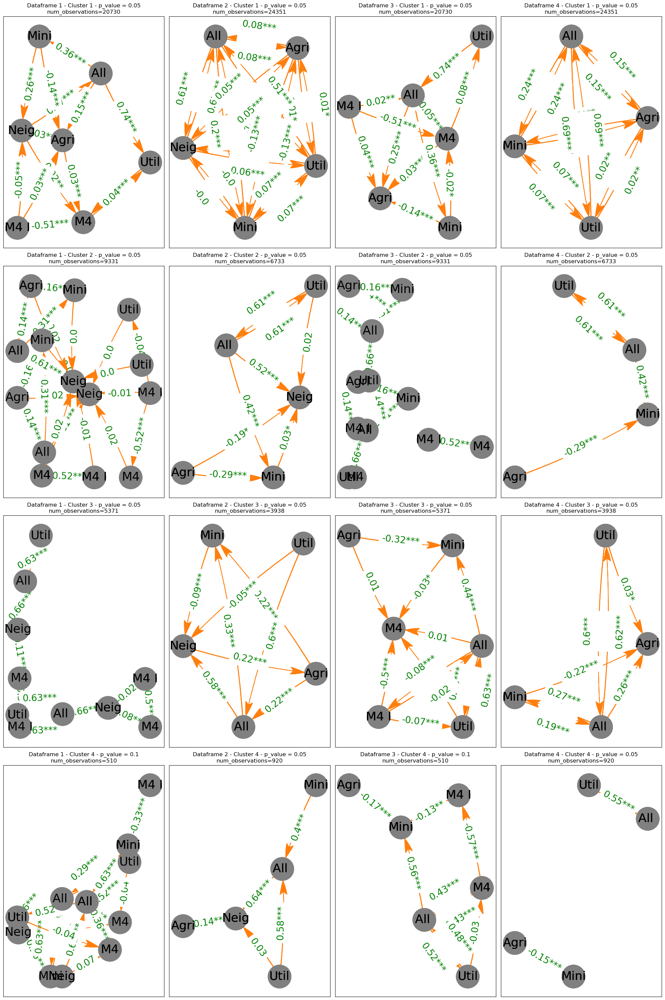

In [71]:
dataframes = [kml3d_cl_level, kml3d_cl_level2, x, y]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05, 0.1, 0.05]

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2', 'clusters_x', 'clusters_y']


# Specify the absolute path for the output PDF file
pdf_file_path = "DAGOutputs_combined.pdf"
pp = PdfPages(pdf_file_path)

# Create a 4x4 grid for the subplots
fig, axes = plt.subplots(4, 4, figsize=(20, 30))

# Different PC algorithms to test
algorithms = ["orig", "stable", "parallel"]

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different PC algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
                      , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)

# Save the figure to the PDF
pp.savefig(fig, bbox_inches='tight')

pp.close()
plt.show()


Dataframe1 = Includes neighbor

Dataframe2 = Includes m4 variables

Dataframe3 = includes all variables except m4 and neigh

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

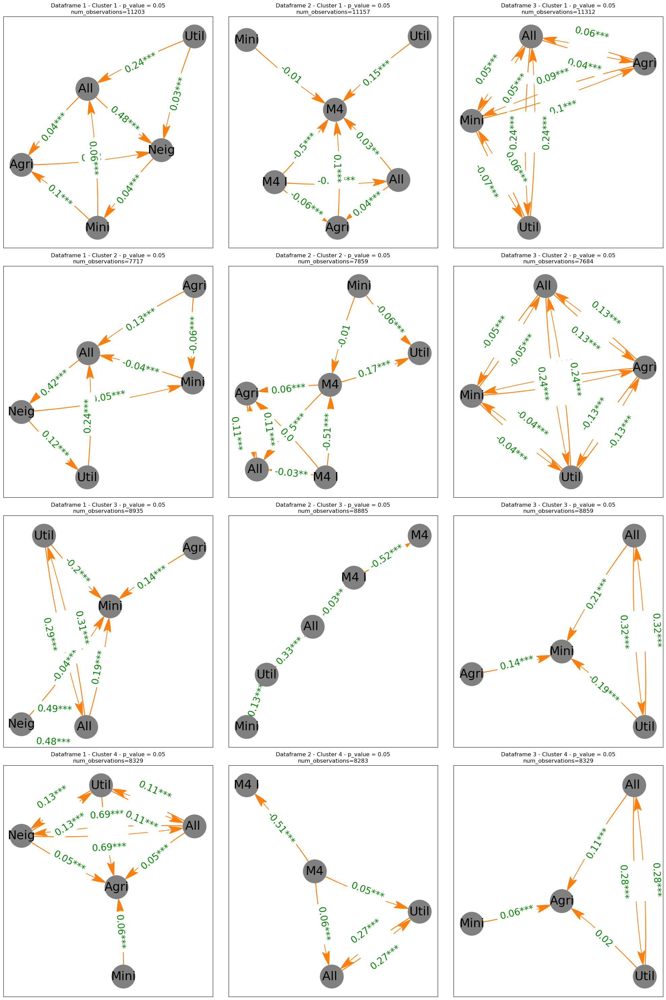

In [72]:
dataframes = [kml3d_cl_level3, kml3d_cl_level5, kml3d_cl_level4]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05, 0.1, 0.05]

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2', 'clusters_x']


# Specify the absolute path for the output PDF file
pdf_file_path = "DAGOutputs_combined1.pdf"
pp = PdfPages(pdf_file_path)

# Create a 4x4 grid for the subplots
fig, axes = plt.subplots(4, 3, figsize=(20, 30))

# Different PC algorithms to test
algorithms = ["orig"]

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different PC algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
                      , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)

# Save the figure to the PDF
pp.savefig(fig, bbox_inches='tight')

pp.close()
plt.show()


In [73]:
png_file_path = f"{output_names[idx]}_{cluster_idx + 1}.jpeg"
fig.savefig(png_file_path, bbox_inches='tight')


In [74]:
edges_dct = {}
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    edges_dct[idx] = {}
    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different data for PC algorithm
#         for algorithm in algorithms:
        algorithm = "orig"
        c = PC(cluster_df)
        model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
        edges = model.edges
        edges = list(set([tuple(sorted(edge)) for edge in edges]))
        edges_dct[idx][cluster_idx] = edges
#             # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
#             graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
#                       , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)
edges_dct

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

{0: {0: [('Agri', 'Neig'),
   ('Neig', 'Util'),
   ('Agri', 'All '),
   ('Agri', 'Mini'),
   ('Mini', 'Neig'),
   ('All ', 'Neig'),
   ('All ', 'Util'),
   ('All ', 'Mini')],
  1: [('Neig', 'Util'),
   ('Agri', 'All '),
   ('Agri', 'Mini'),
   ('Mini', 'Neig'),
   ('All ', 'Neig'),
   ('All ', 'Util'),
   ('All ', 'Mini')],
  2: [('Agri', 'Mini'),
   ('Mini', 'Neig'),
   ('Mini', 'Util'),
   ('All ', 'Neig'),
   ('All ', 'Util'),
   ('All ', 'Mini')],
  3: [('Agri', 'Neig'),
   ('Neig', 'Util'),
   ('Agri', 'Util'),
   ('Agri', 'All '),
   ('Agri', 'Mini'),
   ('All ', 'Neig'),
   ('All ', 'Util')]},
 1: {0: [('M4', 'Util'),
   ('M4', 'M4 I'),
   ('M4', 'Mini'),
   ('Agri', 'All '),
   ('Agri', 'M4 I'),
   ('All ', 'M4'),
   ('All ', 'M4 I'),
   ('Agri', 'M4')],
  1: [('M4', 'Util'),
   ('M4', 'M4 I'),
   ('M4', 'Mini'),
   ('Agri', 'All '),
   ('Agri', 'M4 I'),
   ('All ', 'M4'),
   ('Mini', 'Util'),
   ('All ', 'M4 I'),
   ('Agri', 'M4')],
  2: [('All ', 'M4 I'), ('All ', 'Util'), ('

In [75]:
edges

[('Agri', 'Mini'), ('All ', 'Util'), ('Agri', 'Util'), ('Agri', 'All ')]

In [76]:
cols = list(edges_dct.keys())
rows = list(edges_dct[0].keys())

col_shared_edges = {}
row_shared_edges = {}
for col in cols:
    for row, edges in edges_dct[col].items():
        if row == 0: col_shared_edges[col] = copy.copy(edges)
        col_shared_edges[col]  = [edge for edge in edges if edge in col_shared_edges[col] ]
        
col_shared_edges

{0: [('Agri', 'Mini'), ('All ', 'Neig'), ('All ', 'Util')],
 1: [('M4', 'M4 I')],
 2: [('Agri', 'Mini'), ('All ', 'Util')]}

In [77]:
col_shared_edges.items()

dict_items([(0, [('Agri', 'Mini'), ('All ', 'Neig'), ('All ', 'Util')]), (1, [('M4', 'M4 I')]), (2, [('Agri', 'Mini'), ('All ', 'Util')])])

In [78]:
cols = list(edges_dct.keys())
rows = list(edges_dct[0].keys())

col_shared_edges = {}
row_shared_edges = {}
for col in cols:
    for row, edges in edges_dct[col].items():
        if row == 0: col_shared_edges[col] = copy.copy(edges)
        col_shared_edges[col] = [edge for edge in col_shared_edges[col] if edge in edges]

col_shared_edges

{0: [('Agri', 'Mini'), ('All ', 'Neig'), ('All ', 'Util')],
 1: [('M4', 'M4 I')],
 2: [('Agri', 'Mini'), ('All ', 'Util')]}

In [79]:
type(col_shared_edges)

dict

In [80]:
# G = nx.from_edgelist(lst)

In [81]:
for row in rows:
    row_shared_edges[row] = {}
    for col in cols:
        if col == 0: row_shared_edges[row] = edges_dct[col][row]
        row_shared_edges[row] = [edge for edge in edges if edge in row_shared_edges[row]]
row_shared_edges

{0: [('Agri', 'Mini'), ('All ', 'Util'), ('Agri', 'All ')],
 1: [('Agri', 'Mini'), ('All ', 'Util'), ('Agri', 'All ')],
 2: [('Agri', 'Mini'), ('All ', 'Util')],
 3: [('Agri', 'Mini'), ('All ', 'Util'), ('Agri', 'Util'), ('Agri', 'All ')]}

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/networkx/drawing/nx_pylab.py:304: UserWarning: 

The connectionstyle keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default value for connectionstyle.
Note that using FancyArrowPatches may be slow for large graphs.

  draw_networkx_edges(G, pos, arrows=arrows, **edge_kwds)


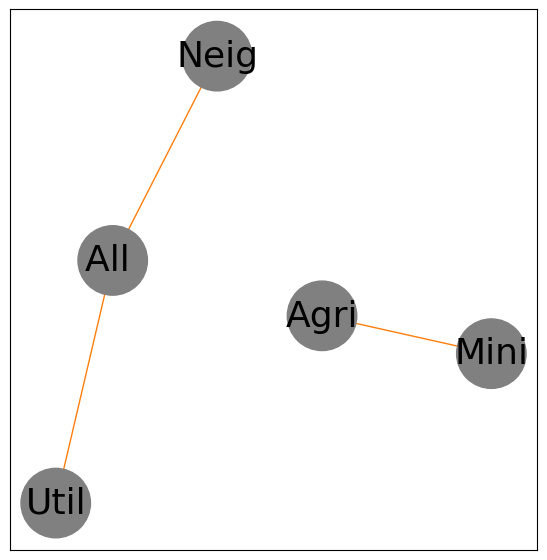

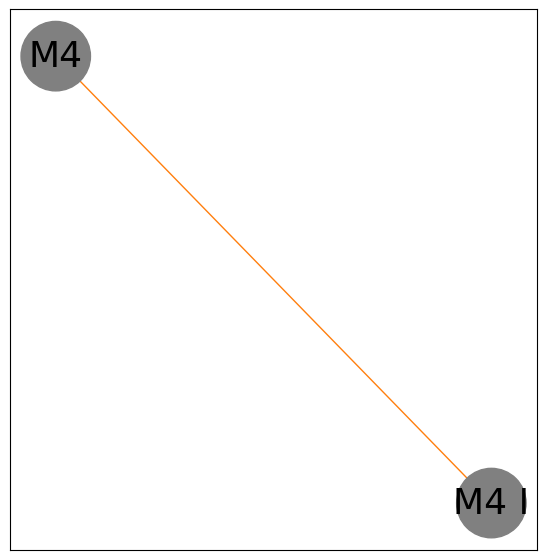

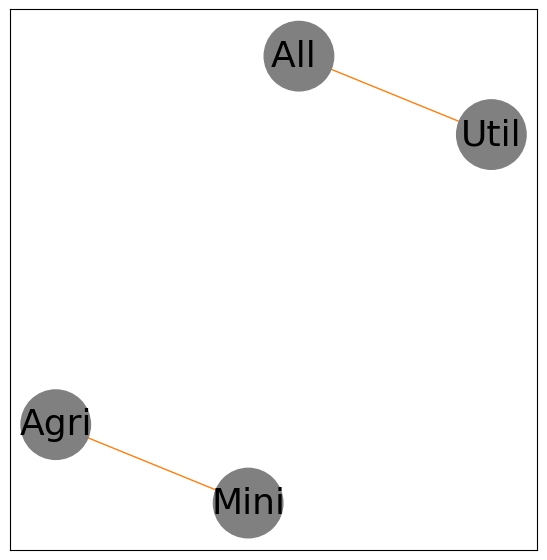

In [82]:

for key, lst in col_shared_edges.items():
    fig,ax = plt.subplots(figsize = (6, 6))
    G = nx.from_edgelist(lst)
    G.nodes()
    color_map = ["grey" for g in G]
    plt.tight_layout()
    pos = graphviz_layout(G)
    nx.draw_networkx(G, pos, node_color=color_map, node_size=2500,
#                      with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
#                      arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
plt.show()

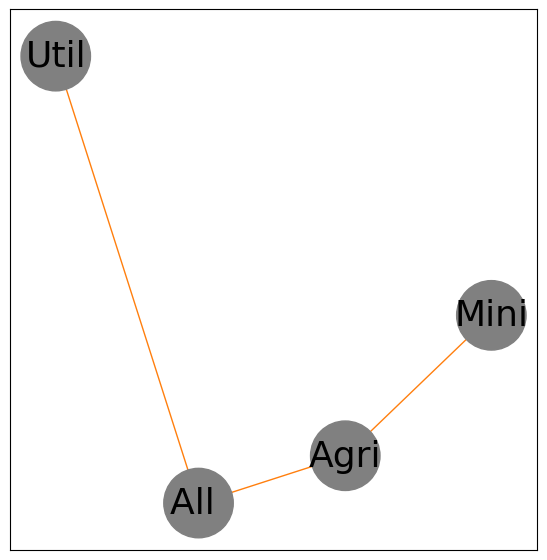

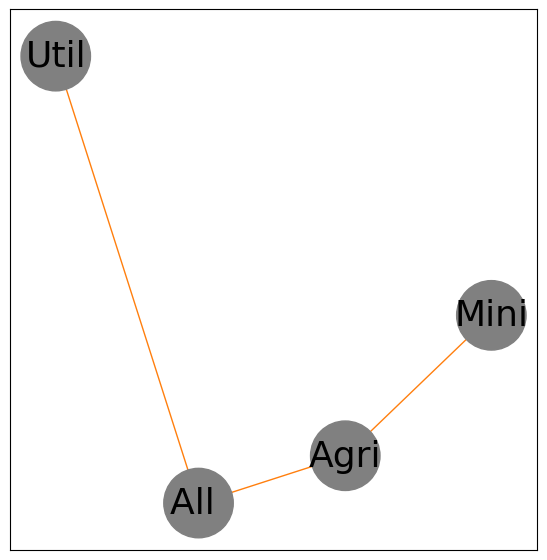

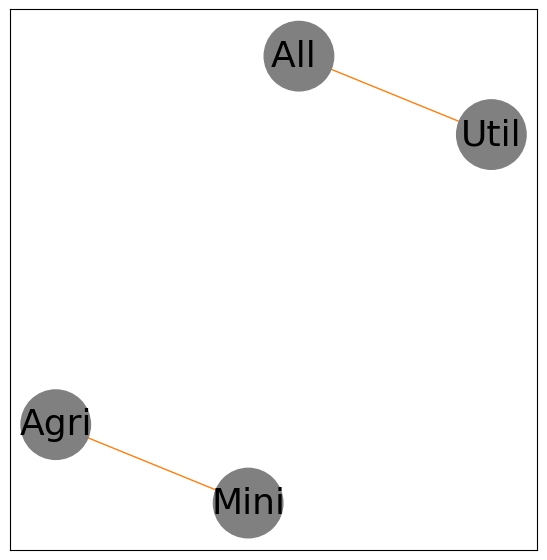

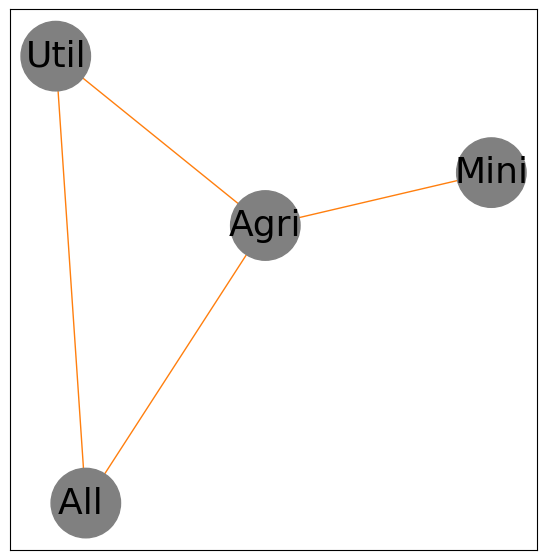

In [83]:
for key, lst in row_shared_edges.items():
    fig,ax = plt.subplots(figsize = (6, 6))
    G = nx.from_edgelist(lst)
    G.nodes()
    color_map = ["grey" for g in G]
    plt.tight_layout()
    pos = graphviz_layout(G)
    nx.draw_networkx(G, pos, node_color=color_map, node_size=2500,
#                      with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
#                      arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
plt.show()

Consistent causal relationship between agric and mining, total gdp and util in dataframe 1 and 3
When macro variables are included, it appears that the only consistent relationship are the macro variables.Indicating an intermidiary between these variables and other economic variables

For clusters;
cluster1- consistent relationship between utilities and total gdp; total gdp and agric; and agric and minining

cluster2- same relationship as in cluster1

cluster3- exactly similar relationship as dataframe 1

cluster4- consistent relationship between mining and agric; utilities, total gdp and agric

When the macro variables are included, the causal relationships amongst other variables are somewhat hidden within the macro variables (i.e, they act as an intermediary)

Clusters on the otherhand, do not appear to have any effects of the macro variables being included or not

In [84]:
plot_df = rates_data.dropna()

  0%|          | 0/5 [00:00<?, ?it/s]

('M4', 'Util') []
keep control: M4 I
keep control: Util
('M4', 'Neig') ['M4 I', 'Util']
keep control: M4 I
keep control: M4
('Util', 'Neig') ['M4 I', 'M4']
keep control: All 
keep control: Mini
('Util', 'Agri') ['All ', 'Mini']
keep control: Neig
('Util', 'All ') ['Neig']
keep control: Util
('Neig', 'All ') ['Util']
('All ', 'Mini') []
keep control: Mini
keep control: Util
('All ', 'Agri') ['Mini', 'Util']
keep control: All 
keep control: Util
('Mini', 'Agri') ['All ', 'Util']
('M4 I', 'M4') []
keep control: Util
keep control: M4
('M4 I', 'Neig') ['Util', 'M4']


OutEdgeView([('M4', 'Util'), ('M4', 'Neig'), ('Util', 'Neig'), ('Util', 'Agri'), ('Util', 'All '), ('Neig', 'All '), ('All ', 'Mini'), ('All ', 'Agri'), ('Mini', 'Agri'), ('M4 I', 'M4'), ('M4 I', 'Neig')])

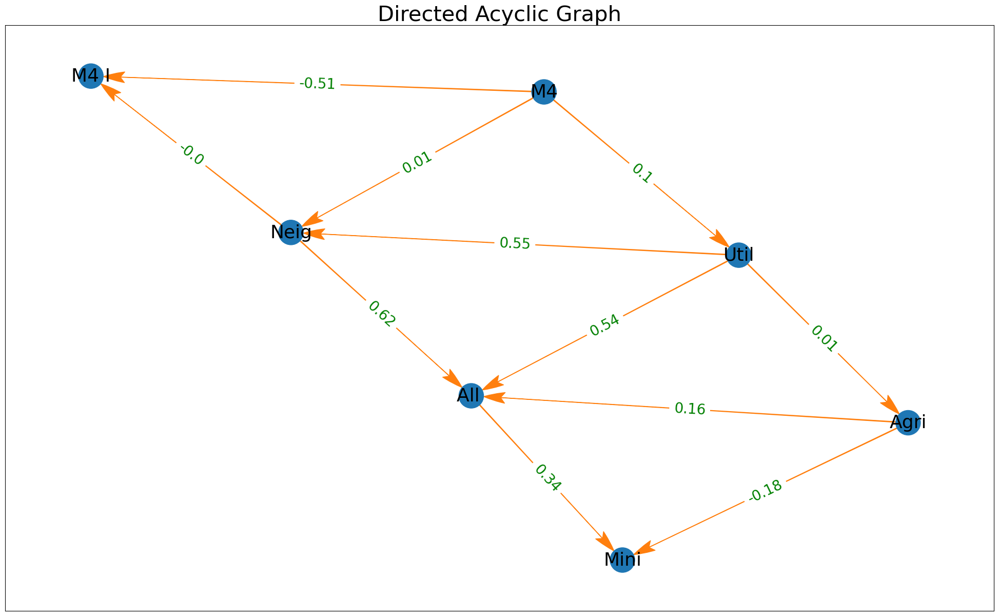

In [85]:
from matplotlib.patches import ArrowStyle
import copy
from matplotlib.backends.backend_pdf import PdfPages

undirected_graph = {key:[] for key in plot_df.keys()}
for x in undirected_graph:
    remaining_vars = [y for y in plot_df.keys() if y != x]
    for y in remaining_vars:
        undirected_graph[x].append(y)

p_value = .01
import matplotlib.pyplot as plt
import networkx as nx
from pgmpy.estimators import PC
c = PC(plot_df)
max_cond_vars = len(plot_df.keys()) - 2

model = c.estimate(return_type = 'pdag', variant= 'parallel', significance_level = p_value,
                  max_cond_vars = max_cond_vars, ci_test = 'pearsonr')
edges = model.edges

pp = PdfPages("DAGOutputs_full_rates.pdf")

def graph_DAG(edges, df, title = ""):
    graph = nx.Graph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.keys() if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]]+keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]],2))
    graph.add_edges_from(edges)
    color_map = ['C0' for g in graph]
    
    fig, ax = plt.subplots(figsize = (20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)
    
    plt.title(title, fontsize = 30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                    arrows=True, font_color ='k', font_size=26, alpha=1, width = 1,
                    edge_color = 'C1',
                     arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax = ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)
    pp.savefig(fig, bbox_inches = "tight")

graph_DAG(edges, plot_df, title = 'Directed Acyclic Graph')


pp.close()                                                            
edges

In [86]:
unemploy = pd.read_csv('unemployment_rates_by county.csv')

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/3123405110.py:1: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  unemploy = pd.read_csv('unemployment_rates_by county.csv')


In [87]:
unemploy

,series_id,year,period,value,footnote_codes,county,code
0,LAUCN010010000000003,1990,M01,6.5,NaN,1001,3
1,LAUCN010010000000003,1990,M02,6.5,NaN,1001,3
2,LAUCN010010000000003,1990,M03,5.7,NaN,1001,3
3,LAUCN010010000000003,1990,M04,6.6,NaN,1001,3
4,LAUCN010010000000003,1990,M05,6.0,NaN,1001,3
...,...,...,...,...,...,...,...
1415836,LAUCN721530000000003,2023,M07,12.0,NaN,72153,3
1415837,LAUCN721530000000003,2023,M08,10.8,NaN,72153,3
1415838,LAUCN721530000000003,2023,M09,9.9,NaN,72153,3
1415839,LAUCN721530000000003,2023,M10,9.8,NaN,72153,3


In [88]:
df = unemploy

In [89]:
df = df.rename(columns= {'       value':'unemp'})

In [90]:
# Replace non-numeric values with NaN
df['unemp'] = pd.to_numeric(df['unemp'], errors='coerce')

In [91]:
# Calculate the average value per year for each county
avg_unemp = df.groupby(['year', 'county'])['unemp'].mean().reset_index()

In [92]:
avg_unemp = avg_unemp.rename(columns={'year':'TimePeriod', 'county':'FIPS_y'})

In [93]:
rates_data_unemp = pd.merge(rates_data, avg_unemp, on=['TimePeriod', 'FIPS_y'], how='left')

In [94]:
rates_data_unemp = rates_data_unemp.set_index(['FIPS_y', 'TimePeriod'])

In [95]:
rates_data_unemp

Agri       All        Mini       Util       Neig  \
FIPS_y  TimePeriod                                                          
1001.0  2001        10.019269  13.764007   8.443331  10.048497  16.547168   
        2002         9.801621  13.799421   8.023880  10.884067  16.562177   
        2003        10.595159  13.823510   8.215006  10.952139  16.590304   
        2004        10.817836  13.972752   8.685585  11.457180  16.646015   
        2005        10.986969  13.993924   8.924390  11.217587  16.688909   
...                       ...        ...        ...        ...        ...   
56045.0 2016         9.537556  12.629528  10.467238   6.635947  16.472590   
        2017         9.898525  12.614563  10.457717   6.609349  16.441328   
        2018        10.076894  12.661381  10.664387   6.674561  16.444573   
        2019         9.560575  12.684094  10.873944   6.870053  16.471744   
        2020         9.065661  12.652888  10.539165   6.774224  16.408853   

                          M4      M4 I     unemp  
FIPS_y  TimePeriod                                
1001.0  2001        6.736434 -4.397289  4.138462  
        2002        6.792146 -4.904205  4.807692  
        2003        6.840895 -4.716596  5.000000  
        2004        6.895184 -3.868532  4.715385  
        2005        6.951425 -3.430044  3.784615  
...                      ...       ...       ...  
56045.0 2016        7.294414 -5.774800  5.007692  
        2017        7.337503 -4.985560  4.084615  
        2018        7.390222 -4.775628  3.538462  
        2019        7.598548 -6.198269  2.992308  
        2020        7.696291 -7.569180  3.869231  

[45553 rows x 8 columns]

In [145]:
ai_data = pd.read_csv('ai_data.csv')

In [146]:
ai_data_nominal = pd.read_csv('nominal_data.csv')

In [147]:
ai_data_real = pd.read_csv('real_data.csv')

In [97]:
ai_data = ai_data.set_index(['FIPS_y', 'TimePeriod'])

In [148]:
ai_data_nominal = ai_data_nominal.set_index(['FIPS_y', 'TimePeriod'])

In [149]:
ai_data_real = ai_data_real.set_index(['FIPS_y', 'TimePeriod'])

In [98]:
ai_data.columns

Index(['Agri', 'Mini', 'Util', 'All ', 'Neig', 'M4_y', 'RM4I', 'unem'], dtype='object')

In [150]:
ai_data_nominal.columns

Index(['Agri', 'Mini', 'Util', 'All ', 'M4_y', 'M4 I', 'Neig', 'unem'], dtype='object')

In [151]:
ai_data_real.columns

Index(['Agri', 'Mini', 'Util', 'All ', 'RM4_', 'RM4I', 'Neig', 'unem'], dtype='object')

In [152]:
exclude_vars = ['M4 I','RM4I', 'unem']  # List of variables to exclude

# Create a dictionary to store the dataframes
ai_dct = {"logged": ai_data.copy(), "logged_n": ai_data_nominal.copy(), "logged_r": ai_data_real.copy(), 
          "rates": ai_data.copy(),"rates_n": ai_data_nominal.copy(), "rates_r": ai_data_real.copy(),
         "percent rates": ai_data.copy(),"percent rates_n": ai_data_nominal.copy(), 
          "percent rates_r": ai_data_real.copy()}

# Log-transform all variables except those in exclude_vars
for col in ai_dct['logged'].columns:
    if col not in exclude_vars:
        ai_dct["logged"][col] = np.log(ai_data[col]).replace([np.inf, -np.inf], np.nan)
        
for col in ai_dct['logged_n'].columns:
    if col not in exclude_vars:
        ai_dct["logged_n"][col] = np.log(ai_data_nominal[col]).replace([np.inf, -np.inf], np.nan)

for col in ai_dct['logged_r'].columns:
    if col not in exclude_vars:
        ai_dct["logged_r"][col] = np.log(ai_data_real[col]).replace([np.inf, -np.inf], np.nan)


# Calculate rate of change (differences of log-transformed values)
for col in ai_dct['rates'].columns:
    if col not in exclude_vars:
        ai_dct["rates"][col] = ai_dct["logged"].groupby('FIPS_y')[col].diff().dropna()

        
for col in ai_dct['rates_n'].columns:
    if col not in exclude_vars:
        ai_dct["rates_n"][col] = ai_dct["logged_n"].groupby('FIPS_y')[col].diff().dropna()
        
        

for col in ai_dct['rates_r'].columns:
    if col not in exclude_vars:
        ai_dct["rates_r"][col] = ai_dct["logged_r"].groupby('FIPS_y')[col].diff().dropna()
        
        
        # Calculate percent rate of change
for col in ai_dct['percent rates'].columns:
    if col not in exclude_vars:
        ai_dct["percent rates"][col] = ai_dct["rates"].groupby('FIPS_y')[col].diff().dropna()

        
for col in ai_dct['percent rates_n'].columns:
    if col not in exclude_vars:
        ai_dct["percent rates_n"][col] = ai_dct["rates_n"].groupby('FIPS_y')[col].diff().dropna()

        
        
for col in ai_dct['percent rates_r'].columns:
    if col not in exclude_vars:
        ai_dct["percent rates_r"][col] = ai_dct["rates_r"].groupby('FIPS_y')[col].diff().dropna()

        
        

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [153]:
ai_data1 = ai_dct['rates']

In [176]:
nominal = ai_dct['rates_n']

In [177]:
nominal

Agri      Mini      Util      M4_y      M4 I      unem
FIPS_y  TimePeriod                                                            
1001.0  2001             NaN       NaN       NaN       NaN  0.012311  4.138462
        2002       -0.217648 -0.419451  0.835570  0.055668  0.007415  4.807692
        2003        0.793538  0.191126  0.068072  0.048754  0.008946  5.000000
        2004        0.222678  0.470578  0.505041  0.054306  0.020890  4.715385
        2005        0.169133  0.238805 -0.239593  0.056279  0.032386  3.784615
...                      ...       ...       ...       ...       ...       ...
56045.0 2016       -0.209103 -0.018912 -0.193847  0.043399  0.003105  5.007692
        2017        0.360970 -0.009520 -0.026597  0.043091  0.006836  4.084615
        2018        0.178369  0.206669  0.065212  0.052718  0.008433  3.538462
        2019       -0.516320  0.209558  0.195492  0.208378  0.002033  2.992308
        2020       -0.494913 -0.334780 -0.095830  0.097720  0.000516  3.869231

[61740 rows x 6 columns]

In [186]:
nominal.drop(columns=['All ', 'Neig'], inplace=True)

In [187]:
diff_nominal = ai_dct['percent rates_n']

In [188]:
diff_nominal.drop(columns=['All ', 'Neig'], inplace=True)

In [189]:
real = ai_dct['rates_r']

In [190]:
real.drop(columns=['All ', 'Neig'], inplace=True)

In [191]:
diff_real = ai_dct['percent rates_r']

In [192]:
diff_real.drop(columns=['All ', 'Neig'], inplace=True)

In [197]:
nominal.to_csv('nominal.csv', index=True)
diff_nominal.to_csv('diff_nominal.csv', index=True)
real.to_csv('real.csv', index=True)
diff_real.to_csv('diff_real.csv', index=True)

In [101]:
ai_data1.to_csv('ai_data1.csv', index=True)

In [102]:
plot_df = ai_dct['rates'].dropna()

  0%|          | 0/6 [00:00<?, ?it/s]

('unem', 'RM4I') []
('unem', 'M4_y') []
keep control: All 
keep control: Agri
('Mini', 'Neig') ['All ', 'Agri']
keep control: Neig
('Mini', 'Agri') ['Neig']
keep control: Neig
('Mini', 'All ') ['Neig']
keep control: Mini
('Neig', 'All ') ['Mini']
keep control: Mini
('Neig', 'Agri') ['Mini']
keep control: All 
keep control: Mini
('Agri', 'Neig') ['All ', 'Mini']
keep control: Mini
keep control: Agri
('All ', 'Neig') ['Mini', 'Agri']
('All ', 'Mini') []


OutEdgeView([('unem', 'RM4I'), ('unem', 'M4_y'), ('Mini', 'Neig'), ('Mini', 'Agri'), ('Mini', 'All '), ('Neig', 'All '), ('Neig', 'Agri'), ('Agri', 'Neig'), ('All ', 'Neig'), ('All ', 'Mini')])

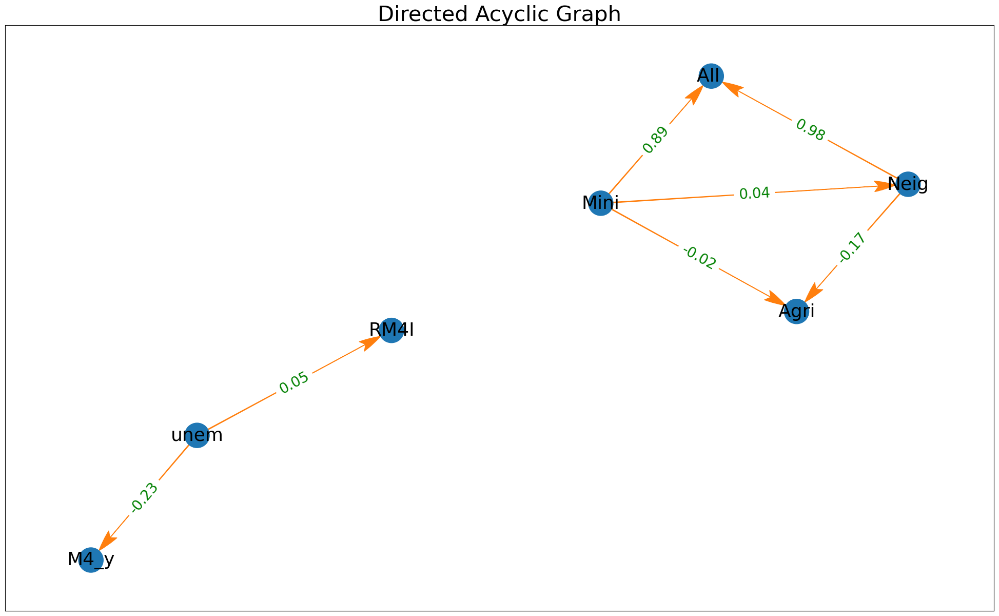

In [103]:
undirected_graph = {key:[] for key in plot_df.keys()}
for x in undirected_graph:
    remaining_vars = [y for y in plot_df.keys() if y != x]
    for y in remaining_vars:
        undirected_graph[x].append(y)

p_value = .01
import matplotlib.pyplot as plt
import networkx as nx
from pgmpy.estimators import PC
c = PC(plot_df)
max_cond_vars = len(plot_df.keys()) - 2

model = c.estimate(return_type = 'pdag', variant= 'parallel', significance_level = p_value,
                  max_cond_vars = max_cond_vars, ci_test = 'pearsonr')
edges = model.edges

pp = PdfPages("DAGs_rates_all.pdf")

def graph_DAG(edges, df, title = ""):
    graph = nx.Graph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.keys() if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]]+keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]],2))
    graph.add_edges_from(edges)
    color_map = ['C0' for g in graph]
    
    fig, ax = plt.subplots(figsize = (20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)
    
    plt.title(title, fontsize = 30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                    arrows=True, font_color ='k', font_size=26, alpha=1, width = 1,
                    edge_color = 'C1',
                     arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax = ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)
    pp.savefig(fig, bbox_inches = "tight")

graph_DAG(edges, plot_df, title = 'Directed Acyclic Graph')


pp.close()                                                            
edges

In [104]:
plot_df.columns

Index(['Agri', 'Mini', 'Util', 'All ', 'Neig', 'M4_y', 'RM4I', 'unem'], dtype='object')

In [105]:
plot_df.rename(columns={'All ':'All'},
                    inplace = True)

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/3095778731.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_df.rename(columns={'All ':'All'},


In [106]:
col_to_drop = ['All']

In [107]:
plot_df.drop(columns=col_to_drop, inplace=True)

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/623644120.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_df.drop(columns=col_to_drop, inplace=True)


  0%|          | 0/5 [00:00<?, ?it/s]

('Agri', 'Neig') []
('Neig', 'Util') []
('Neig', 'Mini') []
('Mini', 'Agri') []
('unem', 'RM4I') []
('unem', 'M4_y') []


OutEdgeView([('Agri', 'Neig'), ('Neig', 'Util'), ('Neig', 'Mini'), ('Mini', 'Agri'), ('unem', 'RM4I'), ('unem', 'M4_y')])

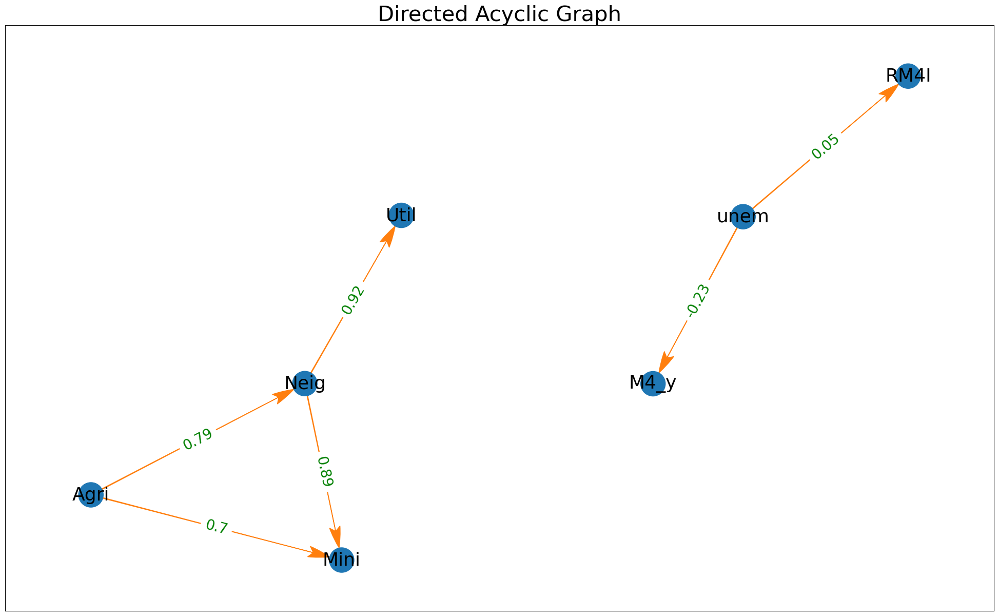

In [108]:
undirected_graph = {key:[] for key in plot_df.keys()}
for x in undirected_graph:
    remaining_vars = [y for y in plot_df.keys() if y != x]
    for y in remaining_vars:
        undirected_graph[x].append(y)

p_value = .01
import matplotlib.pyplot as plt
import networkx as nx
from pgmpy.estimators import PC
c = PC(plot_df)
max_cond_vars = len(plot_df.keys()) - 2

model = c.estimate(return_type = 'pdag', variant= 'parallel', significance_level = p_value,
                  max_cond_vars = max_cond_vars, ci_test = 'pearsonr')
edges = model.edges

pp = PdfPages("DAGs_rates_no_all.pdf")

def graph_DAG(edges, df, title = ""):
    graph = nx.Graph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.keys() if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]]+keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]],2))
    graph.add_edges_from(edges)
    color_map = ['C0' for g in graph]
    
    fig, ax = plt.subplots(figsize = (20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)
    
    plt.title(title, fontsize = 30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                    arrows=True, font_color ='k', font_size=26, alpha=1, width = 1,
                    edge_color = 'C1',
                     arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax = ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)
    pp.savefig(fig, bbox_inches = "tight")

graph_DAG(edges, plot_df, title = 'Directed Acyclic Graph')


pp.close()                                                            
edges

In [109]:
col_to_drop = ['Neig']

In [110]:
plot_df.drop(columns=col_to_drop, inplace=True)

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/623644120.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_df.drop(columns=col_to_drop, inplace=True)


  0%|          | 0/4 [00:00<?, ?it/s]

keep control: Mini
('Agri', 'Util') ['Mini']
keep control: Util
('Agri', 'Mini') ['Util']
keep control: Agri
('Util', 'Mini') ['Agri']
('unem', 'RM4I') []
('unem', 'M4_y') []
('RM4I', 'Agri') []
keep control: Agri
('Mini', 'Util') ['Agri']


OutEdgeView([('Agri', 'Util'), ('Agri', 'Mini'), ('Util', 'Mini'), ('unem', 'RM4I'), ('unem', 'M4_y'), ('RM4I', 'Agri'), ('Mini', 'Util')])

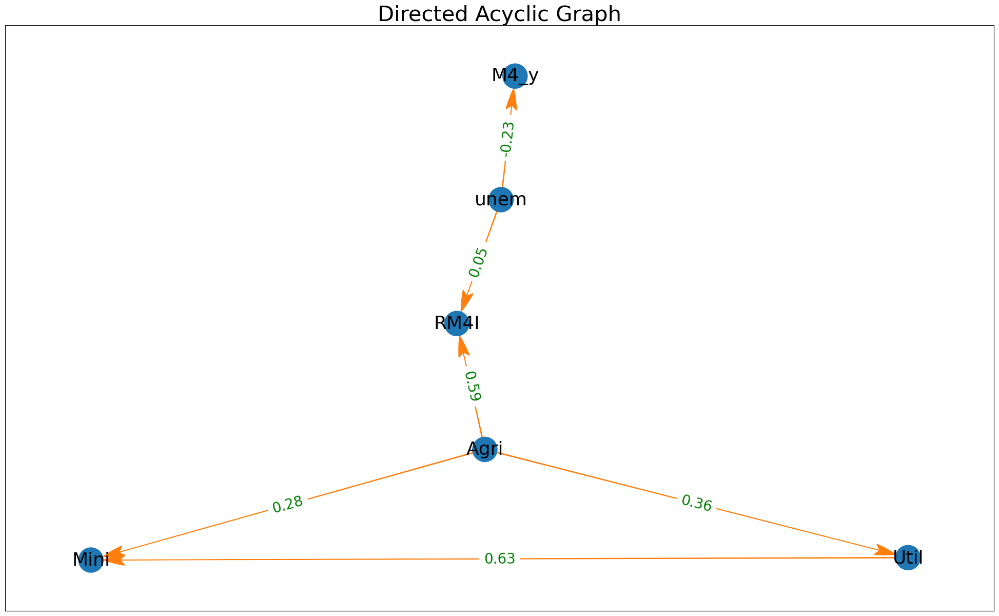

In [111]:
undirected_graph = {key:[] for key in plot_df.keys()}
for x in undirected_graph:
    remaining_vars = [y for y in plot_df.keys() if y != x]
    for y in remaining_vars:
        undirected_graph[x].append(y)

p_value = .01
import matplotlib.pyplot as plt
import networkx as nx
from pgmpy.estimators import PC
c = PC(plot_df)
max_cond_vars = len(plot_df.keys()) - 2

model = c.estimate(return_type = 'pdag', variant= 'parallel', significance_level = p_value,
                  max_cond_vars = max_cond_vars, ci_test = 'pearsonr')
edges = model.edges

pp = PdfPages("DAGs_rates_no_all_no neigh.pdf")

def graph_DAG(edges, df, title = ""):
    graph = nx.Graph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.keys() if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]]+keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]],2))
    graph.add_edges_from(edges)
    color_map = ['C0' for g in graph]
    
    fig, ax = plt.subplots(figsize = (20, 12))
    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)
    
    plt.title(title, fontsize = 30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                    arrows=True, font_color ='k', font_size=26, alpha=1, width = 1,
                    edge_color = 'C1',
                     arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax = ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)
    pp.savefig(fig, bbox_inches = "tight")

graph_DAG(edges, plot_df, title = 'Directed Acyclic Graph')


pp.close()                                                            
edges

In [112]:
plot_df1 = ai_dct['rates'].dropna()

In [113]:
plot_df1

Agri      Mini      Util      All       Neig  \
FIPS_y  TimePeriod                                                     
1001.0  2002        0.350600  0.148796  1.403818  0.603662  0.583256   
        2003        0.428792 -0.173619 -0.296673 -0.340656 -0.336618   
        2004        0.073549  0.321450  0.355912  0.000113 -0.093418   
        2005       -0.063374  0.006299 -0.472099 -0.211335 -0.189613   
        2006        0.220525  0.386258  0.480161  0.109818  0.069600   
...                      ...       ...       ...       ...       ...   
56045.0 2016       -2.556847 -2.366657 -2.541592 -2.517798 -2.402472   
        2017       -0.158892 -0.529382 -0.546459 -0.534827 -0.551123   
        2018        0.043579  0.071879 -0.069578 -0.087972 -0.131545   
        2019       -0.219858  0.506019  0.491954  0.319175  0.323632   
        2020       -0.122282  0.037851  0.276801  0.341425  0.309740   

                        M4_y      RM4I      unem  
FIPS_y  TimePeriod                                
1001.0  2002        0.055668  0.440898  4.807692  
        2003        0.048754 -0.431201  5.000000  
        2004        0.054306 -0.139933  4.715385  
        2005        0.056279 -0.229373  3.784615  
        2006        0.063506  0.076374  3.315385  
...                      ...       ...       ...  
56045.0 2016        0.043399 -9.458840  5.007692  
        2017        0.043091 -0.674959  4.084615  
        2018        0.052718 -0.135864  3.538462  
        2019        0.208378  0.258589  2.992308  
        2020        0.097720  0.311597  3.869231  

[27609 rows x 8 columns]

In [114]:
plot_df1.rename(columns={'All ':'All'},
                    inplace = True)

/var/folders/wr/k9fjy7x96svcj5th08wsq71c0000gn/T/ipykernel_42272/2537830802.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plot_df1.rename(columns={'All ':'All'},


In [115]:
plot_df2 = plot_df1.drop(columns=['All'])

In [116]:
plot_df2

Agri      Mini      Util      Neig      M4_y  \
FIPS_y  TimePeriod                                                     
1001.0  2002        0.350600  0.148796  1.403818  0.583256  0.055668   
        2003        0.428792 -0.173619 -0.296673 -0.336618  0.048754   
        2004        0.073549  0.321450  0.355912 -0.093418  0.054306   
        2005       -0.063374  0.006299 -0.472099 -0.189613  0.056279   
        2006        0.220525  0.386258  0.480161  0.069600  0.063506   
...                      ...       ...       ...       ...       ...   
56045.0 2016       -2.556847 -2.366657 -2.541592 -2.402472  0.043399   
        2017       -0.158892 -0.529382 -0.546459 -0.551123  0.043091   
        2018        0.043579  0.071879 -0.069578 -0.131545  0.052718   
        2019       -0.219858  0.506019  0.491954  0.323632  0.208378   
        2020       -0.122282  0.037851  0.276801  0.309740  0.097720   

                        RM4I      unem  
FIPS_y  TimePeriod                      
1001.0  2002        0.440898  4.807692  
        2003       -0.431201  5.000000  
        2004       -0.139933  4.715385  
        2005       -0.229373  3.784615  
        2006        0.076374  3.315385  
...                      ...       ...  
56045.0 2016       -9.458840  5.007692  
        2017       -0.674959  4.084615  
        2018       -0.135864  3.538462  
        2019        0.258589  2.992308  
        2020        0.311597  3.869231  

[27609 rows x 7 columns]

In [117]:
plot_df3 = plot_df1.drop(columns=['All', 'Neig'])

In [118]:
plot_df3

Agri      Mini      Util      M4_y      RM4I      unem
FIPS_y  TimePeriod                                                            
1001.0  2002        0.350600  0.148796  1.403818  0.055668  0.440898  4.807692
        2003        0.428792 -0.173619 -0.296673  0.048754 -0.431201  5.000000
        2004        0.073549  0.321450  0.355912  0.054306 -0.139933  4.715385
        2005       -0.063374  0.006299 -0.472099  0.056279 -0.229373  3.784615
        2006        0.220525  0.386258  0.480161  0.063506  0.076374  3.315385
...                      ...       ...       ...       ...       ...       ...
56045.0 2016       -2.556847 -2.366657 -2.541592  0.043399 -9.458840  5.007692
        2017       -0.158892 -0.529382 -0.546459  0.043091 -0.674959  4.084615
        2018        0.043579  0.071879 -0.069578  0.052718 -0.135864  3.538462
        2019       -0.219858  0.506019  0.491954  0.208378  0.258589  2.992308
        2020       -0.122282  0.037851  0.276801  0.097720  0.311597  3.869231

[27609 rows x 6 columns]

  0%|          | 0/6 [00:00<?, ?it/s]

keep control: unem
('Neig', 'RM4I') ['unem']
('Neig', 'Util') []
keep control: Mini
('Neig', 'All') ['Mini']
keep control: Mini
('Neig', 'Agri') ['Mini']
('Neig', 'Mini') []
keep control: Neig
('unem', 'RM4I') ['Neig']
('unem', 'M4_y') []
keep control: Neig
('Mini', 'All') ['Neig']
keep control: Neig
('Mini', 'Agri') ['Neig']
keep control: Agri
keep control: All
('Mini', 'Neig') ['Agri', 'All']
keep control: Mini
keep control: Agri
('All', 'Neig') ['Mini', 'Agri']
keep control: Mini
keep control: All
('Agri', 'Neig') ['Mini', 'All']


  0%|          | 0/5 [00:00<?, ?it/s]

('Agri', 'Neig') []
('Neig', 'Util') []
('Neig', 'Mini') []
('Mini', 'Agri') []
('unem', 'RM4I') []
('unem', 'M4_y') []


  0%|          | 0/4 [00:00<?, ?it/s]

keep control: Mini
('Agri', 'Util') ['Mini']
keep control: Util
('Agri', 'Mini') ['Util']
keep control: Agri
('Util', 'Mini') ['Agri']
('unem', 'RM4I') []
('unem', 'M4_y') []
('RM4I', 'Agri') []
keep control: Agri
('Mini', 'Util') ['Agri']


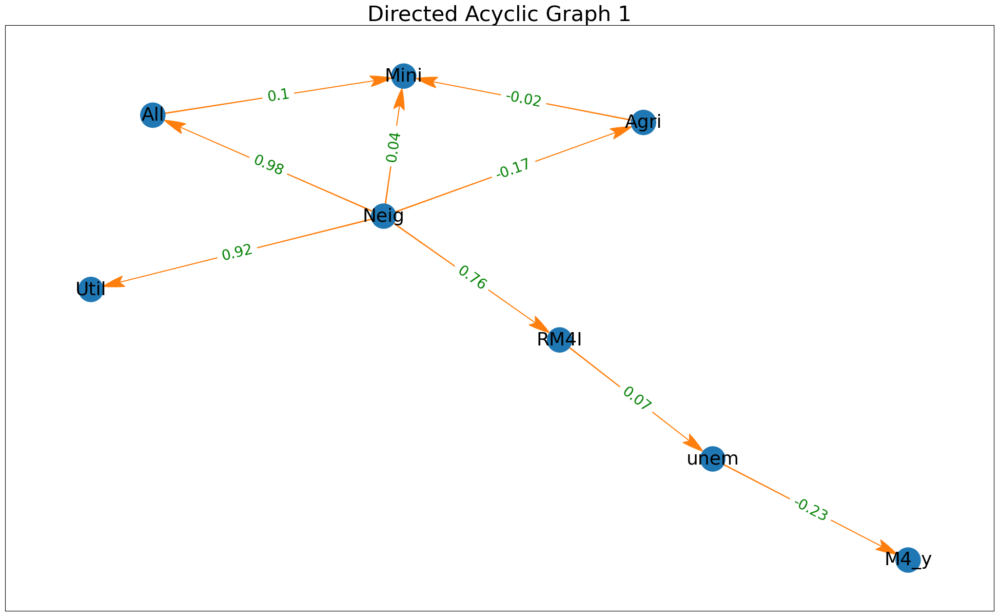

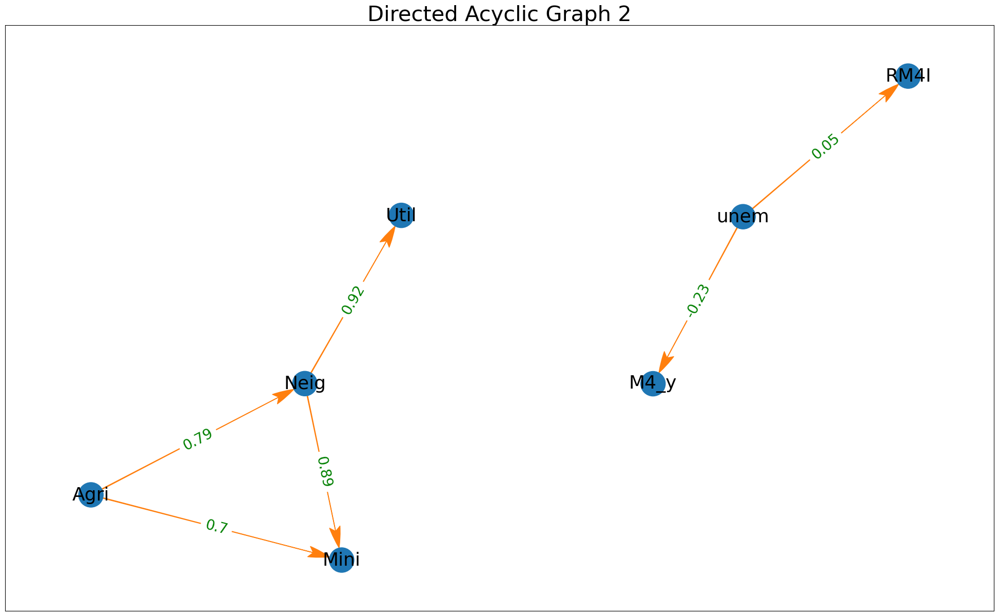

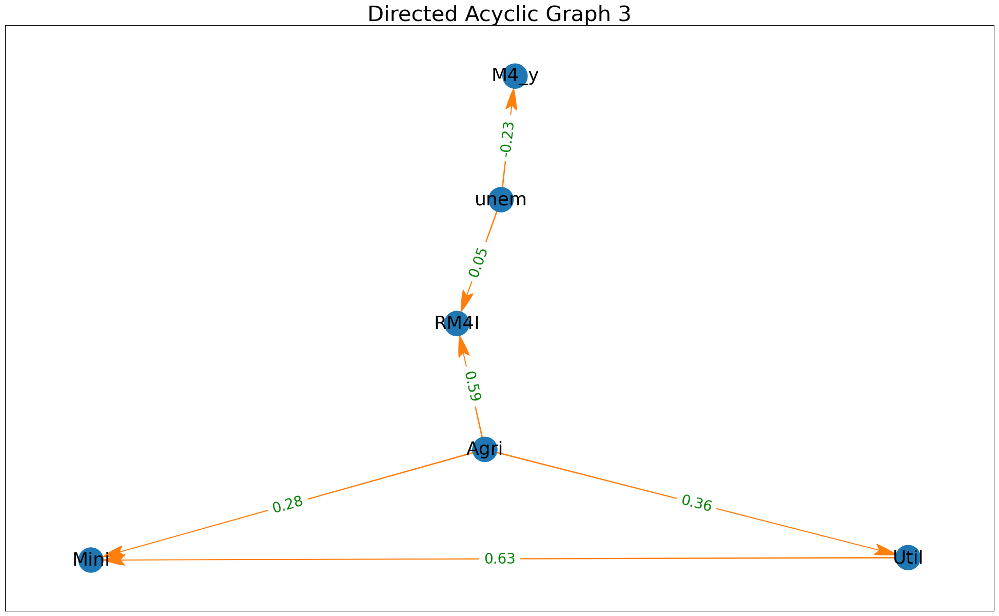

In [119]:
# Assuming 'plot_df1', 'plot_df2', and 'plot_df3' are your three dataframes

# Define a function to plot a DAG
def graph_DAG(edges, df, title=""):
    graph = nx.Graph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.keys() if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]] + keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]], 2))
    graph.add_edges_from(edges)
    color_map = ['C0' for _ in graph]

    fig, ax = plt.subplots(figsize=(20, 12))
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)

    plt.title(title, fontsize=30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                      arrows=True, font_color='k', font_size=26, alpha=1, width=1,
                      edge_color='C1',
                      arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax=ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)


# Initialize a PdfPages object to save the plots in a PDF
pp = PdfPages("DAGs.pdf")

# Plot DAGs for each dataframe
for i, plot_df in enumerate([plot_df1, plot_df2, plot_df3]):
    c = PC(plot_df)
    max_cond_vars = len(plot_df.keys()) - 2
    model = c.estimate(return_type='pdag', variant='parallel', significance_level=0.01,
                       max_cond_vars=max_cond_vars, ci_test='pearsonr')
    edges = model.edges

    # Plot the DAG
    graph_DAG(edges, plot_df, title=f'Directed Acyclic Graph {i+1}')
    
    # Save the plot to the PDF
    pp.savefig()

# Close the PdfPages object
pp.close()


In [120]:
plot_df1

Agri      Mini      Util       All      Neig  \
FIPS_y  TimePeriod                                                     
1001.0  2002        0.350600  0.148796  1.403818  0.603662  0.583256   
        2003        0.428792 -0.173619 -0.296673 -0.340656 -0.336618   
        2004        0.073549  0.321450  0.355912  0.000113 -0.093418   
        2005       -0.063374  0.006299 -0.472099 -0.211335 -0.189613   
        2006        0.220525  0.386258  0.480161  0.109818  0.069600   
...                      ...       ...       ...       ...       ...   
56045.0 2016       -2.556847 -2.366657 -2.541592 -2.517798 -2.402472   
        2017       -0.158892 -0.529382 -0.546459 -0.534827 -0.551123   
        2018        0.043579  0.071879 -0.069578 -0.087972 -0.131545   
        2019       -0.219858  0.506019  0.491954  0.319175  0.323632   
        2020       -0.122282  0.037851  0.276801  0.341425  0.309740   

                        M4_y      RM4I      unem  
FIPS_y  TimePeriod                                
1001.0  2002        0.055668  0.440898  4.807692  
        2003        0.048754 -0.431201  5.000000  
        2004        0.054306 -0.139933  4.715385  
        2005        0.056279 -0.229373  3.784615  
        2006        0.063506  0.076374  3.315385  
...                      ...       ...       ...  
56045.0 2016        0.043399 -9.458840  5.007692  
        2017        0.043091 -0.674959  4.084615  
        2018        0.052718 -0.135864  3.538462  
        2019        0.208378  0.258589  2.992308  
        2020        0.097720  0.311597  3.869231  

[27609 rows x 8 columns]

In [121]:
ai_data1 = pd.read_csv('kml3d_ai_data_all_vars.csv')

ai_data2 = pd.read_csv('kml3d_ai_data_no_gdp.csv')

ai_data3 = pd.read_csv('kml3d_ai_data_no_gdp_neig.csv')

In [204]:
ai_df_nom = pd.read_csv('nominal_kml3d.csv')

ai_df_diffnom = pd.read_csv('diff_nominal_kml3d.csv')

ai_df_real = pd.read_csv('real_kml3d.csv')

ai_df_diffreal = pd.read_csv('diff_real_kml3d.csv')

In [122]:
level_1 = ai_data1

level_2 = ai_data2

level_3 = ai_data3

In [205]:
level_11 = ai_df_nom

level_12 = ai_df_diffnom

level_21 = ai_df_real

level_22 = ai_df_diffreal

In [123]:
dfg_ai1 = plot_df1.copy()

dfg_ai2 = plot_df2.copy()

dfg_ai3 = plot_df3.copy()

In [206]:
dfg_ai11 = nominal.dropna()

dfg_ai12 = diff_nominal.dropna()

dfg_ai21 = real.dropna()

dfg_ai22 = diff_real.dropna()

In [124]:
ai_merge1 = pd.merge(dfg_ai1, level_1[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [125]:
ai_merge2 = pd.merge(dfg_ai2, level_2[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [126]:
ai_merge3 = pd.merge(dfg_ai3, level_3[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [207]:
ai_merge11 = pd.merge(dfg_ai11, level_11[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [208]:
ai_merge12 = pd.merge(dfg_ai12, level_12[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [209]:
ai_merge21 = pd.merge(dfg_ai21, level_21[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [210]:
ai_merge22 = pd.merge(dfg_ai22, level_22[['FIPS_y', 'clusters']], on='FIPS_y', how='left')

In [127]:
kml3d_ai_level1 = ai_merge1.dropna()

In [128]:
kml3d_ai_level2 = ai_merge2.dropna()

In [129]:
kml3d_ai_level3 = ai_merge3.dropna()

In [211]:
kml3d_ai_level11 = ai_merge11.dropna()

In [212]:
kml3d_ai_level12 = ai_merge12.dropna()

In [213]:
kml3d_ai_level21 = ai_merge21.dropna()

In [214]:
kml3d_ai_level22 = ai_merge22.dropna()

In [130]:
kml3d_ai_level1 = kml3d_ai_level1.set_index(['FIPS_y'])

In [131]:
kml3d_ai_level2 = kml3d_ai_level2.set_index(['FIPS_y'])

In [132]:
kml3d_ai_level3 = kml3d_ai_level3.set_index(['FIPS_y'])

In [215]:
kml3d_ai_level11 = kml3d_ai_level11.set_index(['FIPS_y'])

In [216]:
kml3d_ai_level12 = kml3d_ai_level12.set_index(['FIPS_y'])

In [217]:
kml3d_ai_level21 = kml3d_ai_level21.set_index(['FIPS_y'])

In [218]:
kml3d_ai_level22 = kml3d_ai_level22.set_index(['FIPS_y'])

In [133]:
cluster_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4}

In [134]:
kml3d_ai_level1['clusters'].replace(cluster_mapping, inplace=True)

In [135]:
kml3d_ai_level2['clusters'].replace(cluster_mapping, inplace=True)

In [136]:
kml3d_ai_level3['clusters'].replace(cluster_mapping, inplace=True)

In [219]:
kml3d_ai_level11['clusters'].replace(cluster_mapping, inplace=True)

In [220]:
kml3d_ai_level12['clusters'].replace(cluster_mapping, inplace=True)

In [221]:
kml3d_ai_level21['clusters'].replace(cluster_mapping, inplace=True)

In [222]:
kml3d_ai_level22['clusters'].replace(cluster_mapping, inplace=True)

In [226]:
kml3d_ai_level22

,Agri,Mini,Util,RM4_,RM4I,unem,clusters
FIPS_y,,,,,,,
1001.0,0.078192,-0.322415,-1.700491,-0.939906,-0.431201,5.000000,1
1001.0,-0.355243,0.495069,0.652586,0.221168,-0.139933,4.715385,1
1001.0,-0.136923,-0.315151,-0.828012,-0.081404,-0.229373,3.784615,1
1001.0,0.283899,0.379960,0.952260,0.283377,0.076374,3.315385,1
1001.0,-0.440884,-0.166553,-0.215945,0.086412,0.125438,3.376923,1
...,...,...,...,...,...,...,...
56045.0,-4.845869,-5.193926,-5.253729,-4.942918,-9.458840,5.007692,3
56045.0,2.397955,1.837275,1.995132,1.827574,-0.674959,4.084615,3
56045.0,0.202471,0.601261,0.476881,0.394699,-0.135864,3.538462,3


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

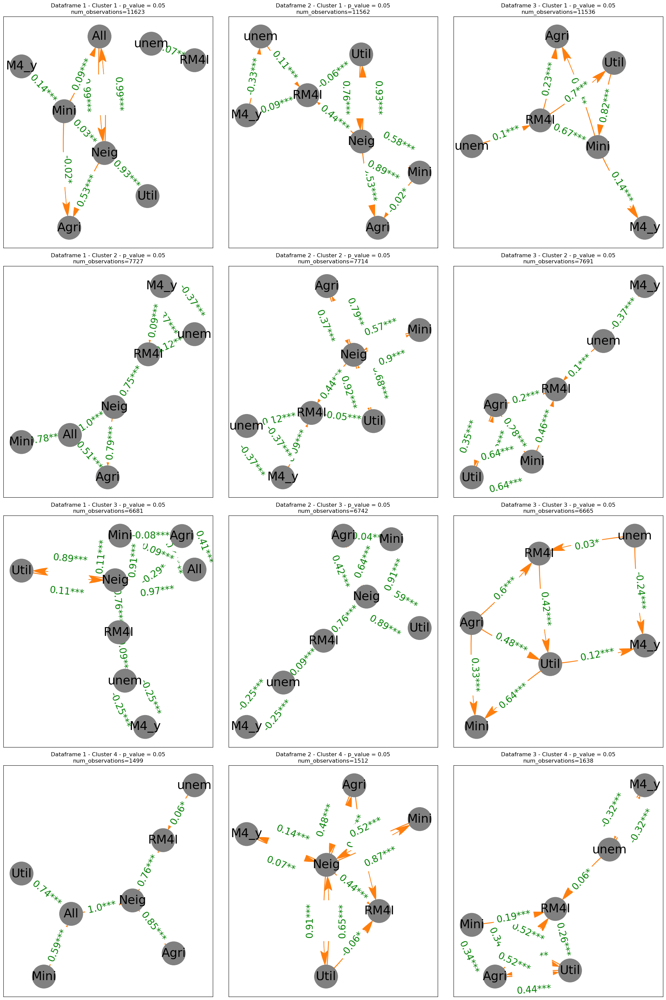

In [138]:
dataframes = [kml3d_ai_level1, kml3d_ai_level2, kml3d_ai_level3]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05]  # Updated to a single list of p-values

# Define names for the output files based on dataframes
output_names = ['clusters_b1', 'clusters_b2', 'clusters_b3']

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", algorithm="parallel", ax=None, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 12))

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph)

    edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u, v]}\n\n\n{edge_labels[(v, u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u, v)]}'))
    edge_labels = dict(edge_labels2)

    nx.draw_networkx(graph, pos, node_color=color_map, node_size=2500,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
                     arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=20,
                                 ax=ax)

    # Add title to the DAG
    ax.set_title(title)

#     # Save to PDF if a PdfPages object is provided
#     if pp:
#         pp.savefig(ax.figure, bbox_inches='tight')

# Specify the absolute path for the output PDF file
pdf_file_path = f"DAGOutputs_{output_names[idx]}.pdf"
pp = PdfPages(pdf_file_path)

# Create a 4x2 grid for the subplots
fig, axes = plt.subplots(4, 3, figsize=(20, 30))

# Different PC algorithms to test
algorithms = ["orig"]

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different PC algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
                      , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)

# Save the figure to the PDF
pp.savefig(fig, bbox_inches='tight')

pp.close()
plt.show()


In [139]:
edges_dct = {}
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    edges_dct[idx] = {}
    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different data for PC algorithm
#         for algorithm in algorithms:
        algorithm = "orig"
        c = PC(cluster_df)
        model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
        edges = model.edges
        edges = list(set([tuple(sorted(edge)) for edge in edges]))
        edges_dct[idx][cluster_idx] = edges
#             # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
#             graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
#                       , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)
edges_dct

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

{0: {0: [('All', 'Mini'),
   ('Agri', 'Neig'),
   ('Neig', 'Util'),
   ('Agri', 'Mini'),
   ('Mini', 'Neig'),
   ('All', 'Neig'),
   ('RM4I', 'unem'),
   ('M4_y', 'Mini')],
  1: [('All', 'Mini'),
   ('Agri', 'Neig'),
   ('Neig', 'RM4I'),
   ('Agri', 'All'),
   ('All', 'Neig'),
   ('RM4I', 'unem'),
   ('M4_y', 'RM4I'),
   ('M4_y', 'unem')],
  2: [('All', 'Mini'),
   ('Agri', 'Neig'),
   ('Neig', 'RM4I'),
   ('Neig', 'Util'),
   ('Agri', 'All'),
   ('Agri', 'Mini'),
   ('Mini', 'Neig'),
   ('All', 'Neig'),
   ('RM4I', 'unem'),
   ('M4_y', 'unem')],
  3: [('All', 'Mini'),
   ('Agri', 'Neig'),
   ('Neig', 'RM4I'),
   ('All', 'Neig'),
   ('All', 'Util'),
   ('RM4I', 'unem')]},
 1: {0: [('Agri', 'Neig'),
   ('Neig', 'RM4I'),
   ('Neig', 'Util'),
   ('RM4I', 'Util'),
   ('Agri', 'Mini'),
   ('Mini', 'Neig'),
   ('RM4I', 'unem'),
   ('M4_y', 'RM4I'),
   ('M4_y', 'unem')],
  1: [('Agri', 'Neig'),
   ('Neig', 'RM4I'),
   ('Neig', 'Util'),
   ('RM4I', 'Util'),
   ('Mini', 'Neig'),
   ('RM4I', 'un

In [140]:
cols = list(edges_dct.keys())
rows = list(edges_dct[0].keys())

col_shared_edges = {}
row_shared_edges = {}
for col in cols:
    for row, edges in edges_dct[col].items():
        if row == 0: col_shared_edges[col] = copy.copy(edges)
        col_shared_edges[col]  = [edge for edge in edges if edge in col_shared_edges[col] ]
        
col_shared_edges

{0: [('All', 'Mini'), ('Agri', 'Neig'), ('All', 'Neig'), ('RM4I', 'unem')],
 1: [('Agri', 'Neig'), ('Neig', 'RM4I'), ('Neig', 'Util'), ('Mini', 'Neig')],
 2: [('Agri', 'RM4I'), ('Agri', 'Mini'), ('RM4I', 'unem'), ('Mini', 'Util')]}

In [141]:
for row in rows:
    row_shared_edges[row] = {}
    for col in cols:
        if col == 0: row_shared_edges[row] = edges_dct[col][row]
        row_shared_edges[row] = [edge for edge in edges if edge in row_shared_edges[row]]
row_shared_edges

{0: [('Agri', 'Mini'), ('RM4I', 'unem')],
 1: [('RM4I', 'unem'), ('M4_y', 'unem')],
 2: [('Agri', 'Mini'), ('RM4I', 'unem'), ('M4_y', 'unem')],
 3: [('RM4I', 'unem')]}

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/networkx/drawing/nx_pylab.py:304: UserWarning: 

The connectionstyle keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default value for connectionstyle.
Note that using FancyArrowPatches may be slow for large graphs.

  draw_networkx_edges(G, pos, arrows=arrows, **edge_kwds)


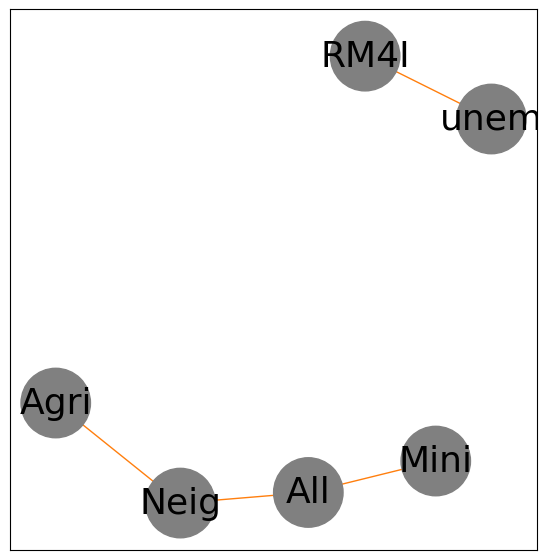

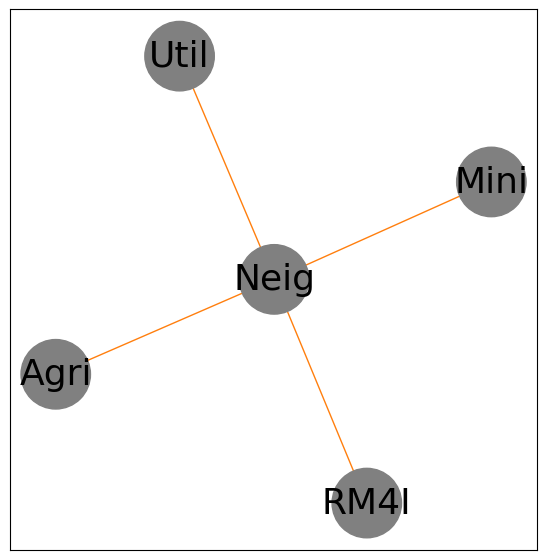

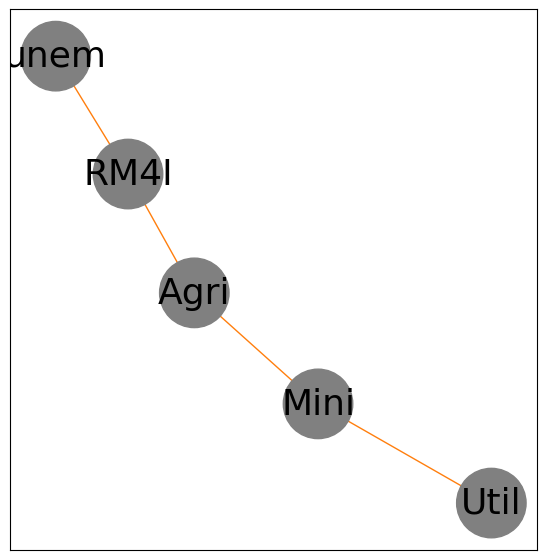

In [142]:

for key, lst in col_shared_edges.items():
    fig,ax = plt.subplots(figsize = (6, 6))
    G = nx.from_edgelist(lst)
    G.nodes()
    color_map = ["grey" for g in G]
    plt.tight_layout()
    pos = graphviz_layout(G)
    nx.draw_networkx(G, pos, node_color=color_map, node_size=2500,
#                      with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
#                      arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
plt.show()

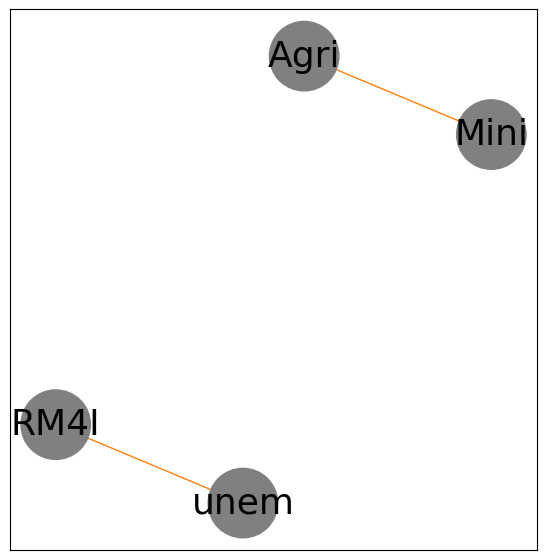

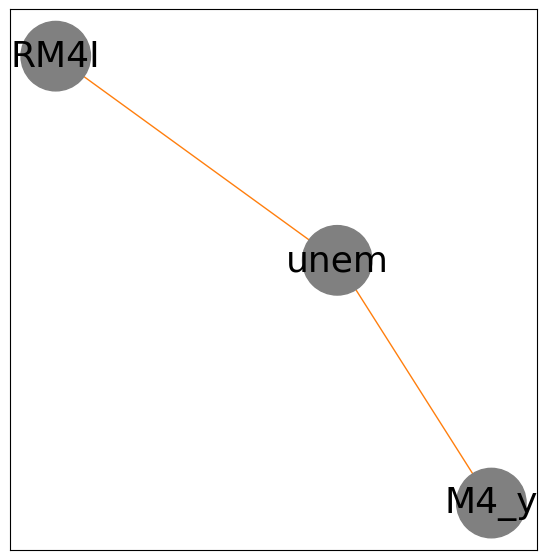

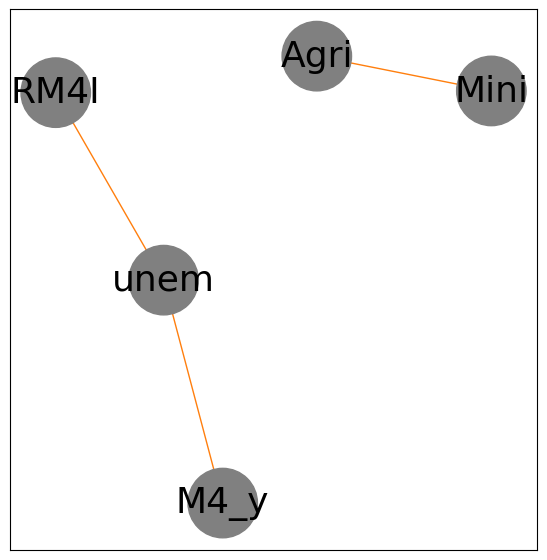

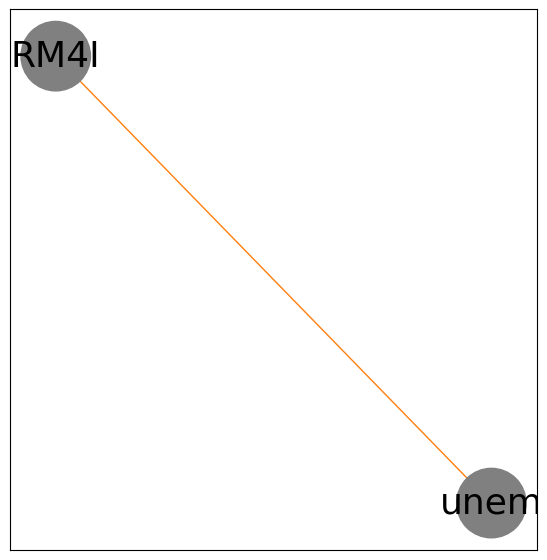

In [143]:
for key, lst in row_shared_edges.items():
    fig,ax = plt.subplots(figsize = (6, 6))
    G = nx.from_edgelist(lst)
    G.nodes()
    color_map = ["grey" for g in G]
    plt.tight_layout()
    pos = graphviz_layout(G)
    nx.draw_networkx(G, pos, node_color=color_map, node_size=2500,
#                      with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
#                      arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
plt.show()

In [200]:
plot_df1 = nominal.dropna()
plot_df2 = diff_nominal.dropna()
plot_df3 = real.dropna()
plot_df4 = diff_real.dropna()

In [202]:
# Assuming 'plot_df1', 'plot_df2', and 'plot_df3' are your three dataframes

# Define a function to plot a DAG
def graph_DAG(edges, df, title=""):
    graph = nx.Graph()
    edge_labels = {}
    for edge in edges:
        controls = [key for key in df.keys() if key not in edge]
        controls = list(set(controls))
        keep_controls = []
        for control in controls:
            control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
            if (control, edge[1]) in control_edges:
                print('keep control:', control)
                keep_controls.append(control)
        print(edge, keep_controls)
        pcorr = df[[edge[0], edge[1]] + keep_controls].pcorr()
        edge_labels[edge] = str(round(pcorr[edge[0]].loc[edge[1]], 2))
    graph.add_edges_from(edges)
    color_map = ['C0' for _ in graph]

    fig, ax = plt.subplots(figsize=(20, 12))
    plt.tight_layout()
    pos = graphviz_layout(graph, "neato", None)

    plt.title(title, fontsize=30)
    nx.draw_networkx(graph, pos, node_color=color_map, node_size=1200, with_labels=True,
                      arrows=True, font_color='k', font_size=26, alpha=1, width=1,
                      edge_color='C1',
                      arrowstyle=ArrowStyle('Fancy, head_length=3, head_width=1.5, tail_width=.1'), ax=ax)
    nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, font_color='green', font_size=20)


  0%|          | 0/4 [00:00<?, ?it/s]

keep control: M4 I
('Util', 'M4_y') ['M4 I']
keep control: Mini
keep control: M4_y
('Util', 'unem') ['Mini', 'M4_y']
keep control: Util
keep control: Mini
('M4_y', 'unem') ['Util', 'Mini']
('M4 I', 'Mini') []
keep control: Util
('M4 I', 'M4_y') ['Util']
keep control: Util
keep control: M4_y
('Mini', 'unem') ['Util', 'M4_y']
('unem', 'M4 I') []


  0%|          | 0/4 [00:00<?, ?it/s]

keep control: unem
keep control: M4 I
keep control: Mini
keep control: Agri
('Util', 'M4_y') ['unem', 'M4 I', 'Mini', 'Agri']
keep control: Util
keep control: M4 I
keep control: unem
keep control: Agri
('Mini', 'M4_y') ['Util', 'M4 I', 'unem', 'Agri']
keep control: unem
keep control: Agri
('Mini', 'M4 I') ['unem', 'Agri']
keep control: Mini
keep control: unem
('Agri', 'M4 I') ['Mini', 'unem']
keep control: Util
keep control: M4 I
keep control: Mini
keep control: unem
('Agri', 'M4_y') ['Util', 'M4 I', 'Mini', 'unem']
keep control: Util
keep control: Mini
keep control: unem
keep control: Agri
('M4 I', 'M4_y') ['Util', 'Mini', 'unem', 'Agri']
keep control: Mini
keep control: Agri
('unem', 'M4 I') ['Mini', 'Agri']
keep control: Util
keep control: M4 I
keep control: Mini
keep control: Agri
('unem', 'M4_y') ['Util', 'M4 I', 'Mini', 'Agri']


  0%|          | 0/4 [00:00<?, ?it/s]

keep control: Util
keep control: RM4_
('unem', 'RM4I') ['Util', 'RM4_']
keep control: unem
keep control: RM4_
('Util', 'RM4I') ['unem', 'RM4_']
keep control: Mini
keep control: Agri
('Util', 'RM4_') ['Mini', 'Agri']
keep control: Util
keep control: unem
('RM4_', 'RM4I') ['Util', 'unem']
('RM4_', 'Mini') []
('RM4_', 'Util') []
('RM4_', 'Agri') []
keep control: Util
keep control: Mini
('Agri', 'RM4_') ['Util', 'Mini']
keep control: Util
keep control: Agri
('Mini', 'RM4_') ['Util', 'Agri']


  0%|          | 0/4 [00:00<?, ?it/s]

keep control: RM4_
('unem', 'RM4I') ['RM4_']
keep control: unem
('RM4_', 'RM4I') ['unem']
('RM4_', 'Agri') []
('RM4_', 'Util') []
('RM4_', 'Mini') []
keep control: Util
keep control: Mini
('Agri', 'RM4_') ['Util', 'Mini']
keep control: Mini
keep control: Agri
('Util', 'RM4_') ['Mini', 'Agri']
keep control: Util
keep control: Agri
('Mini', 'RM4_') ['Util', 'Agri']


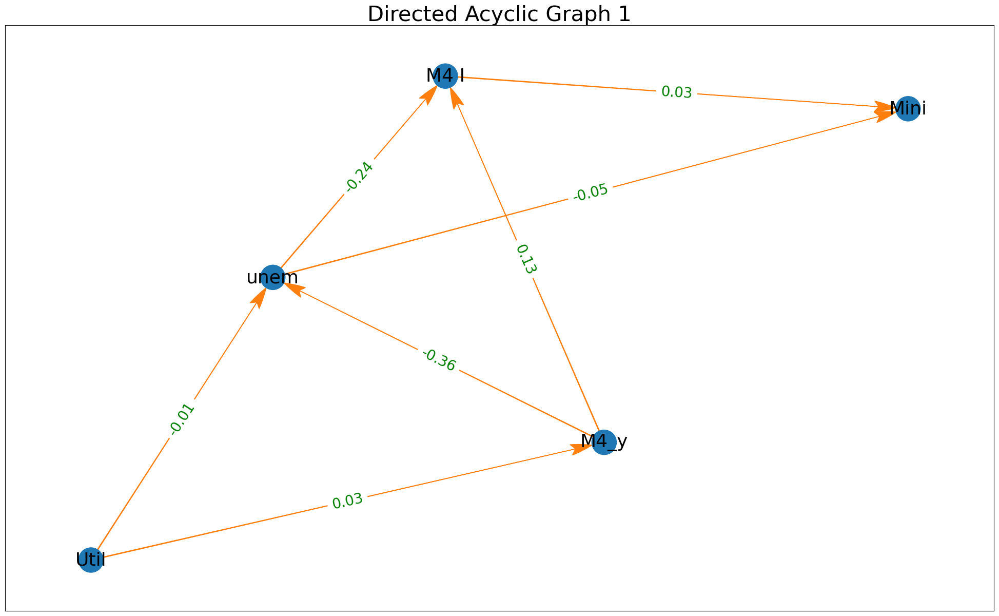

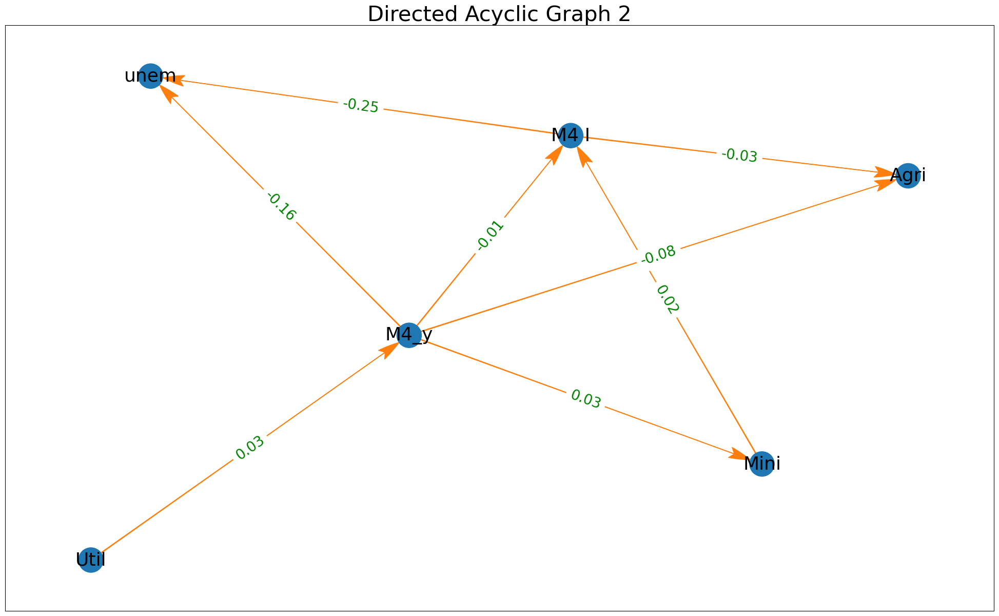

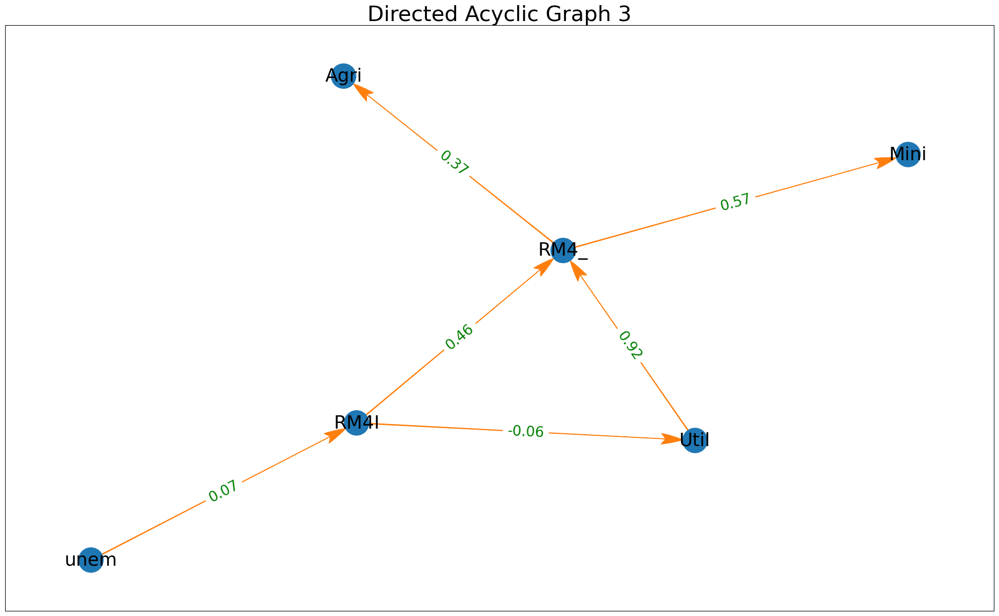

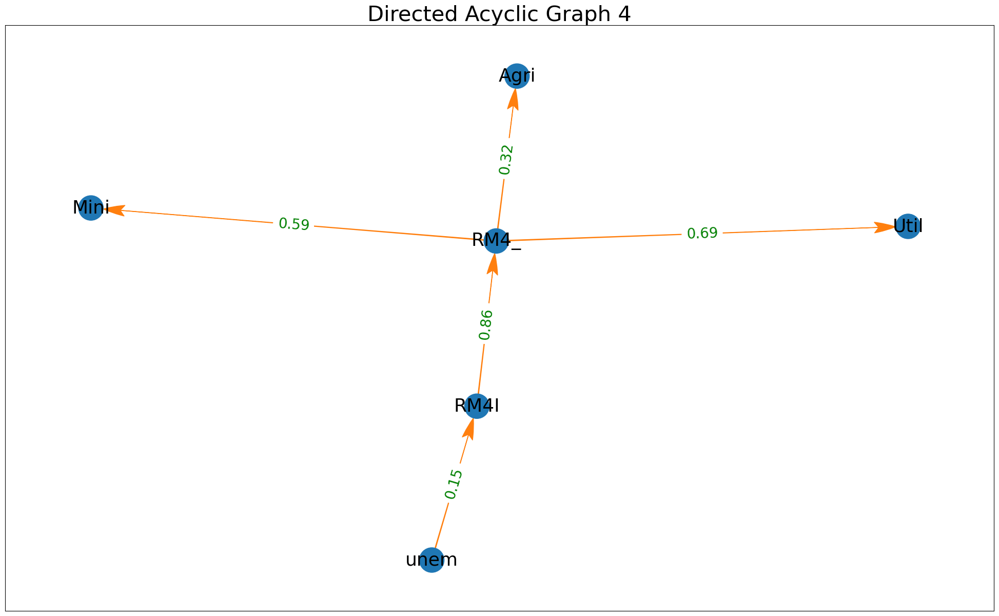

In [203]:
# Initialize a PdfPages object to save the plots in a PDF
pp = PdfPages("DAGs_nominal vs real.pdf")

# Plot DAGs for each dataframe
for i, plot_df in enumerate([plot_df1, plot_df2, plot_df3, plot_df4]):
    c = PC(plot_df)
    max_cond_vars = len(plot_df.keys()) - 2
    model = c.estimate(return_type='pdag', variant='parallel', significance_level=0.01,
                       max_cond_vars=max_cond_vars, ci_test='pearsonr')
    edges = model.edges

    # Plot the DAG
    graph_DAG(edges, plot_df, title=f'Directed Acyclic Graph {i+1}')
    
    # Save the plot to the PDF
    pp.savefig()

# Close the PdfPages object
pp.close()


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

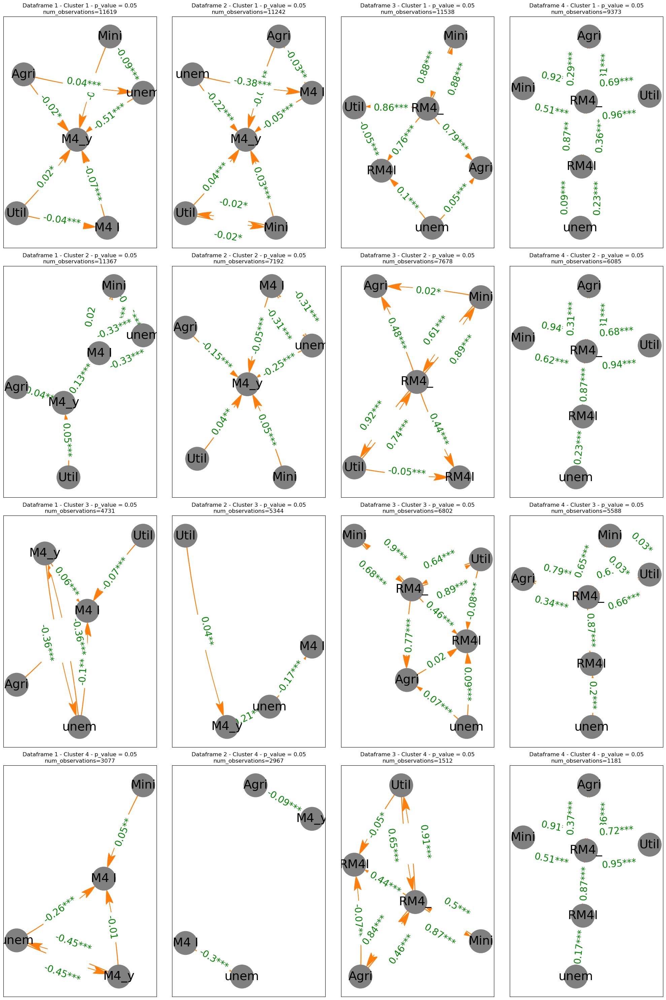

In [232]:
# List of dataframes
dataframes = [kml3d_ai_level11, kml3d_ai_level12, kml3d_ai_level21, kml3d_ai_level22]

# List of p-values for each dataframe
p_values_list = [0.1, 0.05, 0.01, 0.001]  # Updated to include p-values for each dataframe

# Define names for the output files based on dataframes
output_names = [f'clusters_b{i+1}' for i in range(len(dataframes))]

def create_cluster_dags(df):
    grouped = df.groupby('clusters')

    # Initialize an empty dictionary to store the DataFrames for each cluster
    cluster_dataframes = {}

    # Iterate over the groups and create DataFrames for each cluster
    for cluster, group in grouped:
        cluster_dataframes[cluster] = group.drop(['clusters'], axis=1)

    # List of DataFrames for each cluster
    cluster_dataframes_list = [cluster_dataframes[i] for i in range(1, 5)]  # Assuming four clusters

    return cluster_dataframes_list

def determine_p_value(n):
    # If the number of observations is 800 and above, use a p-value of 0.05, otherwise use 0.10
    return 0.05 if n >= 800 else 0.1

def graph_DAG(edges, df, title="", algorithm="parallel", ax=None, sig_vals=[0.05, 0.01, 0.001], pp=None):
    graph = nx.DiGraph()

    def build_edge_labels(edges, df, sig_vals):
        edge_labels = {}
        for edge in edges:
            controls = [key for key in df.keys() if key not in edge]
            controls = list(set(controls))
            keep_controls = []
            for control in controls:
                control_edges = [ctrl_edge for ctrl_edge in edges if control == ctrl_edge[0]]
                if (control, edge[1]) in control_edges:
                    keep_controls.append(control)

            pcorr = df.partial_corr(x=edge[0], y=edge[1], covar=keep_controls, method="pearson")
            label = str(round(pcorr["r"][0], 2))
            pvalue = pcorr["p-val"][0]

            for sig_val in sig_vals:
                if pvalue < sig_val:
                    label = label + "*"

            edge_labels[edge] = label
        return edge_labels

    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 12))

    graph.add_edges_from(edges)
    color_map = ["grey" for g in graph]

    graph.nodes()
    plt.tight_layout()
    pos = graphviz_layout(graph)

    edge_labels = build_edge_labels(edges, df, sig_vals=sig_vals)

    edge_labels2 = []
    for u, v, d in graph.edges(data=True):
        if pos[u][0] > pos[v][0]:
            if (v, u) in edge_labels.keys():
                edge_labels2.append(((u, v,), f'{edge_labels[u, v]}\n\n\n{edge_labels[(v, u)]}'))
        if (v, u) not in edge_labels.keys():
            edge_labels2.append(((u, v,), f'{edge_labels[(u, v)]}'))
    edge_labels = dict(edge_labels2)

    nx.draw_networkx(graph, pos, node_color=color_map, node_size=2500,
                     with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
                     arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
    nx.draw_networkx_edge_labels(graph,
                                 pos=pos,
                                 edge_labels=edge_labels,
                                 font_color='green',
                                 font_size=20,
                                 ax=ax)

    # Add title to the DAG
    ax.set_title(title)

    # Save to PDF if a PdfPages object is provided
    if pp:
        pp.savefig(ax.figure, bbox_inches='tight')

# Specify the absolute path for the output PDF file
pdf_file_path = f"DAGOutputs_{len(dataframes)}_dataframes.pdf"
pp = PdfPages(pdf_file_path)

# Create a grid for the subplots
fig, axes = plt.subplots(4, len(dataframes), figsize=(5*len(dataframes), 30))

# Different PC algorithms to test
algorithms = ["orig"]

# Iterate over each dataframe
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)

    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different PC algorithms
        for algorithm in algorithms:
            c = PC(cluster_df)
            model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
            edges = model.edges

            # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
            graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
                      , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)

# Save the figure to the PDF
pp.savefig(fig, bbox_inches='tight')

pp.close()
plt.show()


In [233]:
edges_dct = {}
for idx, dataframe in enumerate(dataframes):
    # Get clustered dataframes for the current dataframe
    clustered_dfs = create_cluster_dags(dataframe)
    edges_dct[idx] = {}
    # Iterate over clustered dataframes and determine p-values dynamically
    for cluster_idx, cluster_df in enumerate(clustered_dfs):
        n = cluster_df.shape[0]  # Number of observations for the current cluster
        p_value = determine_p_value(n)

        # Iterate over different data for PC algorithm
#         for algorithm in algorithms:
        algorithm = "orig"
        c = PC(cluster_df)
        model = c.estimate(return_type='pdag', variant=algorithm, significance_level=p_value, ci_test='pearsonr')
        edges = model.edges
        edges = list(set([tuple(sorted(edge)) for edge in edges]))
        edges_dct[idx][cluster_idx] = edges
#             # Create DAG for the current cluster, p-value, and algorithm using the modified graph_DAG function
#             graph_DAG(edges, cluster_df, title=f'Dataframe {idx + 1} - Cluster {cluster_idx + 1} - p_value = {p_value}\nnum_observations={n}'
#                       , algorithm=algorithm, ax=axes[cluster_idx, idx], pp=pp)
edges_dct

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

{0: {0: [('M4 I', 'Util'),
   ('M4_y', 'Util'),
   ('M4 I', 'M4_y'),
   ('M4_y', 'Mini'),
   ('Agri', 'unem'),
   ('Agri', 'M4_y'),
   ('M4_y', 'unem'),
   ('Mini', 'unem')],
  1: [('M4 I', 'Mini'),
   ('M4_y', 'Util'),
   ('M4 I', 'unem'),
   ('M4 I', 'M4_y'),
   ('Agri', 'M4_y'),
   ('Mini', 'unem')],
  2: [('M4 I', 'Util'),
   ('Agri', 'M4 I'),
   ('M4 I', 'unem'),
   ('M4 I', 'M4_y'),
   ('M4_y', 'unem')],
  3: [('M4 I', 'unem'), ('M4 I', 'Mini'), ('M4_y', 'unem'), ('M4 I', 'M4_y')]},
 1: {0: [('Agri', 'M4 I'),
   ('M4_y', 'Util'),
   ('M4 I', 'unem'),
   ('M4 I', 'M4_y'),
   ('Mini', 'Util'),
   ('M4_y', 'Mini'),
   ('Agri', 'M4_y'),
   ('M4_y', 'unem')],
  1: [('M4_y', 'Util'),
   ('M4 I', 'unem'),
   ('M4 I', 'M4_y'),
   ('M4_y', 'Mini'),
   ('Agri', 'M4_y'),
   ('M4_y', 'unem')],
  2: [('M4 I', 'unem'), ('M4_y', 'unem'), ('M4_y', 'Util')],
  3: [('M4 I', 'unem'), ('Agri', 'M4_y')]},
 2: {0: [('RM4I', 'RM4_'),
   ('Agri', 'RM4_'),
   ('RM4I', 'Util'),
   ('Mini', 'RM4_'),
   ('R

In [234]:
cols = list(edges_dct.keys())
rows = list(edges_dct[0].keys())

col_shared_edges = {}
row_shared_edges = {}
for col in cols:
    for row, edges in edges_dct[col].items():
        if row == 0: col_shared_edges[col] = copy.copy(edges)
        col_shared_edges[col]  = [edge for edge in edges if edge in col_shared_edges[col] ]
        
col_shared_edges

{0: [('M4 I', 'M4_y')],
 1: [('M4 I', 'unem')],
 2: [('RM4I', 'RM4_'),
  ('Agri', 'RM4_'),
  ('RM4I', 'Util'),
  ('Mini', 'RM4_'),
  ('RM4_', 'Util')],
 3: [('RM4I', 'RM4_'),
  ('Agri', 'RM4_'),
  ('Mini', 'RM4_'),
  ('RM4I', 'unem'),
  ('RM4_', 'Util')]}

In [236]:
for row in rows:
    row_shared_edges[row] = {}
    for col in cols:
        if col == 0: row_shared_edges[row] = edges_dct[col][row]
        row_shared_edges[row] = [edge for edge in edges if edge in row_shared_edges[row]]
row_shared_edges

{0: [], 1: [], 2: [], 3: []}

/Users/abiodun.idowu/anaconda3/lib/python3.11/site-packages/networkx/drawing/nx_pylab.py:304: UserWarning: 

The connectionstyle keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default value for connectionstyle.
Note that using FancyArrowPatches may be slow for large graphs.

  draw_networkx_edges(G, pos, arrows=arrows, **edge_kwds)


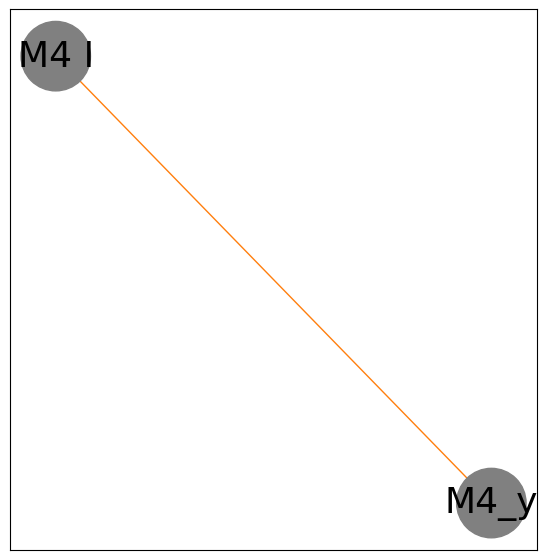

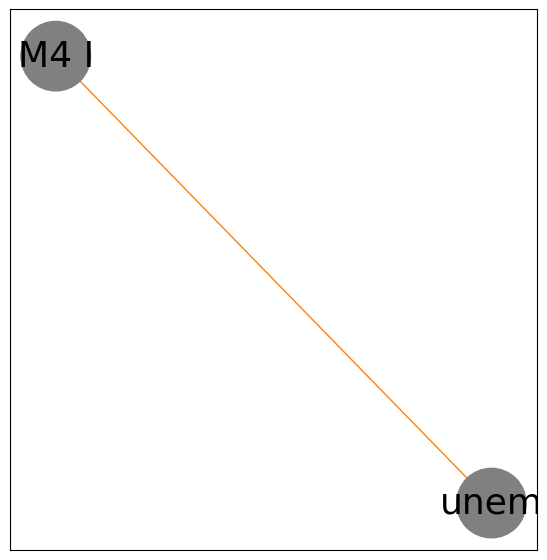

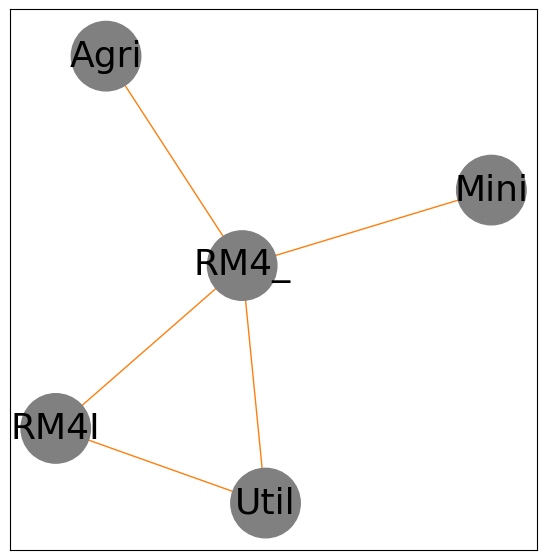

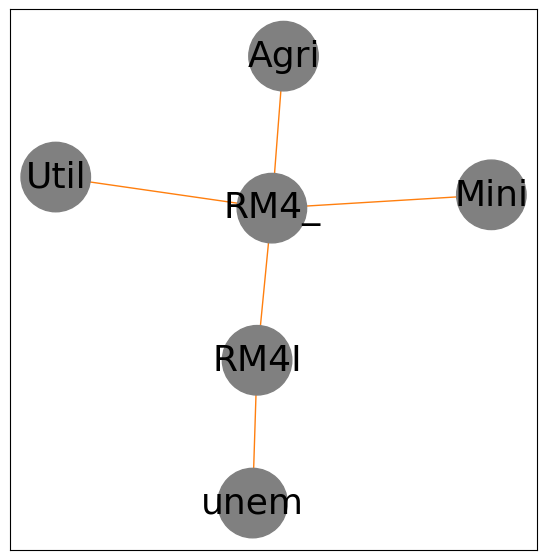

In [237]:

for key, lst in col_shared_edges.items():
    fig,ax = plt.subplots(figsize = (6, 6))
    G = nx.from_edgelist(lst)
    G.nodes()
    color_map = ["grey" for g in G]
    plt.tight_layout()
    pos = graphviz_layout(G)
    nx.draw_networkx(G, pos, node_color=color_map, node_size=2500,
#                      with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
#                      arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
plt.show()

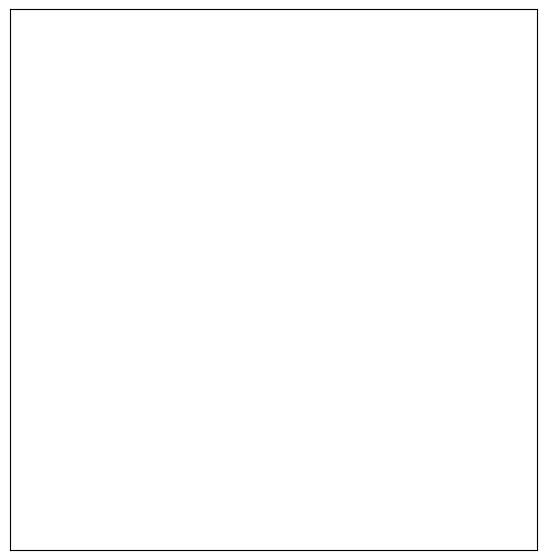

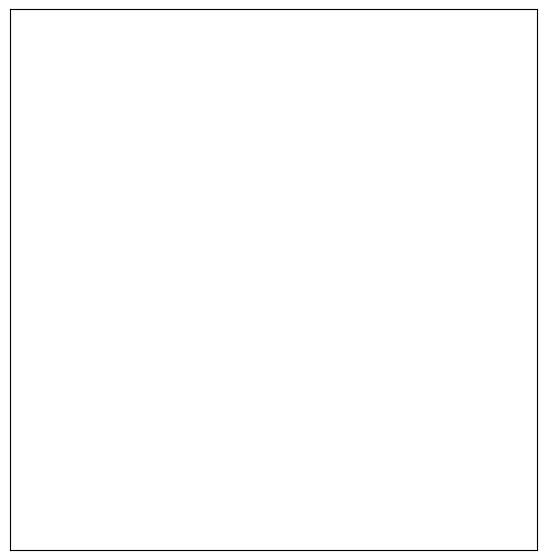

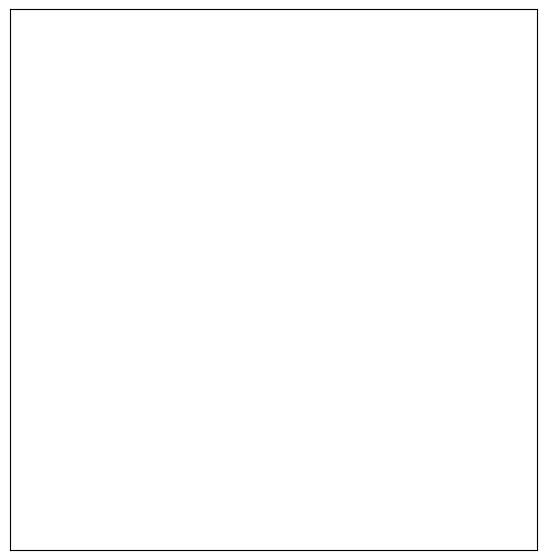

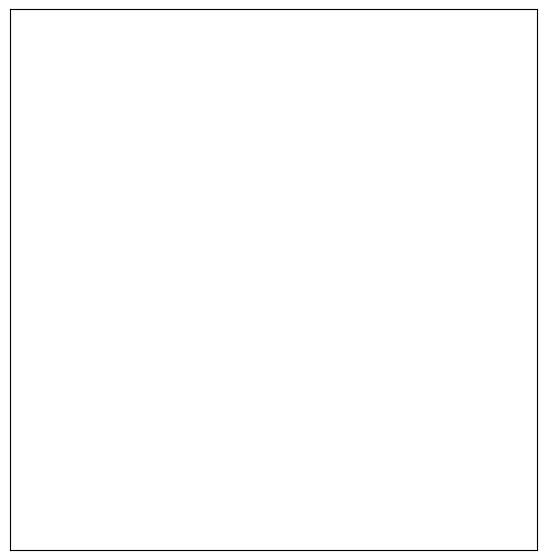

In [238]:
for key, lst in row_shared_edges.items():
    fig,ax = plt.subplots(figsize = (6, 6))
    G = nx.from_edgelist(lst)
    G.nodes()
    color_map = ["grey" for g in G]
    plt.tight_layout()
    pos = graphviz_layout(G)
    nx.draw_networkx(G, pos, node_color=color_map, node_size=2500,
#                      with_labels=True, arrows=True,
                     font_color="black",
                     font_size=26, alpha=1,
                     width=1, edge_color="C1",
#                      arrowstyle="Fancy, head_length=3, head_width=1.5, tail_width=.1",
                     connectionstyle='arc3, rad = 0.05',
                     ax=ax)
plt.show()